# Initialization

In [ ]:
from google.colab import auth
import google.colab
auth.authenticate_user()
print('Authenticated')

Authenticated


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 13.8 MB/s 
     |████████████████████████████████| 6.3 MB 72.9 MB/s 
     |████████████████████████████████| 16.7 MB 55.0 MB/s 


In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import geopandas as gpd
import seaborn as sns
import requests
import re

In [ ]:
!pip install rtree
!pip install pygeos

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 13.0 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.1 MB 8.5 MB/s 


In [ ]:
import rtree
import pygeos

In [ ]:
!pip install pysal
!pip install pandana

In [ ]:
from pysal.lib import weights
from pysal.explore import esda
from pysal.model import spreg

In [ ]:
%%bigquery --project urban-forest-269703 ca_grid
SELECT *
FROM `urban-forest-269703.grid.ca-grid-hexagons`

In [ ]:
from shapely import wkt
ca_grid['geom'] = ca_grid['geometry'].apply(wkt.loads)
ca_gdf = gpd.GeoDataFrame(ca_grid.iloc[:,[0,4]], geometry='geom')
ca_gdf

,ID,geom
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4..."
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4..."
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4..."
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4..."
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3..."
...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7..."
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6..."
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6..."
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7..."


# Creating Hexagon Grid

In [ ]:
states_gdf = gpd.read_file('/content/cb_2018_us_state_500k.shp')
ca_state = states_gdf[states_gdf['NAME']=='California']

In [ ]:
from fiona.crs import from_epsg

regions = states_gdf[states_gdf['NAME'] == 'California'].geometry.explode().tolist()
regions

def geom_to_gdf(g, label):
    gdf = gpd.GeoDataFrame()
    gdf.crs = from_epsg(4326)
    gdf.loc[0, 'geometry'] = g
    gdf.loc[0, 'Location'] = label
    return gdf
    
max_region = max(regions, key=lambda a: a.area)
ca_gdf = geom_to_gdf(max_region, 'California')
ca_gdf

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: Assigning CRS to a GeoDataFrame without a geometry column is now deprecated and will not be supported in the future.
  
/usr/local/lib/python3.7/dist-packages/pyproj/crs/crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,geometry,Location
0,"POLYGON ((-124.40860 40.44320, -124.39664 40.4...",California


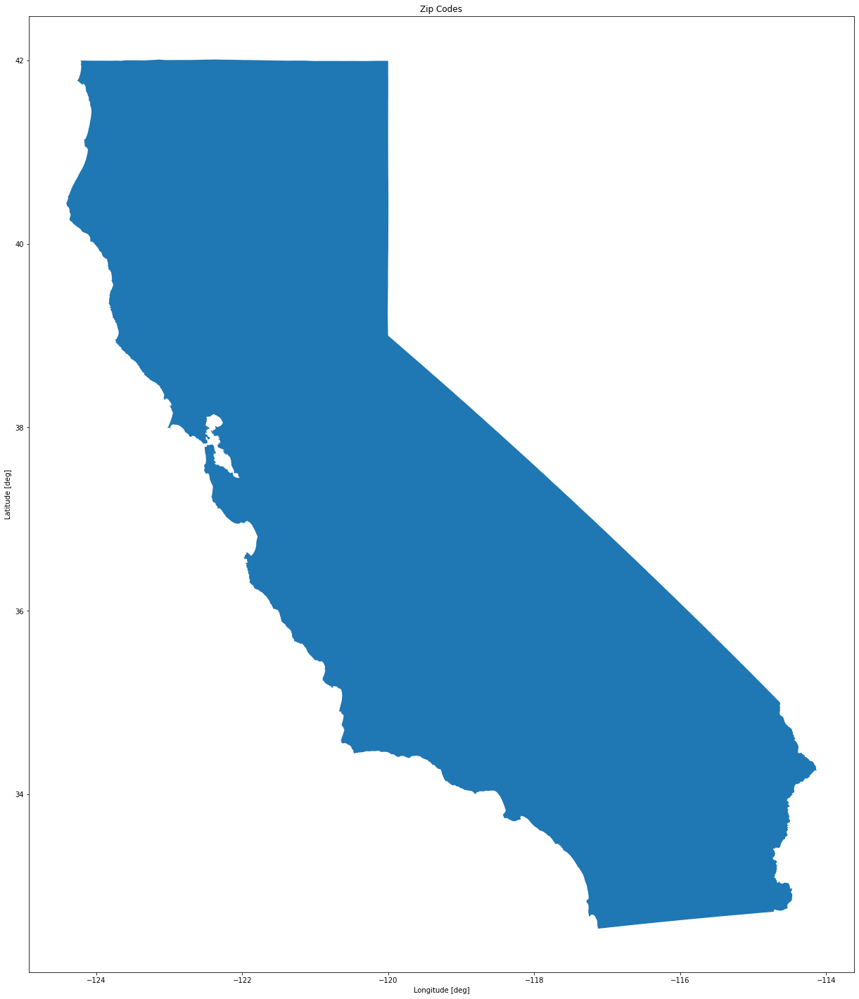

In [ ]:
fig,ax = plt.subplots(figsize=(25,25))
ca_gdf.plot(ax=ax)
ax.set_title('Zip Codes')
ax.set_xlabel('Longitude [deg]')
ax.set_ylabel('Latitude [deg]')
fig.show()

In [ ]:
import math
from shapely.geometry import Polygon
def create_hexgrid(x_min, y_min, x_max, y_max, side):
    """
    returns an array of Points describing hexagons centers that are inside the given bounding_box
    :param bbox: The containing bounding box. The bbox coordinate should be in Webmercator.
    :param side: The size of the hexagons'
    :return: The hexagon grid
    """
    grid = []

    v_step = math.sqrt(3) * side
    h_step = 1.5 * side

    h_skip = math.ceil(x_min / h_step) - 1
    h_start = h_skip * h_step

    v_skip = math.ceil(y_min / v_step) - 1
    v_start = v_skip * v_step

    h_end = x_max + h_step
    v_end = y_max + v_step

    if v_start - (v_step / 2.0) < y_min:
        v_start_array = [v_start + (v_step / 2.0), v_start]
    else:
        v_start_array = [v_start - (v_step / 2.0), v_start]

    v_start_idx = int(abs(h_skip) % 2)

    c_x = h_start
    c_y = v_start_array[v_start_idx]
    v_start_idx = (v_start_idx + 1) % 2
    while c_x < h_end:
        while c_y < v_end:
            grid.append((c_x, c_y))
            c_y += v_step
        c_x += h_step
        c_y = v_start_array[v_start_idx]
        v_start_idx = (v_start_idx + 1) % 2

    return grid

xmin, ymin, xmax, ymax = ca_gdf.total_bounds
hexagon_centers = create_hexgrid(xmin, ymin, xmax, ymax, 0.08)

In [ ]:
def create_hexagon(l, x, y):
    """
    Create a hexagon centered on (x, y)
    :param l: length of the hexagon's edge
    :param x: x-coordinate of the hexagon's center
    :param y: y-coordinate of the hexagon's center
    :return: The polygon containing the hexagon's coordinates
    """
    c = [[x + math.cos(math.radians(angle)) * l, y + math.sin(math.radians(angle)) * l] for angle in range(0, 360, 60)]
    return Polygon(c)

xmin, ymin, xmax, ymax = ca_gdf.total_bounds

grid_cells = []
for center in hexagon_centers:
        new_cell = create_hexagon(0.08, center[0], center[1])
        if new_cell.intersects(ca_gdf.iloc[0,0]):
            grid_cells.append(new_cell)
        else:
            pass

hexagon = gpd.GeoDataFrame(geometry=grid_cells)
hexagon

,geometry
0,"POLYGON ((-124.36000 40.46071, -124.40000 40.5..."
1,"POLYGON ((-124.24000 40.25286, -124.28000 40.3..."
2,"POLYGON ((-124.24000 40.39142, -124.28000 40.4..."
3,"POLYGON ((-124.24000 40.52999, -124.28000 40.5..."
4,"POLYGON ((-124.24000 40.66855, -124.28000 40.7..."
...,...
2664,"POLYGON ((-114.16000 34.15604, -114.20000 34.2..."
2665,"POLYGON ((-114.16000 34.29461, -114.20000 34.3..."
2666,"POLYGON ((-114.16000 34.43317, -114.20000 34.5..."
2667,"POLYGON ((-114.04000 34.22532, -114.08000 34.2..."


# Unique Species Counts Insights

In [ ]:
%%bigquery --project urban-forest-269703 df_birds
SELECT grid, verbatimScientificName
FROM `urban-forest-269703.ebird.ebird-final`
where grid in(SELECT grid
  FROM `urban-forest-269703.ebird.ebird-final`
  group by grid
  having sum(individualCount) >= 80)
group by grid, verbatimScientificName

In [ ]:
bird_species = df_birds.groupby('grid').count().reset_index()
bird_species

,grid,verbatimScientificName
0,0,87
1,2,55
2,3,105
3,4,129
4,7,90
...,...,...
20325,46793,167
20326,46795,96
20327,46796,44
20328,46797,94


In [ ]:
%%bigquery --project urban-forest-269703 df_trees
SELECT species, grid 
FROM `urban-forest-269703.urbanforest.final-with-grid`
where grid in (SELECT grid
  FROM `urban-forest-269703.urbanforest.final-with-grid`
  group by grid
  having count(grid) >= 20)
group by grid, species

In [ ]:
tree_species = df_trees.groupby('grid').count().reset_index()
tree_species

,grid,species
0,1871,3
1,3102,3
2,3103,9
3,3765,13
4,3882,20
...,...,...
2786,43634,8
2787,43730,7
2788,43815,28
2789,44193,10


In [ ]:
bird_species_counts = ca_gdf.merge(bird_species, how='left', left_on='ID', right_on='grid')
bird_species_counts

,ID,geom,grid,verbatimScientificName
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,112.0
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,94.0
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,93.0
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,45.0
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,42.0
...,...,...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,80.0
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,31.0
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,35.0
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,78.0


In [ ]:
bird_species_counts['richness'] = bird_species_counts['verbatimScientificName']

In [ ]:
bird_species_counts['richness'] = bird_species_counts['richness'].fillna(-99999)

In [ ]:
bird_species_counts[['geom', 'richness']].to_file('/content/drive/MyDrive/Data Science/Cal Fire Urban Forestry Tree Bird Biodiversity Project/ArcGIS Data/bird_richness_new.shp')

In [ ]:
bird_species_counts['richness'].isnull().sum()

26470

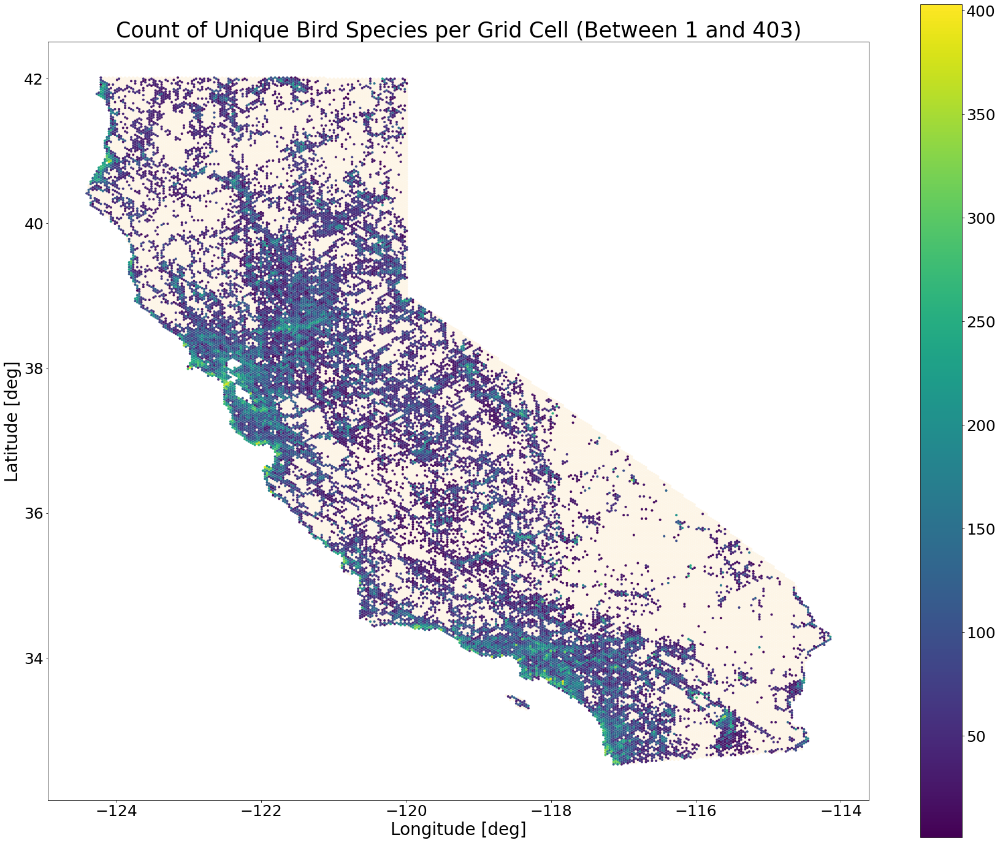

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))

ca_gdf.plot(ax=ax, color='oldlace')
ax2 = bird_species_counts.plot(ax=ax, column=bird_species_counts['verbatimScientificName'], legend=True) 

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Count of Unique Bird Species per Grid Cell (Between 1 and 403)', fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
tree_species_counts = ca_gdf.merge(tree_species, how='left', left_on='ID', right_on='grid')
tree_species_counts

,ID,geom,grid,species
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,15.0
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,15.0
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,27.0
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,37.0
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,6.0
...,...,...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,73.0
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,22.0
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,64.0
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,47.0


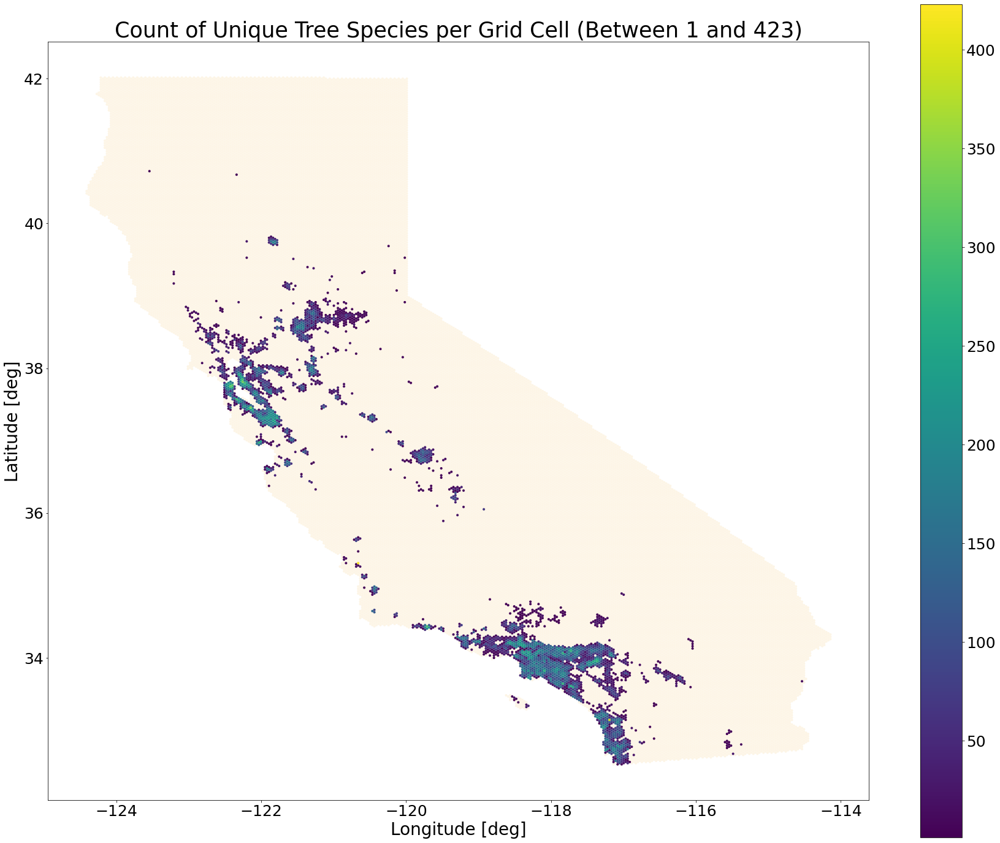

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))

ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = tree_species_counts.plot(ax=ax, column=tree_species_counts['species'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Count of Unique Tree Species per Grid Cell (Between 1 and 423)', fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

## Together

In [ ]:
bird_tree_count = bird_species_counts.merge(tree_species_counts, how='inner', left_on='ID', right_on='ID')
bird_tree_count

,ID,geom_x,grid_x,verbatimScientificName,color_x,margin_x,color_rgba_x,geom_y,grid_y,species,color_y,margin_y,margin2,color_rgba_y
0,24698,"POLYGON ((-119.77660 34.67882, -119.78593 34.6...",NaN,NaN,indigo,NaN,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-119.77660 34.67882, -119.78593 34.6...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
1,24834,"POLYGON ((-119.74863 34.56576, -119.75795 34.5...",24834.0,101.0,indigo,0.248756,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-119.74863 34.56576, -119.75795 34.5...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
2,24837,"POLYGON ((-119.74863 34.66267, -119.75795 34.6...",NaN,NaN,indigo,NaN,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-119.74863 34.66267, -119.75795 34.6...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
3,25110,"POLYGON ((-119.69267 34.56576, -119.70200 34.5...",NaN,NaN,indigo,NaN,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-119.69267 34.56576, -119.70200 34.5...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
4,25248,"POLYGON ((-119.66470 34.58191, -119.67402 34.5...",NaN,NaN,indigo,NaN,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-119.66470 34.58191, -119.67402 34.5...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46795,46795,"POLYGON ((-114.15333 34.30732, -114.16266 34.3...",46795.0,96.0,indigo,0.236318,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-114.15333 34.30732, -114.16266 34.3...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
46796,46796,"POLYGON ((-114.15333 34.33963, -114.16266 34.3...",46796.0,44.0,indigo,0.106965,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-114.15333 34.33963, -114.16266 34.3...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
46797,46797,"POLYGON ((-114.12535 34.25887, -114.13468 34.2...",46797.0,94.0,indigo,0.231343,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-114.12535 34.25887, -114.13468 34.2...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"
46798,46798,"POLYGON ((-114.12535 34.29117, -114.13468 34.3...",46798.0,203.0,indigo,0.502488,"(0.29411764705882354, 0.0, 0.5098039215686274,...","POLYGON ((-114.12535 34.29117, -114.13468 34.3...",NaN,NaN,navy,NaN,NaN,"(0.0, 0.0, 0.5019607843137255, nan)"


In [ ]:
df_bird_tree_count = bird_tree_count[['ID','geom_x','verbatimScientificName','species']]
df_bird_tree_count

,ID,geom_x,verbatimScientificName,species
0,24698,"POLYGON ((-119.77660 34.67882, -119.78593 34.6...",NaN,NaN
1,24834,"POLYGON ((-119.74863 34.56576, -119.75795 34.5...",101.0,NaN
2,24837,"POLYGON ((-119.74863 34.66267, -119.75795 34.6...",NaN,NaN
3,25110,"POLYGON ((-119.69267 34.56576, -119.70200 34.5...",NaN,NaN
4,25248,"POLYGON ((-119.66470 34.58191, -119.67402 34.5...",NaN,NaN
...,...,...,...,...
46795,46795,"POLYGON ((-114.15333 34.30732, -114.16266 34.3...",96.0,NaN
46796,46796,"POLYGON ((-114.15333 34.33963, -114.16266 34.3...",44.0,NaN
46797,46797,"POLYGON ((-114.12535 34.25887, -114.13468 34.2...",94.0,NaN
46798,46798,"POLYGON ((-114.12535 34.29117, -114.13468 34.3...",203.0,NaN


In [ ]:
bird_tree_species = df_bird_tree_count.dropna(axis=0)
unique_species_counts = bird_tree_species.rename(columns=
                          {'geom_x': 'geometry', 
                           'verbatimScientificName': 'BirdSpeciesCount',
                           'species': 'TreeSpeciesCount'
                                                   })
unique_species_counts

,ID,geom_x,verbatimScientificName,species
48,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",228.0,47.0
49,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",112.0,15.0
57,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",175.0,73.0
91,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",73.0,33.0
96,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",162.0,111.0
...,...,...,...,...
43901,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",132.0,3.0
43907,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",199.0,7.0
43982,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",52.0,28.0
44303,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",63.0,10.0


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10kmspeciescount'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
unique_species_counts.to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:08,  8.25s/it]


In [ ]:
unique_species_counts['BirdSpeciesCount'].corr(unique_species_counts['TreeSpeciesCount'])

0.28688068709136044

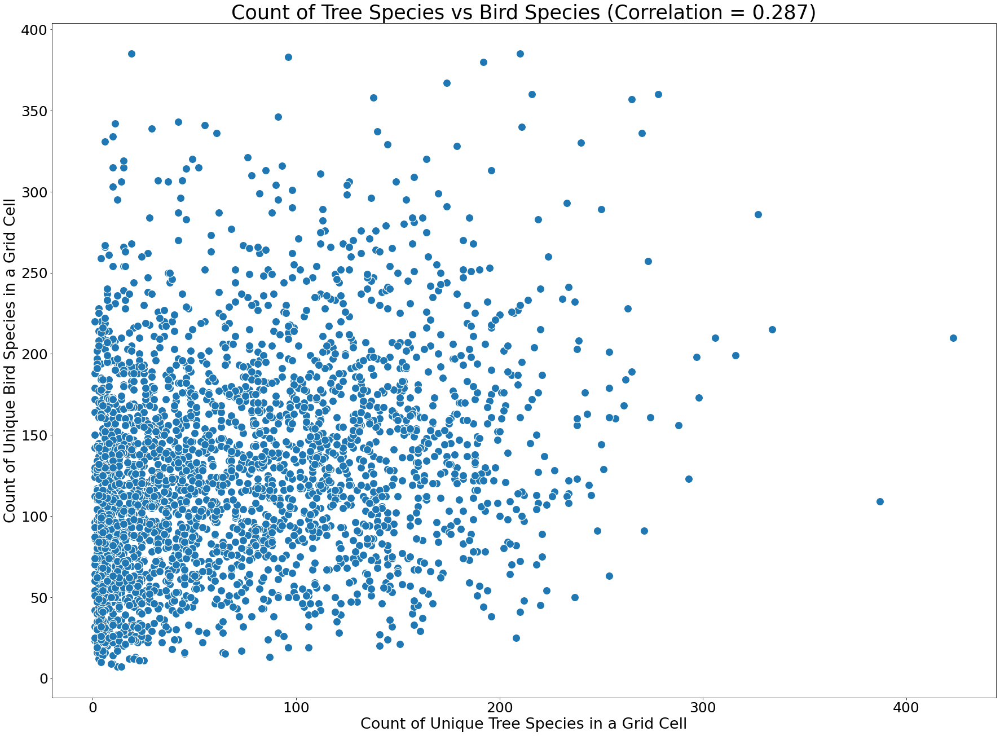

In [ ]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=df_bird_tree_count, x='species',
                y='verbatimScientificName', s=200)
ax.set_xlabel('Count of Unique Tree Species in a Grid Cell', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_ylabel('Count of Unique Bird Species in a Grid Cell', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_title('Count of Tree Species vs Bird Species (Correlation = 0.287)', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

# Native Tree Species

## Tree Counts

In [ ]:
%%bigquery --project urban-forest-269703 native_observations
SELECT grid, sum(nativity) as count, sum(nativity) / count(*) as percentage
FROM `urban-forest-269703.urbanforest.final-with-grid`
group by grid
having count(grid) >= 10

In [ ]:
native_observations

,grid,count,percentage
0,33570,190,0.079266
1,8828,495,0.203369
2,31304,248,0.018517
3,7294,1028,0.149158
4,32699,2579,0.151617
...,...,...,...
2942,17709,13,0.928571
2943,3102,20,1.000000
2944,35640,2,0.200000
2945,30154,1,0.090909


In [ ]:
%%bigquery --project urban-forest-269703 bird_count
SELECT grid, sum(individualCount) as count
FROM `urban-forest-269703.ebird.ebird-final`
group by grid
having sum(individualCount) >= 50

In [ ]:
bird_count

,grid,count
0,6286.0,1116106
1,12254.0,10270032
2,31799.0,81759
3,6426.0,119734
4,19038.0,25949
...,...,...
21844,32274.0,63
21845,23187.0,383
21846,8616.0,574
21847,27441.0,183


In [ ]:
native_counts = ca_gdf.merge(native_observations, how='inner', left_on='ID', right_on='grid')
native_counts = native_counts.merge(bird_count, how='inner', left_on='grid', right_on='grid')
native_counts

,ID,geom,grid,count_x,percentage,count_y
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259,12,0.279070,4932
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199,15,0.468750,5119
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733,26,0.279570,2141
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997,24,0.164384,1085
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646,55,0.785714,397
...,...,...,...,...,...,...
2863,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015,196,0.114219,2350
2864,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128,47,0.100213,152
2865,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241,103,0.078806,200
2866,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242,115,0.092369,1391


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


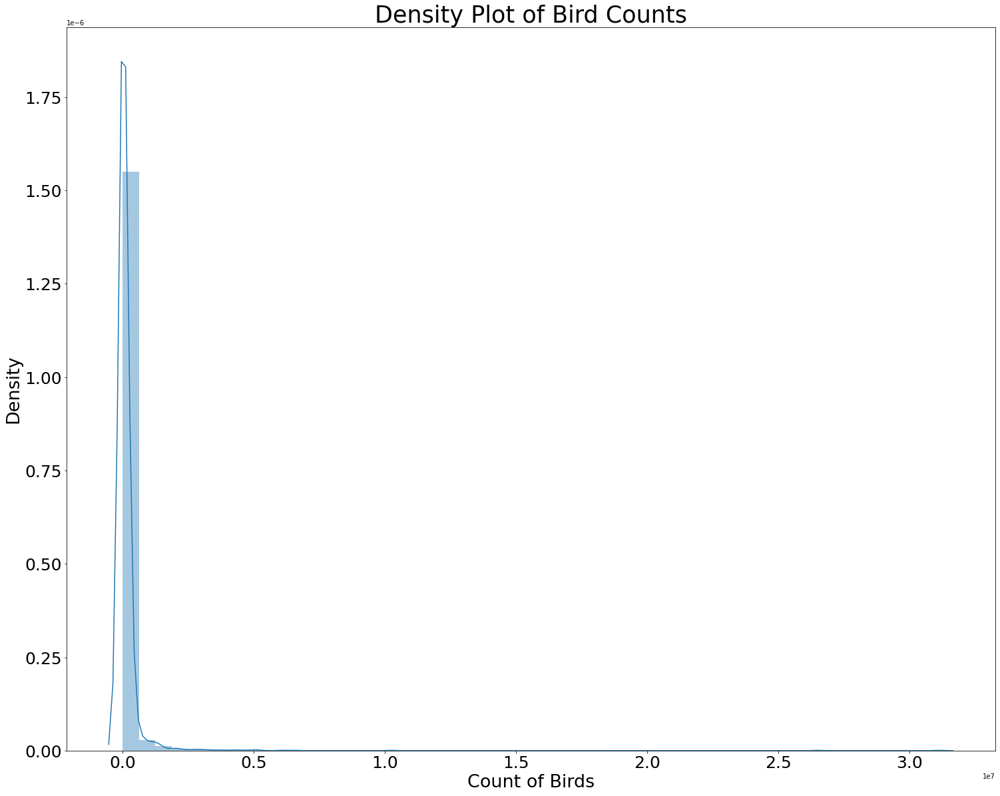

In [ ]:
fig,ax = plt.subplots(figsize=(25,20))
sns.distplot(native_counts['count_y'], ax=ax)
ax.set_xlabel('Count of Birds', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_ylabel('Density', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_title('Density Plot of Bird Counts', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

In [ ]:
native_counts['log_count_tree'] = np.log(native_counts['count_x'] + 1)
native_counts

,ID,geom,grid,count_x,percentage,count_y,log_count_birds,log_count_tree
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259,12,0.279070,4932,8.503500,2.564949
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199,15,0.468750,5119,8.540714,2.772589
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733,26,0.279570,2141,7.669028,3.295837
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997,24,0.164384,1085,6.989335,3.218876
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646,55,0.785714,397,5.983936,4.025352
...,...,...,...,...,...,...,...,...
2863,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015,196,0.114219,2350,7.762171,5.283204
2864,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128,47,0.100213,152,5.023881,3.871201
2865,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241,103,0.078806,200,5.298317,4.644391
2866,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242,115,0.092369,1391,7.237778,4.753590


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


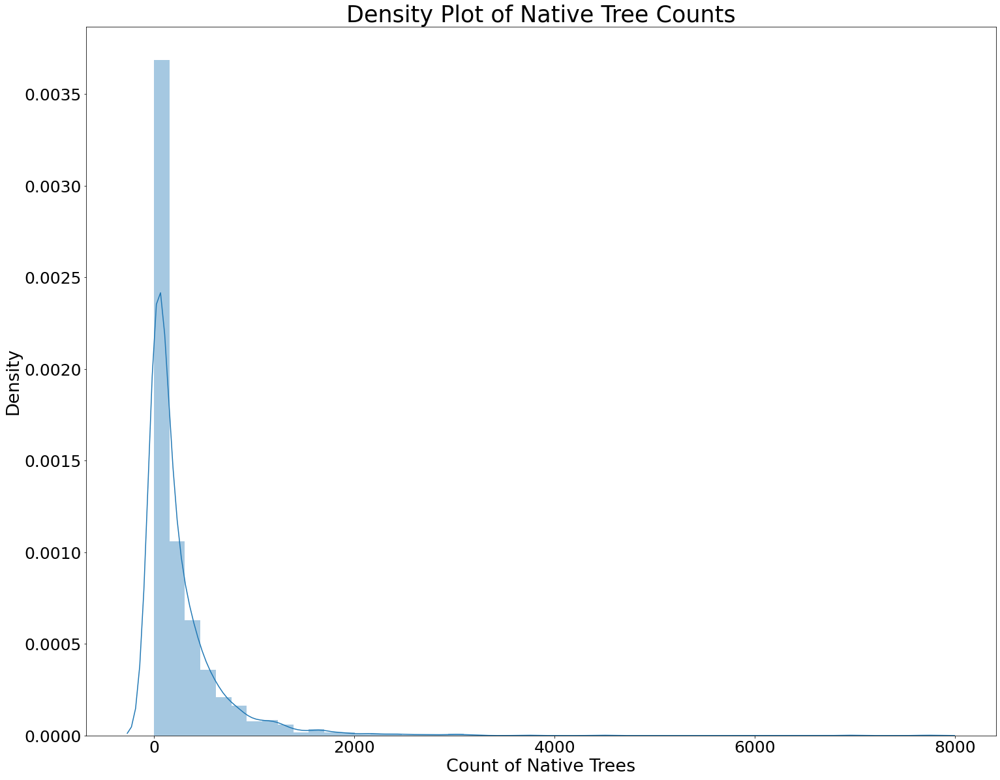

In [ ]:
fig,ax = plt.subplots(figsize=(25,20))
sns.distplot(native_counts['count_x'], ax=ax)
ax.set_xlabel('Count of Native Trees', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_ylabel('Density', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_title('Density Plot of Native Tree Counts', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

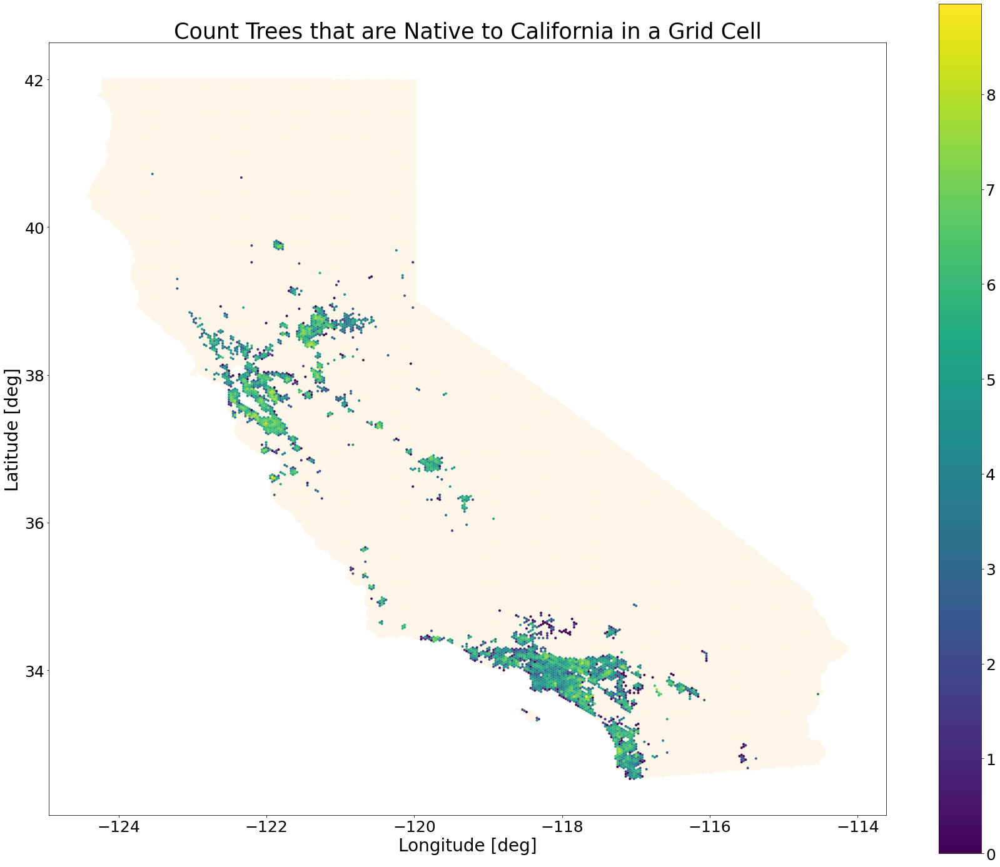

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))

ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = native_counts.plot(ax=ax, column='log_count_tree', legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Count Trees that are Native to California in a Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
native_counts['log_native_tree_count'].corr(native_counts['log_count_birds'])

0.2161948814131549

In [ ]:
native_counts['percentage'].corr(native_counts['log_count_birds'])

-0.07877764326597811

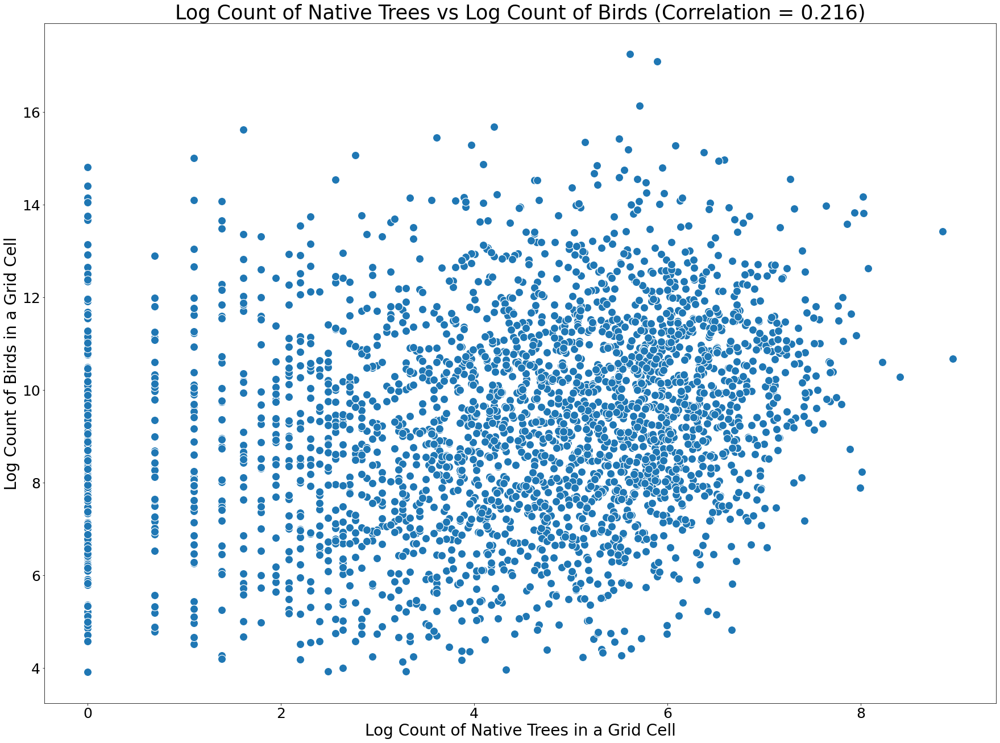

In [ ]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=native_counts, x='log_native_tree_count',
                y='log_count_birds', s=200)
ax.set_xlabel('Log Count of Native Trees in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Log Count of Birds in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Log Count of Native Trees vs Log Count of Birds (Correlation = 0.216)', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

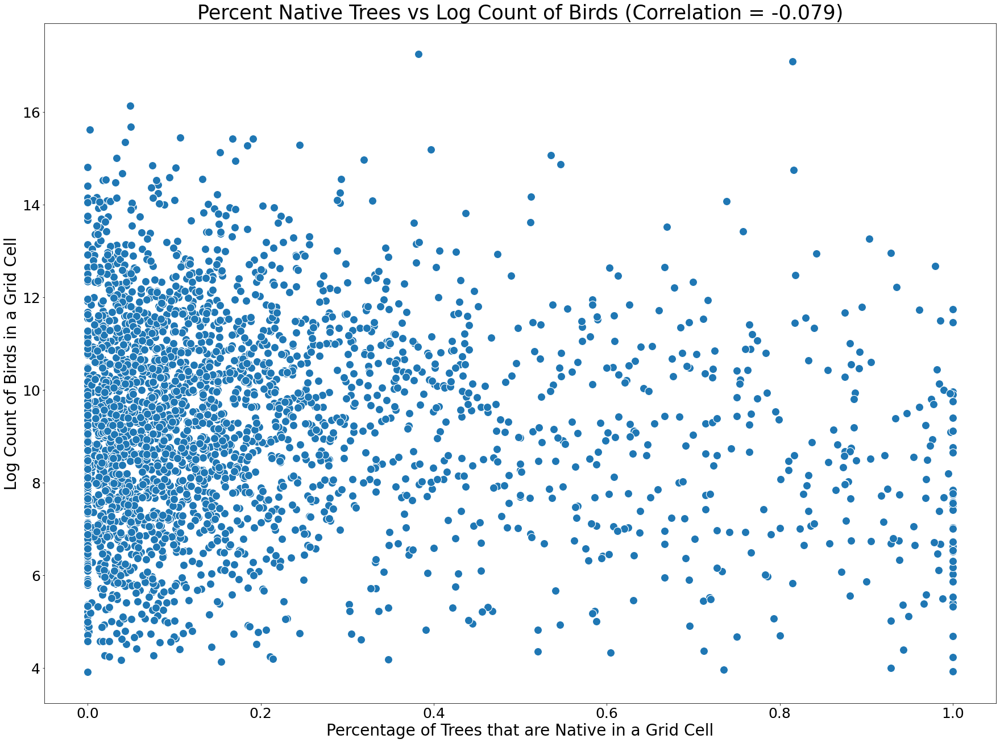

In [ ]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=native_counts, x='percentage',
                y='log_count_birds', s=200)
ax.set_xlabel('Percentage of Trees that are Native in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Log Count of Birds in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent Native Trees vs Log Count of Birds (Correlation = -0.079)', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

In [ ]:
native_counts = native_counts.rename(columns=
                          {'count_x': 'CountNativeTrees', 
                           'percentage': 'PercentNativeTree',
                           'count_y': 'BirdCount',
                           'log_count_birds': 'LogBirdCount'})
native_counts.iloc[:,[0,1,3,4,5,6]]

,ID,geom,CountNativeTrees,PercentNativeTree,BirdCount,LogBirdCount
0,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",222,0.613260,259578,12.466813
1,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",12,0.279070,4932,8.503500
2,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",243,0.392569,49183,10.803303
3,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",3,0.009585,1882,7.540090
4,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",97,0.142438,15421,9.643485
...,...,...,...,...,...,...
2863,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",0,0.000000,35104,10.466070
2864,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",2,0.029851,23131,10.048929
2865,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",6,0.035714,7497,8.922258
2866,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",15,0.086705,1478,7.298445


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10kmnativecounts'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
native_counts.iloc[:,[0,1,3,4,5]].to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:04,  4.10s/it]


## Tree Species

In [ ]:
%%bigquery --project urban-forest-269703 native_tree_species
SELECT grid, count(distinct species) as species, count(distinct IF(nativity = 1, species, NULL)) as native
FROM `urban-forest-269703.urbanforest.final-with-grid`
where grid in (SELECT grid
  FROM `urban-forest-269703.urbanforest.final-with-grid`
  group by grid
  having count(grid) >= 10)
group by grid

In [ ]:
native_tree_species['percentage'] = native_tree_species['native'] / native_tree_species['species']
native_tree_species

,grid,species,native,percentage
0,33570,81,10,0.123457
1,8828,152,14,0.092105
2,31304,211,17,0.080569
3,7294,224,32,0.142857
4,32699,270,18,0.066667
...,...,...,...,...
2942,17709,6,5,0.833333
2943,3102,3,3,1.000000
2944,31966,2,1,0.500000
2945,35640,4,1,0.250000


In [ ]:
%%bigquery --project urban-forest-269703 df_birds
SELECT grid, verbatimScientificName
FROM `urban-forest-269703.ebird.ebird-final`
where grid in(SELECT grid
  FROM `urban-forest-269703.ebird.ebird-final`
  group by grid
  having sum(individualCount) >= 50)
group by grid, verbatimScientificName

In [ ]:
bird_species = df_birds.groupby('grid').count().reset_index()
bird_species

,grid,verbatimScientificName
0,0,87
1,2,55
2,3,105
3,4,129
4,7,90
...,...,...
21843,46793,167
21844,46795,96
21845,46796,44
21846,46797,94


In [ ]:
native_species = ca_gdf.merge(native_tree_species, how='inner', left_on='ID', right_on='grid')
native_species

,ID,geom,grid,species,native,percentage
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259,15,4,0.266667
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199,15,2,0.133333
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733,27,5,0.185185
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997,37,6,0.162162
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646,6,2,0.333333
...,...,...,...,...,...,...
2942,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015,73,5,0.068493
2943,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128,22,2,0.090909
2944,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241,64,6,0.093750
2945,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242,47,3,0.063830


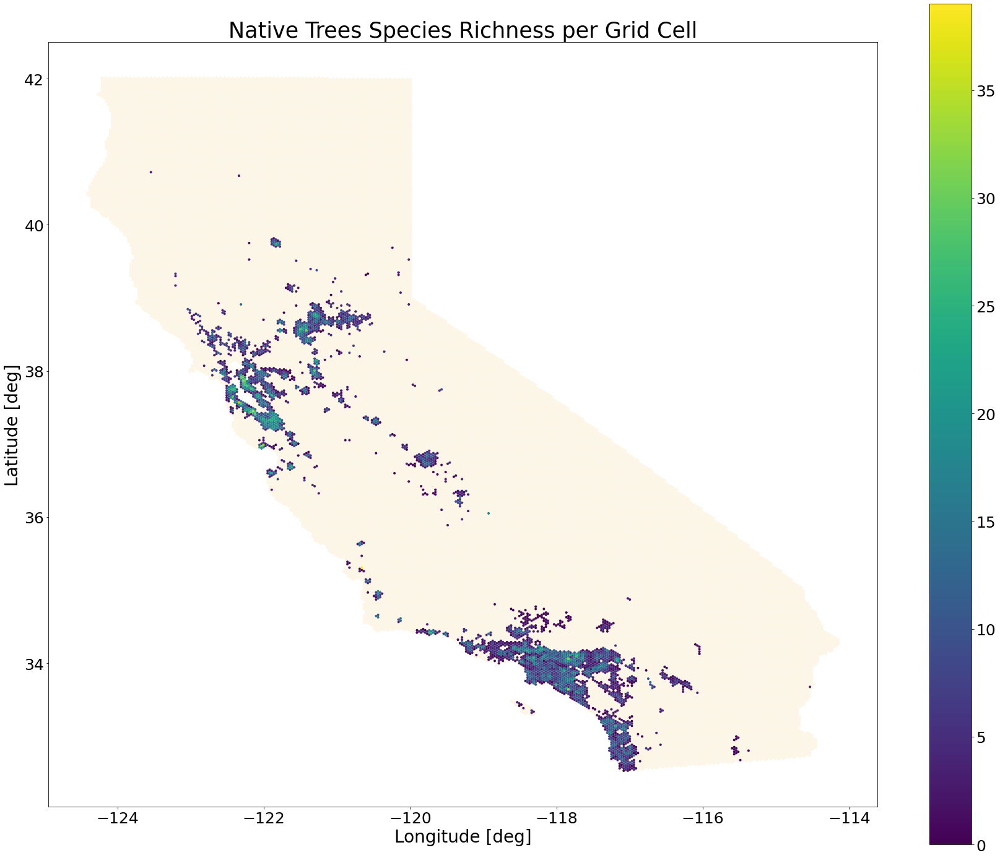

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))

ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = native_species.plot(ax=ax, column='native', legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Native Trees Species Richness per Grid Cell', fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
native_species = native_species.merge(bird_species, how='inner', left_on='grid', right_on='grid')
native_species

,ID,geom,grid,species,native,percentage,verbatimScientificName
0,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",27258,47,5,0.106383,228
1,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259,15,4,0.266667,112
2,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",27394,73,9,0.123288,175
3,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",28064,33,2,0.060606,73
4,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",28198,111,11,0.099099,162
...,...,...,...,...,...,...,...
2863,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",43724,3,0,0.000000,132
2864,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",43730,7,1,0.142857,199
2865,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",43815,28,2,0.071429,52
2866,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",44193,10,1,0.100000,63


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


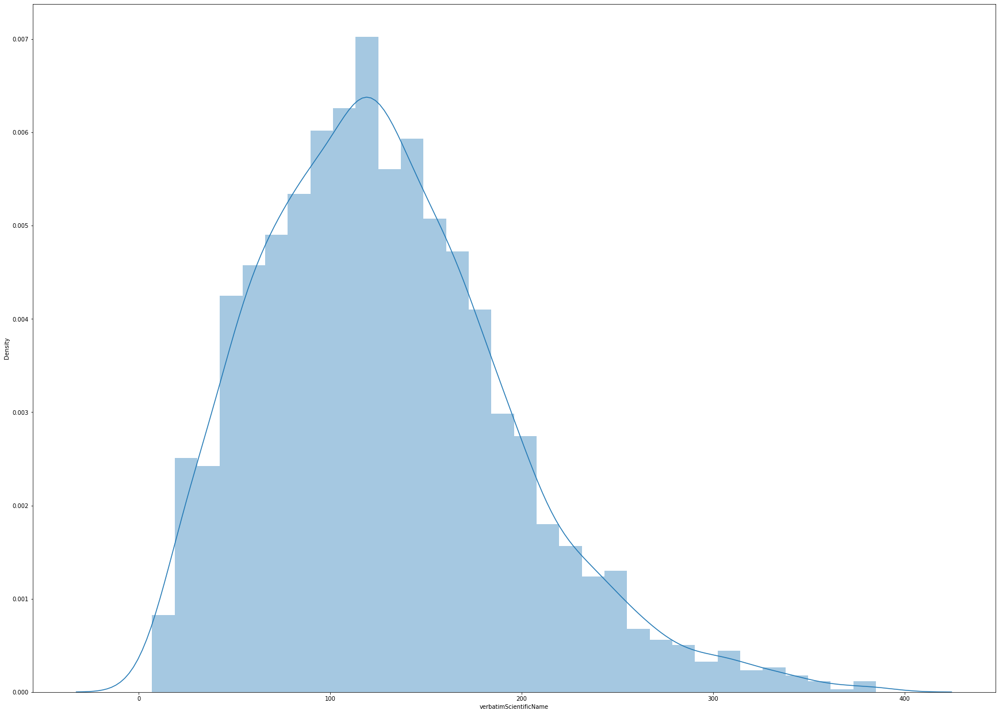

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
sns.distplot(native_species['verbatimScientificName'], ax=ax)

In [ ]:
native_species['native'].corr(native_species['verbatimScientificName'])

0.2862195002883168

In [ ]:
native_species['percentage'].corr(native_species['verbatimScientificName'])

-0.1303882628025233

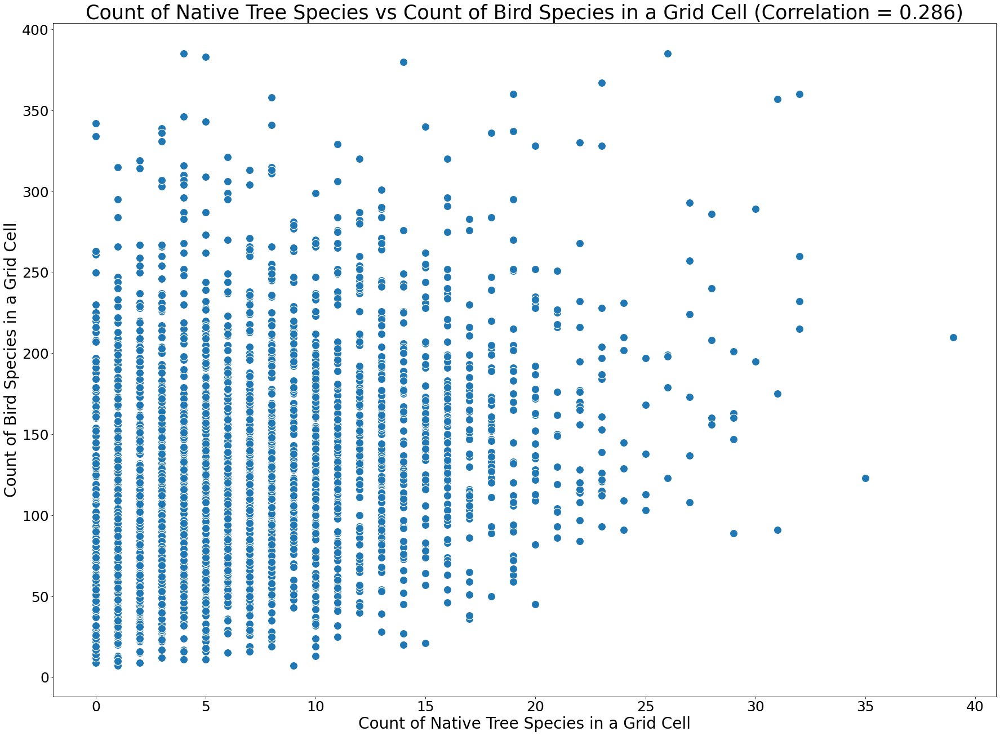

In [ ]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=native_species, x='native',
                y='verbatimScientificName', s=200)
ax.set_xlabel('Count of Native Tree Species in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Count of Bird Species in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Count of Native Tree Species vs Count of Bird Species in a Grid Cell (Correlation = 0.286)', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

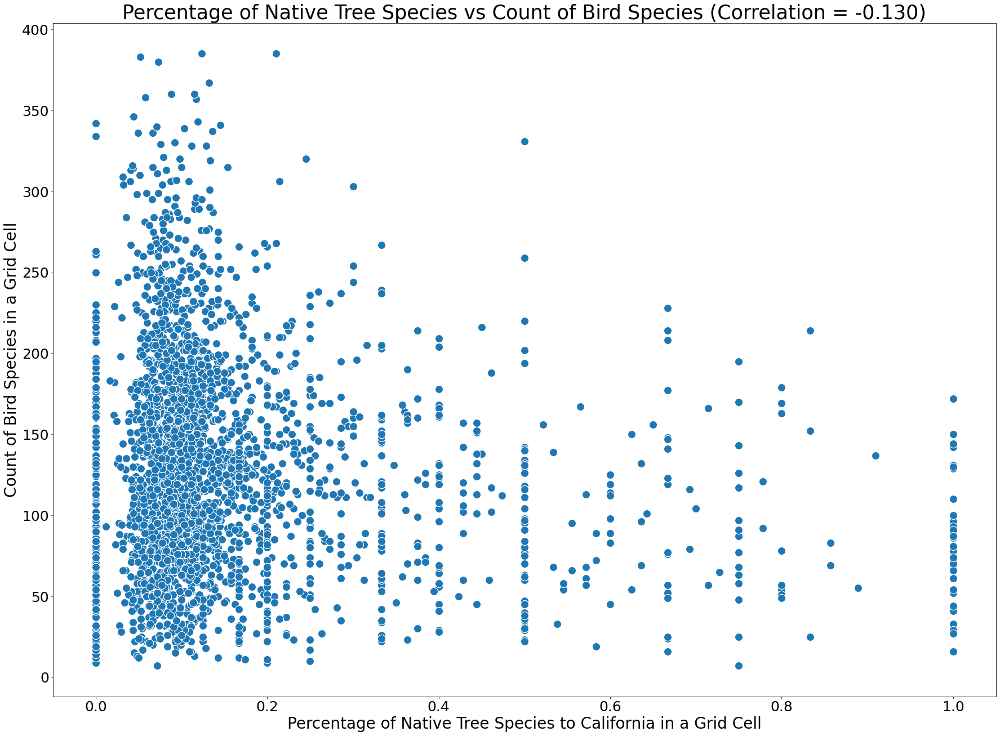

In [ ]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=native_species, x='percentage',
                y='verbatimScientificName', s=200)
ax.set_xlabel('Percentage of Native Tree Species to California in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Count of Bird Species in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percentage of Native Tree Species vs Count of Bird Species (Correlation = -0.130)', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

In [ ]:
native_species = native_species.rename(columns=
                          {'species': 'CountTreeSpecies', 
                           'native': 'CountNativeTreeSpecies',
                           'percentage': 'PercentNativeTreeSpecies',
                           'verbatimScientificName': 'CountBirdSpecies'})
native_species.iloc[:,[0,1,3,4,5,6]]

,ID,geom,CountTreeSpecies,CountNativeTreeSpecies,PercentNativeTreeSpecies,CountBirdSpecies
0,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",47,5,0.106383,228
1,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",15,4,0.266667,112
2,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",73,9,0.123288,175
3,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",33,2,0.060606,73
4,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",111,11,0.099099,162
...,...,...,...,...,...,...
2863,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",3,0,0.000000,132
2864,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",7,1,0.142857,199
2865,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",28,2,0.071429,52
2866,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",10,1,0.100000,63


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10kmnativespecies'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
native_species.iloc[:,[0,1,3,4,5,6]].to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:05,  5.03s/it]


# Observation Counts

In [ ]:
%%bigquery --project urban-forest-269703 bird_count
SELECT grid, sum(individualCount) as count
FROM `urban-forest-269703.ebird.ebird-final`
group by grid
having sum(individualCount) >= 50

In [ ]:
bird_count

,grid,count
0,10177.0,506101
1,33696.0,44168
2,8708.0,388841
3,11126.0,75500
4,9644.0,247933
...,...,...
21843,20654.0,50
21844,25013.0,70
21845,21234.0,350
21846,33349.0,73


In [ ]:
%%bigquery --project urban-forest-269703 tree_count
SELECT grid, count(grid) as count
FROM `urban-forest-269703.urbanforest.final-with-grid`
group by grid
having count(grid) >= 10

In [ ]:
tree_count

,grid,count
0,7908,1762
1,34418,16182
2,31045,3271
3,8835,2372
4,31692,4226
...,...,...
2942,7447,12
2943,6725,11
2944,34914,16
2945,30909,12


In [ ]:
bird_tree = bird_count.merge(tree_count, how='outer', left_on='grid', right_on='grid')
bird_tree_count = ca_gdf.merge(bird_tree, how='outer', left_on='ID', right_on='grid')
df_counts = bird_tree_count.dropna()
df_counts

,ID,geom,grid,count_x,count_y
0,24698.0,"POLYGON ((-119.77660 34.67882, -119.78593 34.6...",NaN,NaN,NaN
1,24834.0,"POLYGON ((-119.74863 34.56576, -119.75795 34.5...",24834.0,2757.0,NaN
2,24837.0,"POLYGON ((-119.74863 34.66267, -119.75795 34.6...",NaN,NaN,NaN
3,25110.0,"POLYGON ((-119.69267 34.56576, -119.70200 34.5...",NaN,NaN,NaN
4,25248.0,"POLYGON ((-119.66470 34.58191, -119.67402 34.5...",NaN,NaN,NaN
...,...,...,...,...,...
46796,46796.0,"POLYGON ((-114.15333 34.33963, -114.16266 34.3...",46796.0,439.0,NaN
46797,46797.0,"POLYGON ((-114.12535 34.25887, -114.13468 34.2...",46797.0,2217.0,NaN
46798,46798.0,"POLYGON ((-114.12535 34.29117, -114.13468 34.3...",46798.0,115450.0,NaN
46799,46799.0,"POLYGON ((-114.12535 34.32348, -114.13468 34.3...",NaN,NaN,NaN


In [ ]:
df_counts = df_counts.rename(columns=
                          {'geom': 'geometry', 
                           'count_x': 'BirdCounts',
                           'count_y': 'TreeCounts'
                                                   }).iloc[:,[0,1,3,4]]
df_counts

,ID,geometry,BirdCounts,TreeCounts
48,27258.0,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",259578.0,362.0
49,27259.0,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",4932.0,43.0
57,27394.0,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",49183.0,619.0
91,28064.0,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",1882.0,313.0
96,28198.0,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",15421.0,681.0
...,...,...,...,...
43901,43724.0,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",35104.0,15.0
43907,43730.0,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",23131.0,67.0
43982,43815.0,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",7497.0,168.0
44303,44193.0,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",1478.0,173.0


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


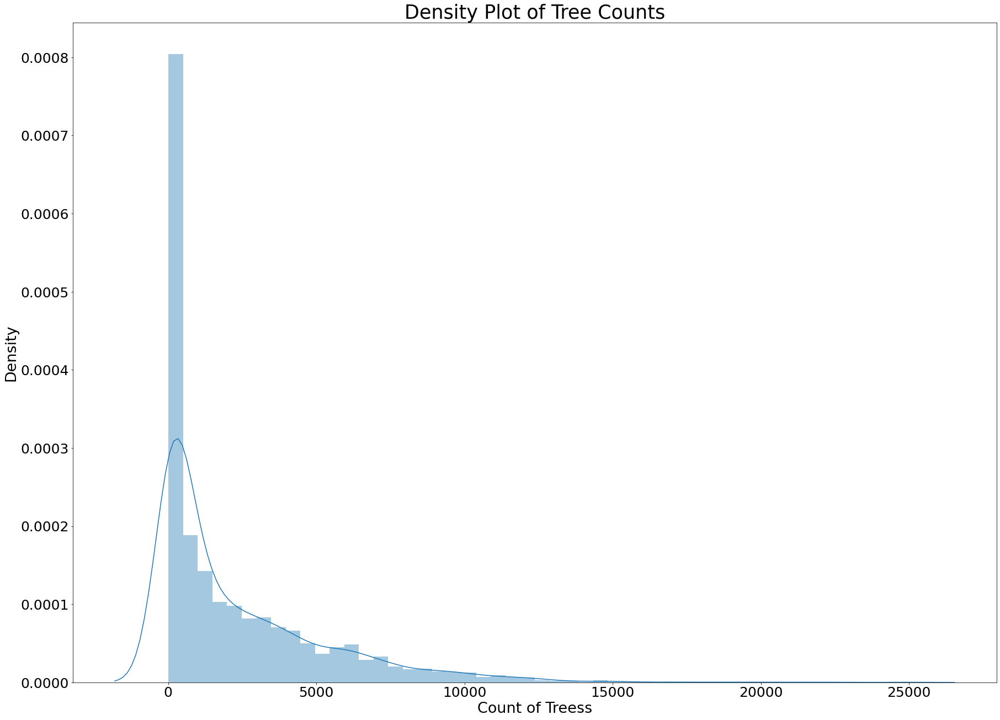

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
sns.distplot(df_counts['TreeCounts'], ax=ax)
ax.set_xlabel('Count of Treess', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_ylabel('Density', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_title('Density Plot of Tree Counts', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

In [ ]:
df_counts['LogBirdCounts'] = np.log(df_counts['BirdCounts']+1)
df_counts['LogTreeCounts'] = np.log(df_counts['TreeCounts']+1)
df_counts

,ID,geometry,BirdCounts,TreeCounts,LogBirdCounts,LogTreeCounts
48,27258.0,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",259578.0,362.0,12.466816,5.894403
49,27259.0,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",4932.0,43.0,8.503703,3.784190
57,27394.0,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",49183.0,619.0,10.803324,6.429719
91,28064.0,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",1882.0,313.0,7.540622,5.749393
96,28198.0,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",15421.0,681.0,9.643550,6.525030
...,...,...,...,...,...,...
43901,43724.0,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",35104.0,15.0,10.466099,2.772589
43907,43730.0,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",23131.0,67.0,10.048972,4.219508
43982,43815.0,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",7497.0,168.0,8.922392,5.129899
44303,44193.0,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",1478.0,173.0,7.299121,5.159055


In [ ]:
df_counts['TreeCounts'].corr(df_counts['BirdCounts'])

0.005510398776137294

In [ ]:
df_counts['LogTreeCounts'].corr(df_counts['LogBirdCounts'])

0.22732955260927865

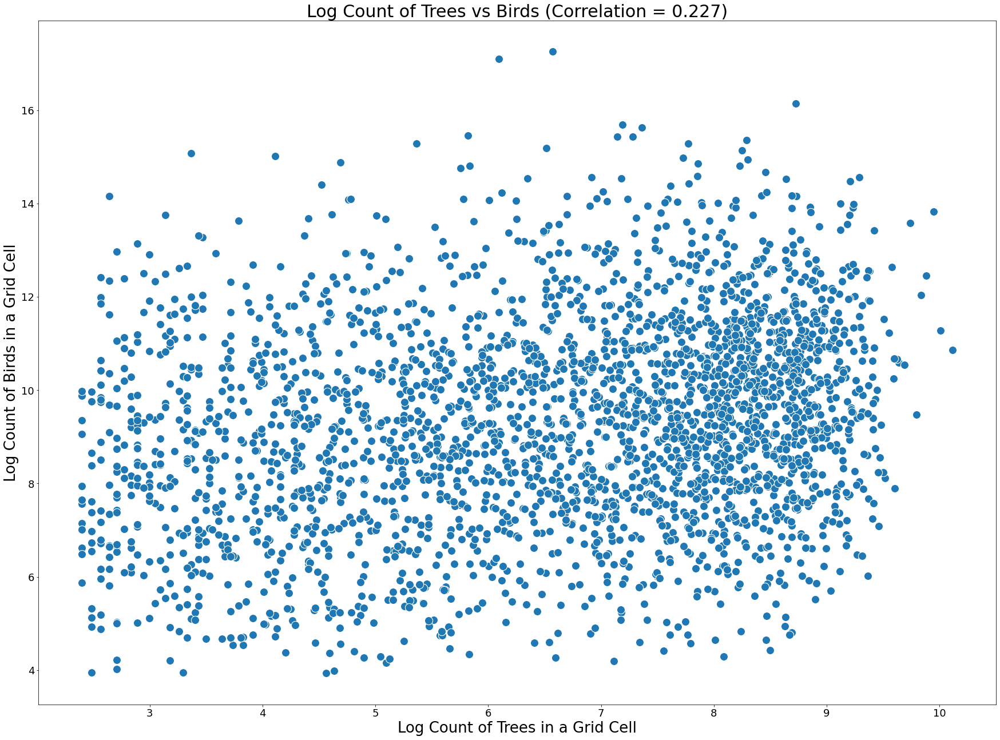

In [ ]:
import seaborn as sns
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=df_counts, x='LogTreeCounts',
                y='LogBirdCounts', s=200)
ax.set_xlabel('Log Count of Trees in a Grid Cell', fontdict={'fontsize': 26, 'fontweight': 'medium'})
ax.set_ylabel('Log Count of Birds in a Grid Cell', fontdict={'fontsize': 26, 'fontweight': 'medium'})
ax.set_title('Log Count of Trees vs Birds (Correlation = 0.227)', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
fig.show()

In [ ]:
df_counts

,ID,geometry,BirdCounts,TreeCounts,LogBirdCounts,LogTreeCounts
48,27258.0,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",259578.0,362.0,12.466816,5.894403
49,27259.0,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",4932.0,43.0,8.503703,3.784190
57,27394.0,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",49183.0,619.0,10.803324,6.429719
91,28064.0,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",1882.0,313.0,7.540622,5.749393
96,28198.0,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",15421.0,681.0,9.643550,6.525030
...,...,...,...,...,...,...
43901,43724.0,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",35104.0,15.0,10.466099,2.772589
43907,43730.0,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",23131.0,67.0,10.048972,4.219508
43982,43815.0,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",7497.0,168.0,8.922392,5.129899
44303,44193.0,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",1478.0,173.0,7.299121,5.159055


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10kmcounts'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
df_counts.to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:04,  4.14s/it]


# Shannon-Wiener Index Insights

## Birds

In [ ]:
%%bigquery --project urban-forest-269703 df_birds2
SELECT grid, sum(individualCount) as overallCount
FROM `urban-forest-269703.ebird.ebird-final`
group by grid
having sum(individualCount) >= 50

In [ ]:
# Count of unique species per grid from above
df_birds2

,grid,overallCount
0,14415.0,1642
1,5507.0,397996
2,40550.0,10818
3,6428.0,934142
4,9151.0,18125
...,...,...
21844,11779.0,53
21845,28289.0,118
21846,37337.0,56
21847,25573.0,673


In [ ]:
%%bigquery --project urban-forest-269703 df_birds3
SELECT grid, verbatimScientificName, sum(individualCount) as speciesCount
FROM `urban-forest-269703.ebird.ebird-final`
group by grid, verbatimScientificName

In [ ]:
# Number of observations for each species
df_birds3

,grid,verbatimScientificName,speciesCount
0,17278.0,Falco sparverius,36
1,12013.0,Junco hyemalis,1807
2,7894.0,Colaptes auratus,211
3,8515.0,Spinus tristis,98
4,7584.0,Corvus corax,63
...,...,...,...
1668956,17820.0,Oxyura jamaicensis,25
1668957,9187.0,Petrochelidon pyrrhonota,25
1668958,12794.0,Melozone crissalis,25
1668959,6587.0,Mergus merganser,25


In [ ]:
sw_index = df_birds2.merge(df_birds3, how='left', left_on='grid', right_on='grid')
sw_index['p_i'] = sw_index['speciesCount'] / sw_index['overallCount']
sw_index['ln(p_i)'] = np.log(sw_index['p_i'])
sw_index['entropy'] = sw_index['ln(p_i)'] * sw_index['p_i']
sw_index

,grid,overallCount,verbatimScientificName,speciesCount,p_i,ln(p_i),entropy
0,14415.0,1642,Colaptes auratus,31,0.018879,-3.969683,-0.074945
1,14415.0,1642,Buteo lineatus,28,0.017052,-4.071466,-0.069428
2,14415.0,1642,Cathartes aura,34,0.020706,-3.877310,-0.080285
3,14415.0,1642,Meleagris gallopavo,53,0.032278,-3.433378,-0.110822
4,14415.0,1642,Anas platyrhynchos,30,0.018270,-4.002473,-0.073127
...,...,...,...,...,...,...,...
1616944,25573.0,673,Streptopelia decaocto,3,0.004458,-5.413133,-0.024130
1616945,25573.0,673,Charadrius vociferus,4,0.005944,-5.125451,-0.030463
1616946,25573.0,673,Corvus brachyrhynchos,5,0.007429,-4.902307,-0.036421
1616947,25573.0,673,Tringa melanoleuca,10,0.014859,-4.209160,-0.062543


In [ ]:
df_sw_index = sw_index.groupby('grid').sum('entropy').reset_index()
df_sw_index['Shannon-Wiener'] = -df_sw_index['entropy']
df_sw_index

,grid,overallCount,speciesCount,p_i,ln(p_i),entropy,Shannon-Wiener
0,0.0,1057572,12156,1.0,-594.730858,-2.156587,2.156587
1,2.0,56980,1036,1.0,-278.992422,-3.090369,3.090369
2,3.0,502425,4785,1.0,-683.247502,-3.326592,3.326592
3,4.0,1962090,15210,1.0,-821.827752,-3.797207,3.797207
4,7.0,314460,3494,1.0,-579.081348,-2.453083,2.453083
...,...,...,...,...,...,...,...
21843,46793.0,3969757,23771,1.0,-1202.606361,-3.130180,3.130180
21844,46795.0,316512,3297,1.0,-603.998975,-2.961572,2.961572
21845,46796.0,19316,439,1.0,-212.828463,-2.658382,2.658382
21846,46797.0,208398,2217,1.0,-542.634391,-3.251794,3.251794


In [ ]:
gdf_sw = ca_gdf.merge(df_sw_index, how='left', left_on='ID', right_on='grid')
gdf_sw = gdf_sw.dropna()
gdf_sw

,ID,geom,grid,overallCount,speciesCount,p_i,ln(p_i),entropy,Shannon-Wiener
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,552384.0,4932.0,1.0,-662.750774,-3.829101,3.829101
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,481186.0,5119.0,1.0,-536.761785,-3.679468,3.679468
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,199113.0,2141.0,1.0,-507.656363,-3.758338,3.758338
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,48825.0,1085.0,1.0,-240.151653,-2.466845,2.466845
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,16674.0,397.0,1.0,-189.829306,-3.020692,3.020692
...,...,...,...,...,...,...,...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,188000.0,2350.0,1.0,-478.654002,-2.997418,2.997418
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,4712.0,152.0,1.0,-125.174049,-2.840138,2.840138
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,7000.0,200.0,1.0,-148.726895,-2.757918,2.757918
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,108498.0,1391.0,1.0,-424.576876,-3.412225,3.412225


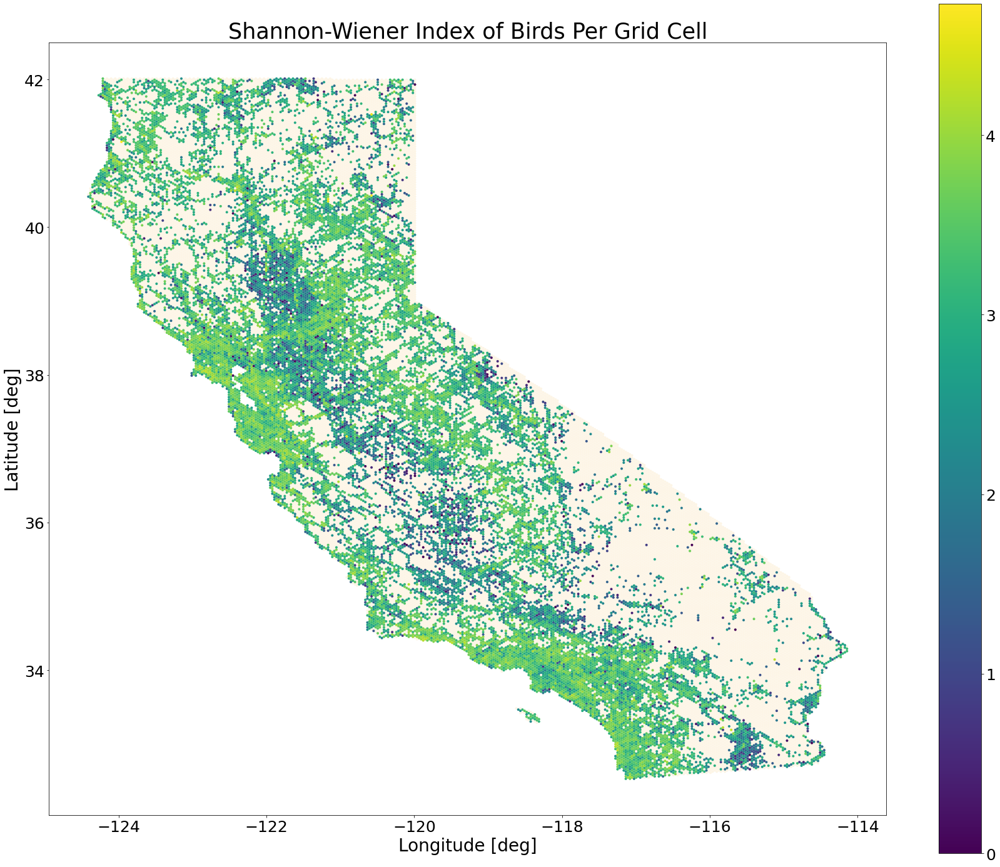

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = gdf_sw.plot(ax=ax, column=gdf_sw['Shannon-Wiener'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Shannon-Wiener Index of Birds Per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

## Trees

In [ ]:
%%bigquery --project urban-forest-269703 df_trees2
SELECT grid, count(*) as overallCount
FROM `urban-forest-269703.urbanforest.final-with-grid`
group by grid
having count(*) >= 10

In [ ]:
df_trees2

,grid,overallCount
0,33570.0,2397
1,8828.0,2434
2,31304.0,13393
3,7294.0,6892
4,32699.0,17010
...,...,...
2943,17287.0,15
2944,3102.0,20
2945,31966.0,14
2946,35640.0,10


In [ ]:
%%bigquery --project urban-forest-269703 df_trees3
SELECT grid, species, count(species) as speciesCount
FROM `urban-forest-269703.urbanforest.final-with-grid`
group by grid, species

In [ ]:
df_trees3

,grid,species,speciesCount
0,33324.0,Archontophoenix cunninghamiana,93
1,6559.0,Metrosideros excelsa,302
2,32581.0,Phoenix dactylifera,85
3,31696.0,Metrosideros excelsa,43
4,37354.0,Eucalyptus polyanthemos,88
...,...,...,...
211870,31957.0,Tristaniopsis laurina,27
211871,36296.0,Prunus cerasifera,27
211872,7435.0,Ginkgo biloba,27
211873,13205.0,Morus alba,27


In [ ]:
tree_df = df_trees2.merge(df_trees3, how='left', left_on='grid', right_on='grid')
tree_df

,grid,overallCount,species,speciesCount
0,33570.0,2397,Corymbia citriodora,114
1,33570.0,2397,Jacaranda,31
2,33570.0,2397,Lagerstroemia,505
3,33570.0,2397,Pinus eldarica,43
4,33570.0,2397,Pinus halepensis,37
...,...,...,...,...
211195,35640.0,10,Platanus racemosa,2
211196,35640.0,10,Pinus halepensis,5
211197,30154.0,11,Quercus agrifolia,1
211198,30154.0,11,Schinus molle,1


In [ ]:
tree_df['p_i'] = tree_df['speciesCount'] / tree_df['overallCount']
tree_df['log(p_i)'] = np.log(tree_df['p_i'])
tree_df['entropy'] = tree_df['log(p_i)'] * tree_df['p_i']
sw_df = tree_df.groupby('grid').sum('entropy').reset_index(0)
sw_df['Shannon-Wiener'] = -sw_df['entropy']
sw_df

,grid,overallCount,speciesCount,p_i,log(p_i),entropy,Shannon-Wiener
0,1871.0,81,27,1.0,-4.106767,-0.848686,0.848686
1,3098.0,72,12,1.0,-12.201390,-1.539654,1.539654
2,3102.0,60,20,1.0,-5.460836,-0.518186,0.518186
3,3103.0,801,89,1.0,-26.856233,-1.536072,1.536072
4,3765.0,1079,83,1.0,-42.682503,-1.946780,1.946780
...,...,...,...,...,...,...,...
2942,43724.0,45,15,1.0,-3.559802,-1.009614,1.009614
2943,43730.0,469,67,1.0,-16.584501,-1.558424,1.558424
2944,43815.0,4704,168,1.0,-106.356012,-2.845767,2.845767
2945,44193.0,1730,173,1.0,-24.844720,-2.140016,2.140016


In [ ]:
sw_gdf = ca_gdf.merge(sw_df, how='left', left_on='ID', right_on='grid')
sw_gdf = sw_gdf.dropna()
sw_gdf

,ID,geom,grid,overallCount,speciesCount,p_i,log(p_i),entropy,Shannon-Wiener
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,645.0,43.0,1.0,-45.849766,-2.376302,2.376302
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,480.0,32.0,1.0,-47.149757,-2.105159,2.105159
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,2511.0,93.0,1.0,-98.267375,-2.952655,2.952655
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,5402.0,146.0,1.0,-151.381259,-3.108846,3.108846
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,420.0,70.0,1.0,-14.712015,-1.304569,1.304569
...,...,...,...,...,...,...,...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,125268.0,1716.0,1.0,-395.320330,-3.264270,3.264270
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,10318.0,469.0,1.0,-82.386120,-2.520289,2.520289
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,83648.0,1307.0,1.0,-335.234615,-3.289508,3.289508
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,58515.0,1245.0,1.0,-232.202175,-2.925512,2.925512


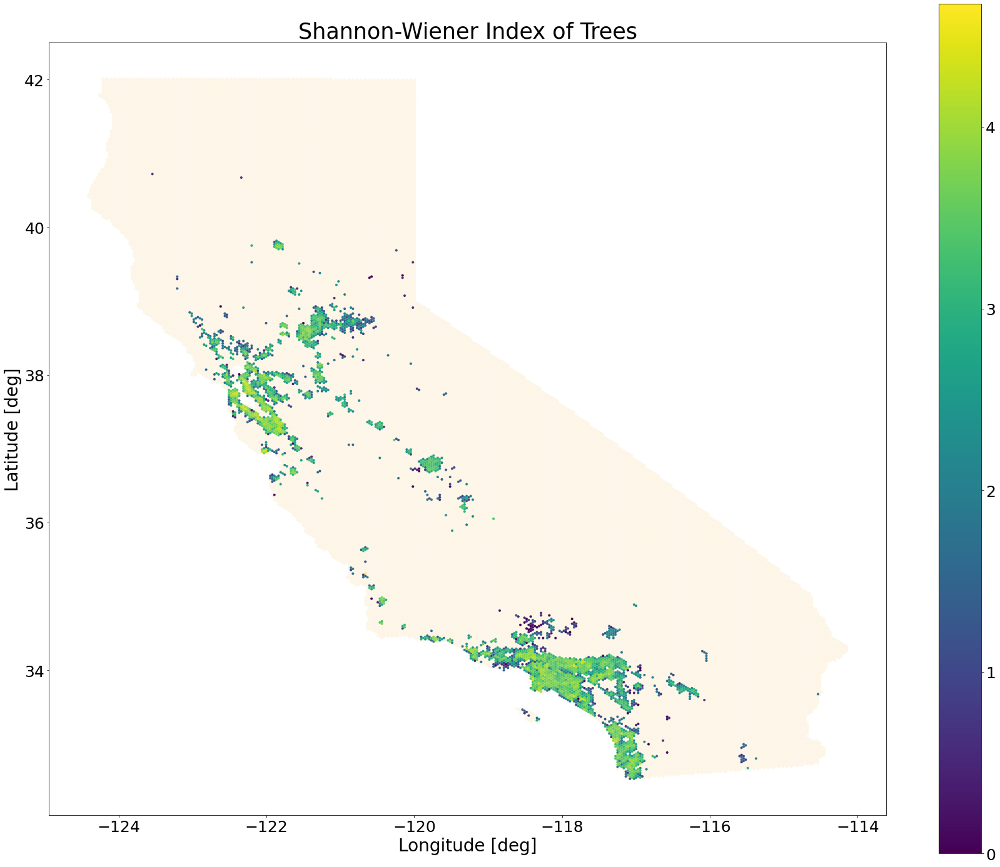

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = sw_gdf.plot(ax=ax, column=sw_gdf['Shannon-Wiener'], legend=True)
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Shannon-Wiener Index of Trees', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

## Together

In [ ]:
sw_gdf

,ID,geom,grid,overallCount,speciesCount,p_i,log(p_i),entropy,Shannon-Wiener
48,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",27258.0,17014.0,362.0,1.0,-227.285973,-2.644362,2.644362
49,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,645.0,43.0,1.0,-45.849766,-2.376302,2.376302
57,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",27394.0,45187.0,619.0,1.0,-377.387027,-3.331102,3.331102
91,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",28064.0,10329.0,313.0,1.0,-150.170004,-2.529157,2.529157
96,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",28198.0,75591.0,681.0,1.0,-615.890228,-3.691838,3.691838
...,...,...,...,...,...,...,...,...,...
43901,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",43724.0,45.0,15.0,1.0,-3.559802,-1.009614,1.009614
43907,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",43730.0,469.0,67.0,1.0,-16.584501,-1.558424,1.558424
43982,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",43815.0,4704.0,168.0,1.0,-106.356012,-2.845767,2.845767
44303,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",44193.0,1730.0,173.0,1.0,-24.844720,-2.140016,2.140016


In [ ]:
gdf_sw

,ID,geom,grid,overallCount,speciesCount,p_i,ln(p_i),entropy,Shannon-Wiener
1,24834,"POLYGON ((-119.74863 34.56576, -119.75795 34.5...",24834.0,278457.0,2757.0,1.0,-571.110577,-3.810260,3.810260
7,25384,"POLYGON ((-119.63672 34.56576, -119.64604 34.5...",25384.0,8858.0,206.0,1.0,-179.718437,-3.414635,3.414635
10,25519,"POLYGON ((-119.60874 34.54961, -119.61807 34.5...",25519.0,1350.0,50.0,1.0,-92.807045,-3.147906,3.147906
11,25520,"POLYGON ((-119.60874 34.58191, -119.61807 34.5...",25520.0,5152.0,112.0,1.0,-191.650234,-3.416428,3.416428
14,25655,"POLYGON ((-119.58077 34.56576, -119.59009 34.5...",25655.0,1474.0,67.0,1.0,-74.759768,-2.807519,2.807519
...,...,...,...,...,...,...,...,...,...
46793,46793,"POLYGON ((-114.15333 34.24271, -114.16266 34.2...",46793.0,3969757.0,23771.0,1.0,-1202.606361,-3.130180,3.130180
46795,46795,"POLYGON ((-114.15333 34.30732, -114.16266 34.3...",46795.0,316512.0,3297.0,1.0,-603.998975,-2.961572,2.961572
46796,46796,"POLYGON ((-114.15333 34.33963, -114.16266 34.3...",46796.0,19316.0,439.0,1.0,-212.828463,-2.658382,2.658382
46797,46797,"POLYGON ((-114.12535 34.25887, -114.13468 34.2...",46797.0,208398.0,2217.0,1.0,-542.634391,-3.251794,3.251794


In [ ]:
sw_tree_bird = sw_gdf.iloc[:,[0,1,8]].merge(gdf_sw.iloc[:,[0,1,8]], how='inner',
                                            left_on='ID', right_on='ID')
sw_tree_bird

,ID,geom_x,Shannon-Wiener_x,geom_y,Shannon-Wiener_y
0,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",2.644362,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",3.943706
1,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",2.376302,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",3.829101
2,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",3.331102,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",3.805738
3,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",2.529157,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",3.289733
4,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",3.691838,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",3.867259
...,...,...,...,...,...
2863,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",1.009614,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",3.243178
2864,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",1.558424,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",2.987475
2865,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",2.845767,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",1.421880
2866,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",2.140016,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",2.704162


In [ ]:
df_sw = sw_tree_bird.rename(columns=
                          {'geom_x': 'geometry', 
                           'Shannon-Wiener_x': 'ShannonBird',
                           'Shannon-Wiener_y': 'ShannonTree'
                                                   }).iloc[:,[0,1,2,4]]
df_sw

,ID,geometry,ShannonBird,ShannonTree
0,27258,"POLYGON ((-119.24505 34.43654, -119.25437 34.4...",2.644362,3.943706
1,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",2.376302,3.829101
2,27394,"POLYGON ((-119.21707 34.45269, -119.22640 34.4...",3.331102,3.805738
3,28064,"POLYGON ((-119.07719 34.33963, -119.08652 34.3...",2.529157,3.289733
4,28198,"POLYGON ((-119.04921 34.35578, -119.05854 34.3...",3.691838,3.867259
...,...,...,...,...
2863,43724,"POLYGON ((-115.49620 32.78901, -115.50553 32.8...",1.009614,3.243178
2864,43730,"POLYGON ((-115.49620 32.98284, -115.50553 32.9...",1.558424,2.987475
2865,43815,"POLYGON ((-115.46822 32.67595, -115.47755 32.6...",2.845767,1.421880
2866,44193,"POLYGON ((-115.35632 32.80517, -115.36564 32.8...",2.140016,2.704162


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10kmshannon'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
df_sw.to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:07,  7.25s/it]


In [ ]:
sw_tree_bird['Shannon-Wiener_x'].corr(sw_tree_bird['Shannon-Wiener_y'])

0.11711049184877026

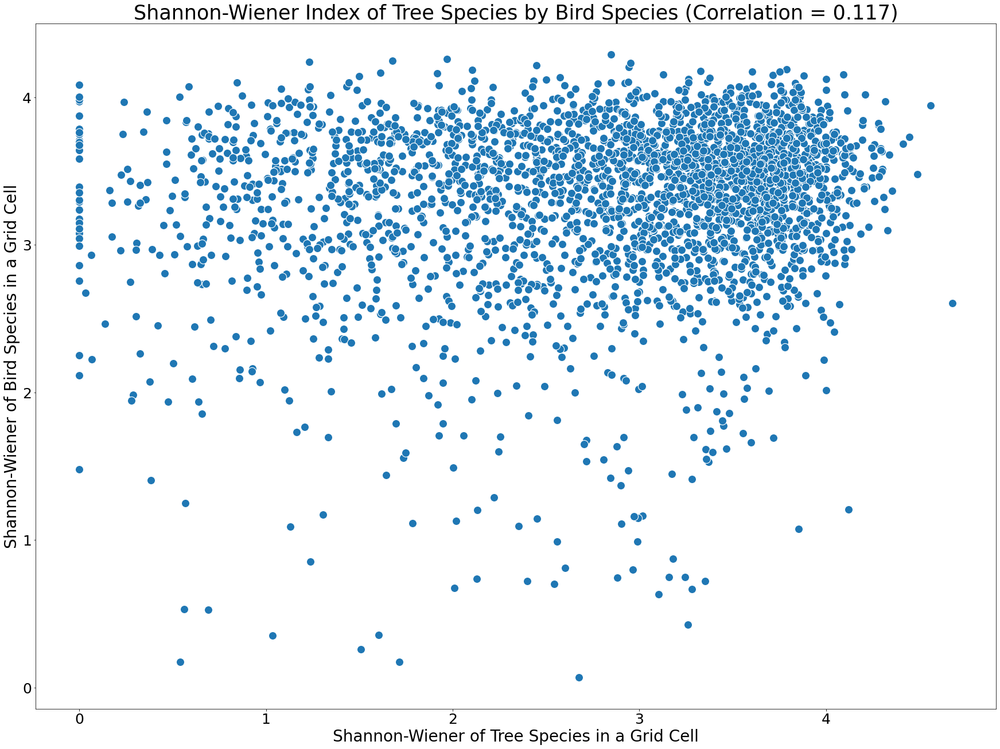

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
sns.scatterplot(ax=ax, data=sw_tree_bird, x='Shannon-Wiener_x',
                y='Shannon-Wiener_y', s=200)
ax.set_xlabel('Shannon-Wiener of Tree Species in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Shannon-Wiener of Bird Species in a Grid Cell', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Shannon-Wiener Index of Tree Species by Bird Species (Correlation = 0.117)', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

# Population Grid


In [ ]:
%%bigquery --project urban-forest-269703 pop_grid
SELECT *
FROM `urban-forest-269703.pop_grid.ca-pop-grid`

In [ ]:
pop_grid

,ID,Population,climateID,geometry
0,25520.0,0.0,1,"POLYGON((-119.60874269212 34.5819106405621, -1..."
1,25791.0,0.0,1,"POLYGON((-119.5527897484 34.6142150876808, -11..."
2,25923.0,0.0,1,"POLYGON((-119.52481327654 34.5334539698841, -1..."
3,25925.0,0.0,1,"POLYGON((-119.52481327654 34.5980628641215, -1..."
4,26058.0,0.0,1,"POLYGON((-119.49683680468 34.5496061934434, -1..."
...,...,...,...,...
46795,46779.0,0.0,6,"POLYGON((-114.237260095 34.3557795107312, -114..."
46796,46780.0,0.0,6,"POLYGON((-114.237260095 34.38808395785, -114.2..."
46797,46787.0,0.0,6,"POLYGON((-114.20928362314 34.3719317342906, -1..."
46798,46791.0,0.0,6,"POLYGON((-114.18130715128 34.3234750636125, -1..."


In [ ]:
from shapely import wkt
pop_grid['geom'] = pop_grid['geometry'].apply(wkt.loads)
pop_grid

,ID,Population,climateID,geometry,geom
0,25520.0,0.0,1,"POLYGON((-119.60874269212 34.5819106405621, -1...","POLYGON ((-119.60874269212 34.5819106405621, -..."
1,25791.0,0.0,1,"POLYGON((-119.5527897484 34.6142150876808, -11...","POLYGON ((-119.5527897484 34.6142150876808, -1..."
2,25923.0,0.0,1,"POLYGON((-119.52481327654 34.5334539698841, -1...","POLYGON ((-119.52481327654 34.5334539698841, -..."
3,25925.0,0.0,1,"POLYGON((-119.52481327654 34.5980628641215, -1...","POLYGON ((-119.52481327654 34.5980628641215, -..."
4,26058.0,0.0,1,"POLYGON((-119.49683680468 34.5496061934434, -1...","POLYGON ((-119.49683680468 34.5496061934434, -..."
...,...,...,...,...,...
46795,46779.0,0.0,6,"POLYGON((-114.237260095 34.3557795107312, -114...","POLYGON ((-114.237260095 34.3557795107312, -11..."
46796,46780.0,0.0,6,"POLYGON((-114.237260095 34.38808395785, -114.2...","POLYGON ((-114.237260095 34.38808395785, -114...."
46797,46787.0,0.0,6,"POLYGON((-114.20928362314 34.3719317342906, -1...","POLYGON ((-114.20928362314 34.3719317342906, -..."
46798,46791.0,0.0,6,"POLYGON((-114.18130715128 34.3234750636125, -1...","POLYGON ((-114.18130715128 34.3234750636125, -..."


In [ ]:
pop_gdf = gpd.GeoDataFrame(pop_grid.iloc[:,[0,1,4]], geometry='geom')
pop_gdf

,ID,Population,geom
0,25520.0,0.0,"POLYGON ((-119.60874 34.58191, -119.61807 34.5..."
1,25791.0,0.0,"POLYGON ((-119.55279 34.61422, -119.56212 34.6..."
2,25923.0,0.0,"POLYGON ((-119.52481 34.53345, -119.53414 34.5..."
3,25925.0,0.0,"POLYGON ((-119.52481 34.59806, -119.53414 34.6..."
4,26058.0,0.0,"POLYGON ((-119.49684 34.54961, -119.50616 34.5..."
...,...,...,...
46795,46779.0,0.0,"POLYGON ((-114.23726 34.35578, -114.24659 34.3..."
46796,46780.0,0.0,"POLYGON ((-114.23726 34.38808, -114.24659 34.4..."
46797,46787.0,0.0,"POLYGON ((-114.20928 34.37193, -114.21861 34.3..."
46798,46791.0,0.0,"POLYGON ((-114.18131 34.32348, -114.19063 34.3..."


In [ ]:
pop_gdf = pop_gdf.dropna()

In [ ]:
no_zero = pop_gdf[pop_gdf['Population']!=0]
no_zero

,ID,Population,geom
6,26724.0,2.0,"POLYGON ((-119.35695 34.46885, -119.36628 34.4..."
7,26725.0,45.0,"POLYGON ((-119.35695 34.50115, -119.36628 34.5..."
8,26856.0,20.0,"POLYGON ((-119.32898 34.42039, -119.33830 34.4..."
9,26857.0,4.0,"POLYGON ((-119.32898 34.45269, -119.33830 34.4..."
10,26858.0,4.0,"POLYGON ((-119.32898 34.48500, -119.33830 34.5..."
...,...,...,...
22371,46794.0,52.0,"POLYGON ((-114.15333 34.27502, -114.16266 34.2..."
22372,46795.0,12.0,"POLYGON ((-114.15333 34.30732, -114.16266 34.3..."
22373,46796.0,38.0,"POLYGON ((-114.15333 34.33963, -114.16266 34.3..."
22374,46797.0,53.0,"POLYGON ((-114.12535 34.25887, -114.13468 34.2..."


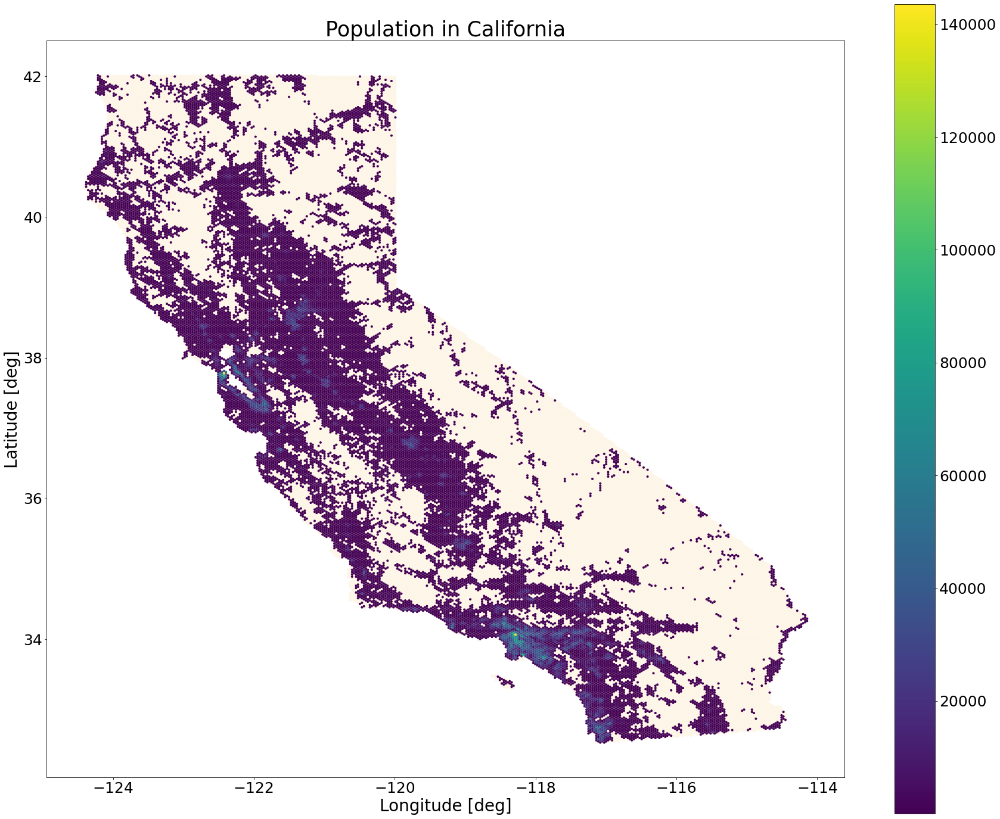

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ax2 = ca_gdf.plot(ax=ax, color='oldlace') 
no_zero.plot(ax=ax, column='Population', legend=True)
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Population in California', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


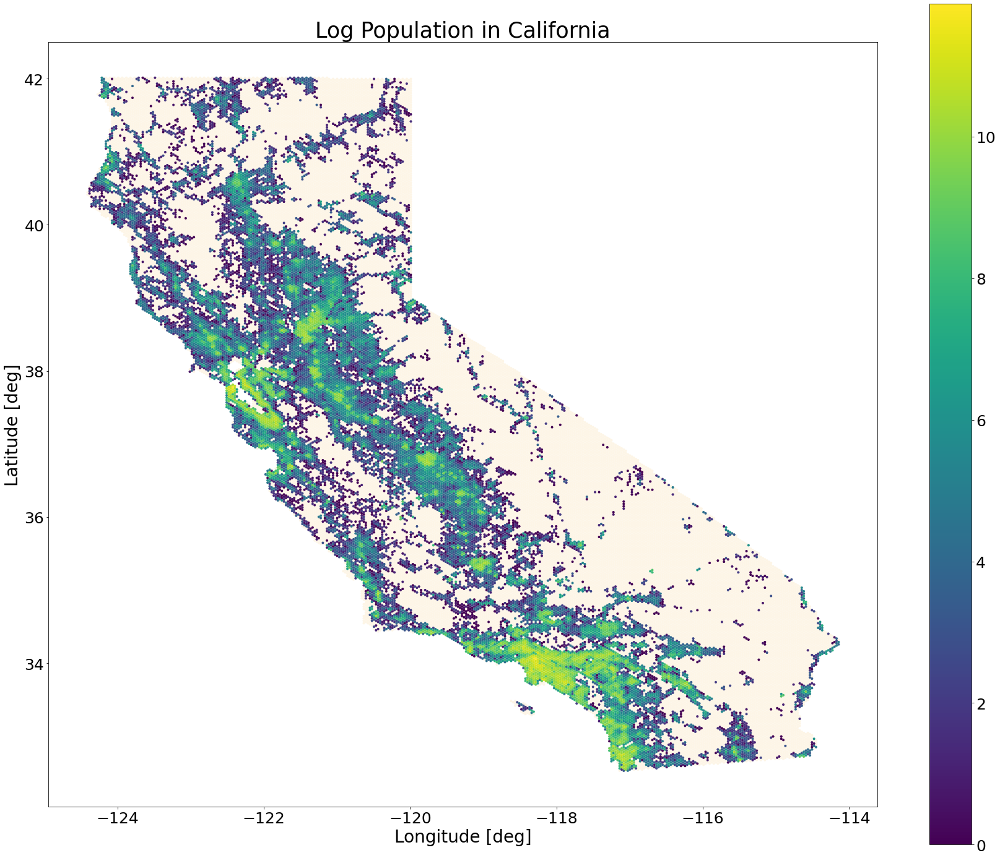

In [ ]:
no_zero['log_pop'] = np.log(no_zero['Population'])
fig, ax = plt.subplots(figsize=(30,25))
ax2 = ca_gdf.plot(ax=ax, color='oldlace') 
no_zero.plot(ax=ax, column='log_pop', legend=True)
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Log Population in California', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

# Beta Diversity 

## Neighbors

In [ ]:
import numpy
pd.options.mode.chained_assignment = None  # default='warn'

def get_neighbor_centroids(reference):
  # Filtering for the polygons that intersect with our reference polygon
  mask = (ca_gdf['geom'].intersects(reference))
  valid = ca_gdf[mask]
  # The reference instersects with itself, so drop that
  neighbors = valid[valid['geom']!=reference]
  # Getting the centroid from the polygon, to easily calculate direction
  neighbors['centroid'] = neighbors['geom'].centroid
  # Gettig the coordinates from the centroid
  neighbors['coord'] = neighbors['centroid'].apply(lambda x: (x.x, x.y))
  return neighbors

def get_neighbor_directions(neighbors, reference):
  # Subtracting the reference coordinate from each neighbors coordinate
  # Then round and get the sign of the differences
  neighbors['direction'] = neighbors['coord'].apply(
      lambda x: numpy.sign(
          numpy.around(
              numpy.subtract(
                  x, (reference.centroid.x, reference.centroid.y)
              ), 6
          )
      )
  )
  return neighbors

def get_neighbors(idx, id, reference):
    direction_dict = {}
    neighbors = get_neighbor_centroids(reference)
    neighbors = get_neighbor_directions(neighbors, reference)

    # Based on the orientation of our hexagons, there are only six
    # possible cases for directions for a hexagon's neighbors
    for row in neighbors[['ID', 'direction']].itertuples(
                                        index=True, name='Pandas'):
        direction_dict['ID'] = id
        direction_dict['geom'] = reference
        if np.array_equal(row.direction, numpy.array([1.0, -1.0])):
            direction_dict['southeast'] = row.ID
            continue
        elif np.array_equal(row.direction, numpy.array([1.0, 1.0])):
            direction_dict['northeast'] = row.ID
            continue
        elif np.array_equal(row.direction, numpy.array([-1.0, 1.0])):
            direction_dict['northwest'] = row.ID
            continue
        elif np.array_equal(row.direction, numpy.array([-1.0, -1.0])):
            direction_dict['southwest'] = row.ID
            continue
        elif np.array_equal(row.direction, numpy.array([0.0, 1.0])):
            direction_dict['north'] = row.ID
            continue
        elif np.array_equal(row.direction, numpy.array([0.0, -1.0])):
            direction_dict['south'] = row.ID
            continue

    return pd.DataFrame(direction_dict, index=[idx], dtype=object)

# Using itertuples to iterative get the ID's of the neighbors in each direction 
neighbors_df = pd.DataFrame()
for row in ca_gdf.itertuples(index=True, name='Pandas'):
    neighbors = get_neighbors(row.Index, row.ID, row.geom)
    neighbors_df = neighbors_df.append(neighbors)
neighbors_df

,ID,geom,southeast,southwest,south,northwest,north,northeast
0,24698,"POLYGON ((-119.77660152328 34.6788239819182, -...",24837,24558,24697,24559,24699,24838
1,24834,"POLYGON ((-119.74862505142 34.5657584170028, -...",24972,24694,24833,24695,24835,24973
2,24837,"POLYGON ((-119.74862505142 34.6626717583589, -...",24975,24697,24836,24698,24838,24976
3,25110,"POLYGON ((-119.6926721077 34.5657584170028, -1...",25247,24972,25109,24973,25111,25248
4,25248,"POLYGON ((-119.66469563584 34.5819106405621, -...",25384,25110,25247,25111,25249,25385
...,...,...,...,...,...,...,...,...
46795,46795,"POLYGON ((-114.15333067942 34.3073228400532, -...",46798,46790,NaN,46791,46796,46799
46796,46796,"POLYGON ((-114.15333067942 34.3396272871719, -...",46799,46791,46795,46792,NaN,NaN
46797,46797,"POLYGON ((-114.12535420756 34.2588661693752, -...",NaN,46793,NaN,46794,46798,NaN
46798,46798,"POLYGON ((-114.12535420756 34.2911706164938, -...",NaN,46794,46797,46795,46799,NaN


In [ ]:
neighbors_df.isna().sum()

ID              0
geom            0
southeast     315
southwest     502
south        3460
northwest     315
north        3460
northeast     502
dtype: int64

In [ ]:
neighbors_df.dtypes

ID           object
geom         object
southeast    object
southwest    object
south        object
northwest    object
north        object
northeast    object
dtype: object

In [ ]:
neighbors_df['ID'] = pd.to_numeric(neighbors_df['ID'])
neighbors_df['southeast'] = pd.to_numeric(neighbors_df['southeast'])
neighbors_df['southwest'] = pd.to_numeric(neighbors_df['southwest'])
neighbors_df['south'] = pd.to_numeric(neighbors_df['south'])
neighbors_df['northwest'] = pd.to_numeric(neighbors_df['northwest'])
neighbors_df['north'] = pd.to_numeric(neighbors_df['north'])
neighbors_df['northeast'] = pd.to_numeric(neighbors_df['northeast'])

In [ ]:
neighbors_df.dtypes

ID             int64
geom          object
southeast    float64
southwest    float64
south        float64
northwest    float64
north        float64
northeast    float64
dtype: object

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='grid.ca-grid-neighbors'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
neighbors_df.to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

5it [00:47,  9.51s/it]


## Tree Beta Diversity Richness 

In [ ]:
%%bigquery --project urban-forest-269703 ca_grid
SELECT *
FROM `urban-forest-269703.grid.ca-grid-hexagons`

In [ ]:
from shapely import wkt
ca_grid['geom'] = ca_grid['geometry'].apply(wkt.loads)
ca_grid

,ID,climateID,geometry,geom
0,24698,1,"POLYGON((-119.77660152328 34.6788239819182, -1...","POLYGON ((-119.77660152328 34.6788239819182, -..."
1,24834,1,"POLYGON((-119.74862505142 34.5657584170028, -1...","POLYGON ((-119.74862505142 34.5657584170028, -..."
2,24837,1,"POLYGON((-119.74862505142 34.6626717583589, -1...","POLYGON ((-119.74862505142 34.6626717583589, -..."
3,25110,1,"POLYGON((-119.6926721077 34.5657584170028, -11...","POLYGON ((-119.6926721077 34.5657584170028, -1..."
4,25248,1,"POLYGON((-119.66469563584 34.5819106405621, -1...","POLYGON ((-119.66469563584 34.5819106405621, -..."
...,...,...,...,...
46795,46795,6,"POLYGON((-114.15333067942 34.3073228400532, -1...","POLYGON ((-114.15333067942 34.3073228400532, -..."
46796,46796,6,"POLYGON((-114.15333067942 34.3396272871719, -1...","POLYGON ((-114.15333067942 34.3396272871719, -..."
46797,46797,6,"POLYGON((-114.12535420756 34.2588661693752, -1...","POLYGON ((-114.12535420756 34.2588661693752, -..."
46798,46798,6,"POLYGON((-114.12535420756 34.2911706164938, -1...","POLYGON ((-114.12535420756 34.2911706164938, -..."


In [ ]:
ca_gdf = gpd.GeoDataFrame(ca_grid.iloc[:,[0,3]], geometry='geom')
ca_gdf

,ID,geom
0,24698,"POLYGON ((-119.77660 34.67882, -119.78593 34.6..."
1,24834,"POLYGON ((-119.74863 34.56576, -119.75795 34.5..."
2,24837,"POLYGON ((-119.74863 34.66267, -119.75795 34.6..."
3,25110,"POLYGON ((-119.69267 34.56576, -119.70200 34.5..."
4,25248,"POLYGON ((-119.66470 34.58191, -119.67402 34.5..."
...,...,...
46795,46795,"POLYGON ((-114.15333 34.30732, -114.16266 34.3..."
46796,46796,"POLYGON ((-114.15333 34.33963, -114.16266 34.3..."
46797,46797,"POLYGON ((-114.12535 34.25887, -114.13468 34.2..."
46798,46798,"POLYGON ((-114.12535 34.29117, -114.13468 34.3..."


In [ ]:
%%bigquery --project urban-forest-269703 neighbors_df
SELECT *
FROM `urban-forest-269703.grid.ca-grid-neighbors`

In [ ]:
neighbors_df

,ID,geom,southeast,southwest,south,northwest,north,northeast
0,27256,"POLYGON ((-119.24504855794 34.3719317342906, -...",27391.0,27121.0,NaN,27122.0,27257.0,27392.0
1,27527,"POLYGON ((-119.18909561422 34.3719317342906, -...",27661.0,27391.0,NaN,27392.0,27528.0,27662.0
2,27796,"POLYGON ((-119.1331426705 34.3719317342906, -1...",27930.0,27661.0,NaN,27662.0,27797.0,27931.0
3,28065,"POLYGON ((-119.07718972678 34.3719317342906, -...",28198.0,27930.0,NaN,27931.0,28066.0,28199.0
4,28332,"POLYGON ((-119.02123678306 34.3719317342906, -...",28465.0,28198.0,NaN,28199.0,28333.0,28466.0
...,...,...,...,...,...,...,...,...
46795,29376,"POLYGON ((-118.79742500818 33.9842783688662, -...",NaN,NaN,NaN,NaN,29377.0,29507.0
46796,30523,"POLYGON ((-118.54563676144 33.418950544289, -1...",NaN,NaN,NaN,NaN,30524.0,30650.0
46797,36388,"POLYGON ((-117.23074258402 32.6597960369996, -...",NaN,NaN,NaN,NaN,36389.0,36525.0
46798,36929,"POLYGON ((-117.11883669658 32.5305782485248, -...",NaN,NaN,NaN,NaN,36930.0,37067.0


In [ ]:
long_df = pd.melt(neighbors_df, id_vars='ID', 
        value_vars=['southeast', 'southwest', 'south', 'northwest', 'north', 'northeast'],
        var_name='direction')
long_df

,ID,direction,value
0,27256,southeast,27391.0
1,27527,southeast,27661.0
2,27796,southeast,27930.0
3,28065,southeast,28198.0
4,28332,southeast,28465.0
...,...,...,...
280795,29376,northeast,29507.0
280796,30523,northeast,30650.0
280797,36388,northeast,36525.0
280798,36929,northeast,37067.0


In [ ]:
%%bigquery --project urban-forest-269703 df_trees
SELECT species, grid 
FROM `urban-forest-269703.urbanforest.final-with-grid`
where grid in (SELECT grid
  FROM `urban-forest-269703.urbanforest.final-with-grid`
  group by grid
  having count(grid) >= 20)
group by grid, species

In [ ]:
df_trees

,species,grid
0,Corymbia citriodora,34434
1,Handroanthus impetiginosus,33447
2,Chilopsis linearis,40551
3,Quercus douglasii,5906
4,Juniperus chinensis,37485
...,...,...
210569,Fraxinus angustifolia 'Raywood',15822
210570,Fraxinus angustifolia 'Raywood',36390
210571,Fraxinus angustifolia 'Raywood',32084
210572,Fraxinus angustifolia 'Raywood',27658


In [ ]:
beta = []
for idx, id, direction, neighbor in long_df.itertuples():
  if pd.isna(neighbor):
    beta.append(np.nan)
  else:           
    mask = df_trees[(df_trees['grid']==id) | (df_trees['grid']==neighbor)]
    beta.append(mask['species'].nunique())
long_df['beta_diversity'] = beta

In [ ]:
test = long_df.pivot(index='ID', columns='direction', values='beta_diversity')
beta_div = test[(test>0).any(axis=1)]
beta_div['avg'] = beta_div.apply(lambda x: x.mean(), axis=1)
beta_div.reset_index()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


direction,ID,north,northeast,northwest,south,southeast,southwest,avg
0,1769,NaN,3.0,0.0,0.0,0.0,0.0,0.6
1,1770,0.0,0.0,0.0,NaN,3.0,0.0,0.6
2,1870,3.0,0.0,0.0,0.0,0.0,0.0,0.5
3,1871,3.0,3.0,3.0,3.0,3.0,3.0,3.0
4,1872,0.0,0.0,0.0,3.0,0.0,0.0,0.5
...,...,...,...,...,...,...,...,...
5245,46515,0.0,0.0,0.0,0.0,15.0,0.0,2.5
5246,46565,15.0,15.0,15.0,NaN,15.0,15.0,15.0
5247,46566,0.0,0.0,0.0,15.0,0.0,0.0,2.5
5248,46607,0.0,NaN,15.0,NaN,NaN,0.0,5.0


In [ ]:
tree_beta = neighbors_df[['ID','geom']].merge(
    beta_div.reset_index(), how='right', left_on='ID', right_on='ID')
tree_beta['geometry'] = tree_beta['geom'].apply(wkt.loads)
tree_beta_gdf = gpd.GeoDataFrame(tree_beta, geometry='geometry')
tree_beta_gdf

,ID,geom,north,northeast,northwest,south,southeast,southwest,avg,geometry
0,1769,"POLYGON ((-123.55342522438 40.7036033695553, -...",NaN,3.0,0.0,0.0,0.0,0.0,0.6,"POLYGON ((-123.55343 40.70360, -123.56275 40.7..."
1,1770,"POLYGON ((-123.55342522438 40.735907816674, -1...",0.0,0.0,0.0,NaN,3.0,0.0,0.6,"POLYGON ((-123.55343 40.73591, -123.56275 40.7..."
2,1870,"POLYGON ((-123.52544875252 40.687451145996, -1...",3.0,0.0,0.0,0.0,0.0,0.0,0.5,"POLYGON ((-123.52545 40.68745, -123.53477 40.7..."
3,1871,"POLYGON ((-123.52544875252 40.7197555931147, -...",3.0,3.0,3.0,3.0,3.0,3.0,3.0,"POLYGON ((-123.52545 40.71976, -123.53477 40.7..."
4,1872,"POLYGON ((-123.52544875252 40.7520600402334, -...",0.0,0.0,0.0,3.0,0.0,0.0,0.5,"POLYGON ((-123.52545 40.75206, -123.53477 40.7..."
...,...,...,...,...,...,...,...,...,...,...
5245,46515,"POLYGON ((-114.54500128546 33.6935383447979, -...",0.0,0.0,0.0,0.0,15.0,0.0,2.5,"POLYGON ((-114.54500 33.69354, -114.55433 33.7..."
5246,46565,"POLYGON ((-114.5170248136 33.6773861212386, -1...",15.0,15.0,15.0,NaN,15.0,15.0,15.0,"POLYGON ((-114.51702 33.67739, -114.52635 33.6..."
5247,46566,"POLYGON ((-114.5170248136 33.7096905683573, -1...",0.0,0.0,0.0,15.0,0.0,0.0,2.5,"POLYGON ((-114.51702 33.70969, -114.52635 33.7..."
5248,46607,"POLYGON ((-114.48904834174 33.6612338976793, -...",0.0,NaN,15.0,NaN,NaN,0.0,5.0,"POLYGON ((-114.48905 33.66123, -114.49837 33.6..."


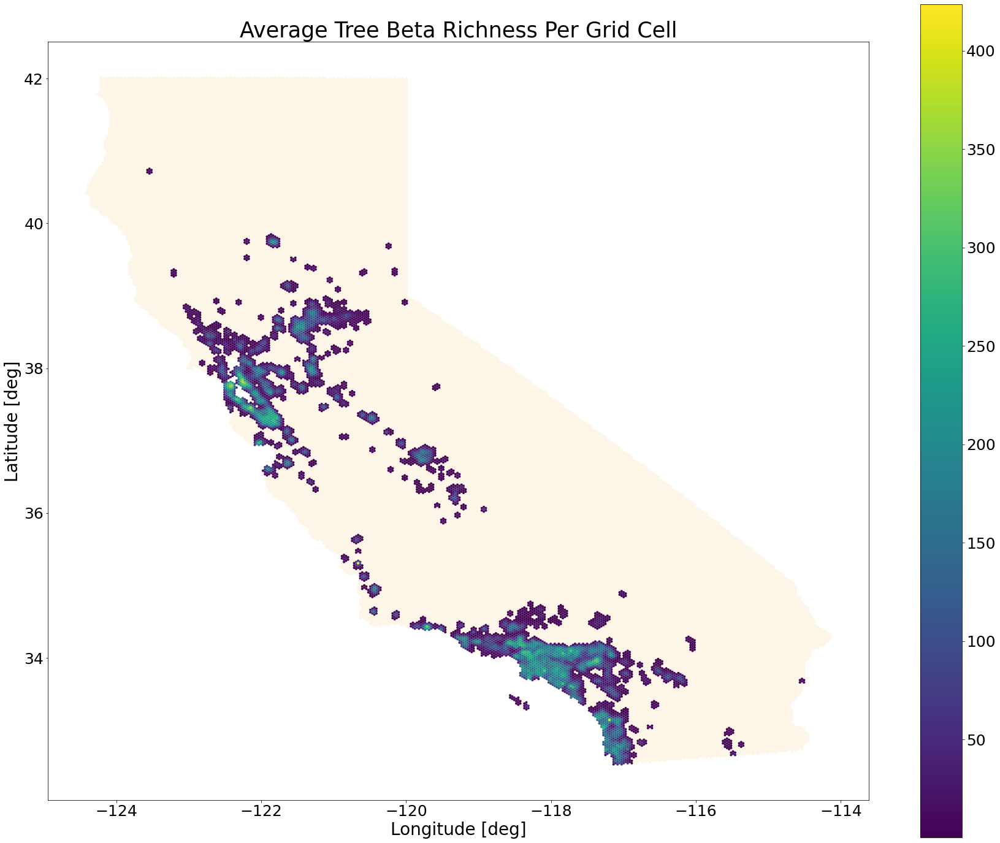

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = tree_beta_gdf.plot(ax=ax, column=tree_beta_gdf['avg'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Tree Beta Richness Per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.beta_richness_tree'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
tree_beta_gdf.drop('geom', axis=1).to_gbq(
    BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:06,  6.16s/it]


## Bird Beta Diversity Richness 

In [ ]:
%%bigquery --project urban-forest-269703 df_birds
SELECT grid, verbatimScientificName as species
FROM `urban-forest-269703.ebird.ebird-final`
where grid in(SELECT grid
  FROM `urban-forest-269703.ebird.ebird-final`
  group by grid
  having sum(individualCount) >= 80)
group by grid, verbatimScientificName

In [ ]:
df_birds

,grid,species
0,7903,Accipiter striatus
1,7295,Accipiter striatus
2,5507,Accipiter striatus
3,31964,Accipiter striatus
4,31434,Accipiter striatus
...,...,...
1588319,37782,Pheucticus melanocephalus
1588320,37208,Pheucticus melanocephalus
1588321,41131,Pheucticus melanocephalus
1588322,10748,Pheucticus melanocephalus


In [ ]:
beta = []
for idx, id, direction, neighbor in long_df.itertuples():
  if pd.isna(neighbor):
    beta.append(np.nan)
  else:           
    mask = df_birds[(df_birds['grid']==id) | (df_birds['grid']==neighbor)]
    beta.append(mask['species'].nunique())
long_df['beta_diversity'] = beta

In [ ]:
test = long_df.pivot(index='ID', columns='direction', values='beta_diversity')
beta_div = test[(test>0).any(axis=1)]
beta_div['avg'] = beta_div.apply(lambda x: x.mean(), axis=1)
beta_div.reset_index()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


direction,ID,north,northeast,northwest,south,southeast,southwest,avg
0,0,87.0,123.0,NaN,NaN,100.0,NaN,103.333333
1,1,NaN,129.0,NaN,87.0,105.0,NaN,107.000000
2,2,120.0,55.0,100.0,NaN,140.0,NaN,103.750000
3,3,167.0,105.0,105.0,120.0,105.0,123.0,120.833333
4,4,129.0,144.0,NaN,167.0,129.0,129.0,139.600000
...,...,...,...,...,...,...,...,...
36089,46795,105.0,96.0,96.0,NaN,205.0,96.0,119.600000
36090,46796,NaN,NaN,110.0,105.0,44.0,44.0,75.750000
36091,46797,206.0,NaN,94.0,NaN,NaN,171.0,157.000000
36092,46798,203.0,NaN,205.0,206.0,NaN,203.0,204.250000


In [ ]:
bird_beta = neighbors_df[['ID','geom']].merge(
    beta_div.reset_index(), how='right', left_on='ID', right_on='ID')
bird_beta['geometry'] = bird_beta['geom'].apply(wkt.loads)
bird_beta_gdf = gpd.GeoDataFrame(bird_beta, geometry='geometry')
bird_beta_gdf

,ID,geom,north,northeast,northwest,south,southeast,southwest,avg,geometry
0,0,"POLYGON ((-124.39271938018 40.412863345487, -1...",87.0,123.0,NaN,NaN,100.0,NaN,103.333333,"POLYGON ((-124.39272 40.41286, -124.40204 40.4..."
1,1,"POLYGON ((-124.39271938018 40.4451677926057, -...",NaN,129.0,NaN,87.0,105.0,NaN,107.000000,"POLYGON ((-124.39272 40.44517, -124.40204 40.4..."
2,2,"POLYGON ((-124.36474290832 40.3967111219277, -...",120.0,55.0,100.0,NaN,140.0,NaN,103.750000,"POLYGON ((-124.36474 40.39671, -124.37407 40.4..."
3,3,"POLYGON ((-124.36474290832 40.4290155690464, -...",167.0,105.0,105.0,120.0,105.0,123.0,120.833333,"POLYGON ((-124.36474 40.42902, -124.37407 40.4..."
4,4,"POLYGON ((-124.36474290832 40.4613200161651, -...",129.0,144.0,NaN,167.0,129.0,129.0,139.600000,"POLYGON ((-124.36474 40.46132, -124.37407 40.4..."
...,...,...,...,...,...,...,...,...,...,...
36089,46795,"POLYGON ((-114.15333067942 34.3073228400532, -...",105.0,96.0,96.0,NaN,205.0,96.0,119.600000,"POLYGON ((-114.15333 34.30732, -114.16266 34.3..."
36090,46796,"POLYGON ((-114.15333067942 34.3396272871719, -...",NaN,NaN,110.0,105.0,44.0,44.0,75.750000,"POLYGON ((-114.15333 34.33963, -114.16266 34.3..."
36091,46797,"POLYGON ((-114.12535420756 34.2588661693752, -...",206.0,NaN,94.0,NaN,NaN,171.0,157.000000,"POLYGON ((-114.12535 34.25887, -114.13468 34.2..."
36092,46798,"POLYGON ((-114.12535420756 34.2911706164938, -...",203.0,NaN,205.0,206.0,NaN,203.0,204.250000,"POLYGON ((-114.12535 34.29117, -114.13468 34.3..."


In [ ]:
valid_grid = set(df_birds['grid'])
valid_bird_gdf = bird_beta_gdf[bird_beta_gdf['ID'].isin(valid_grid)]
valid_bird_gdf

,ID,geom,north,northeast,northwest,south,southeast,southwest,avg,geometry
0,0,"POLYGON ((-124.39271938018 40.412863345487, -1...",87.0,123.0,NaN,NaN,100.0,NaN,103.333333,"POLYGON ((-124.39272 40.41286, -124.40204 40.4..."
2,2,"POLYGON ((-124.36474290832 40.3967111219277, -...",120.0,55.0,100.0,NaN,140.0,NaN,103.750000,"POLYGON ((-124.36474 40.39671, -124.37407 40.4..."
3,3,"POLYGON ((-124.36474290832 40.4290155690464, -...",167.0,105.0,105.0,120.0,105.0,123.0,120.833333,"POLYGON ((-124.36474 40.42902, -124.37407 40.4..."
4,4,"POLYGON ((-124.36474290832 40.4613200161651, -...",129.0,144.0,NaN,167.0,129.0,129.0,139.600000,"POLYGON ((-124.36474 40.46132, -124.37407 40.4..."
7,7,"POLYGON ((-124.33676643646 40.2513411098935, -...",195.0,91.0,NaN,NaN,98.0,NaN,128.000000,"POLYGON ((-124.33677 40.25134, -124.34609 40.2..."
...,...,...,...,...,...,...,...,...,...,...
36087,46793,"POLYGON ((-114.15333067942 34.2427139458158, -...",167.0,171.0,167.0,NaN,NaN,176.0,170.250000,"POLYGON ((-114.15333 34.24271, -114.16266 34.2..."
36089,46795,"POLYGON ((-114.15333067942 34.3073228400532, -...",105.0,96.0,96.0,NaN,205.0,96.0,119.600000,"POLYGON ((-114.15333 34.30732, -114.16266 34.3..."
36090,46796,"POLYGON ((-114.15333067942 34.3396272871719, -...",NaN,NaN,110.0,105.0,44.0,44.0,75.750000,"POLYGON ((-114.15333 34.33963, -114.16266 34.3..."
36091,46797,"POLYGON ((-114.12535420756 34.2588661693752, -...",206.0,NaN,94.0,NaN,NaN,171.0,157.000000,"POLYGON ((-114.12535 34.25887, -114.13468 34.2..."


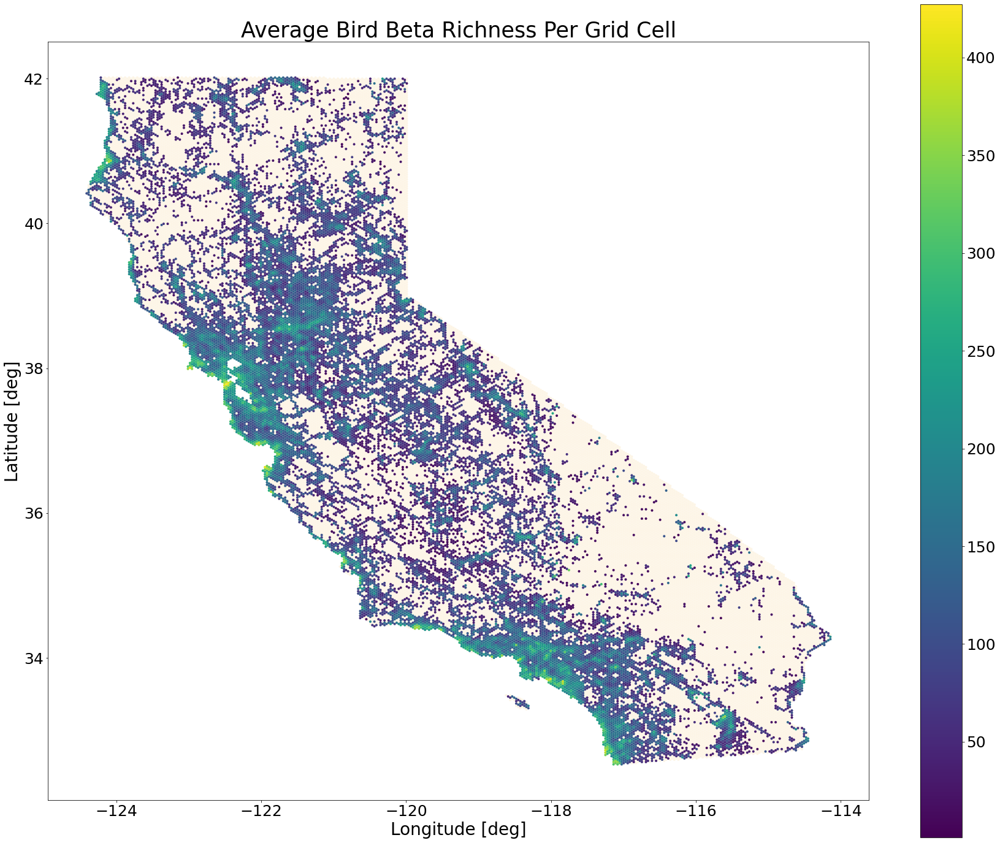

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = valid_bird_gdf.plot(ax=ax, column=valid_bird_gdf['avg'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Bird Beta Richness Per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.beta_richness_bird'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
bird_beta_gdf.drop('geom', axis=1).to_gbq(
    BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

4it [00:30,  7.66s/it]


# Proportion of Most Abundant Species

In [ ]:
%%bigquery --project urban-forest-269703 df_trees
SELECT species, count(species) as species_count, grid 
FROM `urban-forest-269703.urbanforest.final-with-grid`
where grid in (SELECT grid
  FROM `urban-forest-269703.urbanforest.final-with-grid`
  group by grid
  having count(grid) >= 10)
group by grid, species

In [ ]:
df_trees

,species,species_count,grid
0,Citrus limon,122,8661
1,Brahea armata,85,8661
2,x Chitalpa tashkentensis,69,9841
3,Robinia pseudoacacia,120,37755
4,Prunus serrulata,49,11262
...,...,...,...
211187,Ulmus parvifolia,27,18791
211188,Schinus molle,27,33444
211189,Alnus cordata,27,12424
211190,Rhamnus alaternus,27,6285


In [ ]:
%%bigquery --project urban-forest-269703 tree_count
SELECT grid, count(grid) as count
FROM `urban-forest-269703.urbanforest.final-with-grid`
group by grid
having count(grid) >= 10

In [ ]:
tree_count

,grid,count
0,8543,2196
1,7299,2244
2,36688,5256
3,9473,5939
4,33813,6755
...,...,...
2942,37105,18
2943,7016,14
2944,32092,14
2945,30924,12


In [ ]:
trees = df_trees.merge(tree_count, how='inner', left_on='grid', right_on='grid')
trees

,species,species_count,grid,count
0,Citrus limon,122,8661,10297
1,Brahea armata,85,8661,10297
2,Eriobotrya japonica,90,8661,10297
3,Acacia melanoxylon,54,8661,10297
4,Acer macrophyllum,46,8661,10297
...,...,...,...,...
211187,Quercus agrifolia,23,37112,23
211188,Schinus molle,24,37776,24
211189,Quercus agrifolia,25,31187,25
211190,Quercus agrifolia,26,31454,26


In [ ]:
trees['percent10'] = np.where(trees['species_count'] / trees['count'] > .1, 1, 0)
trees['percent20'] = np.where(trees['species_count'] / trees['count'] > .2, 1, 0)
trees

,species,species_count,grid,count,percent10,percent20
0,Citrus limon,122,8661,10297,0,0
1,Brahea armata,85,8661,10297,0,0
2,Eriobotrya japonica,90,8661,10297,0,0
3,Acacia melanoxylon,54,8661,10297,0,0
4,Acer macrophyllum,46,8661,10297,0,0
...,...,...,...,...,...,...
211187,Quercus agrifolia,23,37112,23,1,1
211188,Schinus molle,24,37776,24,1,1
211189,Quercus agrifolia,25,31187,25,1,1
211190,Quercus agrifolia,26,31454,26,1,1


In [ ]:
resilience = trees.groupby('grid').sum().reset_index()
resilience_df = resilience.merge(ca_gdf, how='inner', left_on='grid',right_on='ID')
resilience_gdf = gpd.GeoDataFrame(resilience_df, geometry='geom')
resilience_gdf

,grid,percent10,percent20
0,1871,3,2
1,3098,2,2
2,3102,1,1
3,3103,3,1
4,3765,4,2
...,...,...,...
2942,43724,3,2
2943,43730,3,1
2944,43815,2,0
2945,44193,4,1


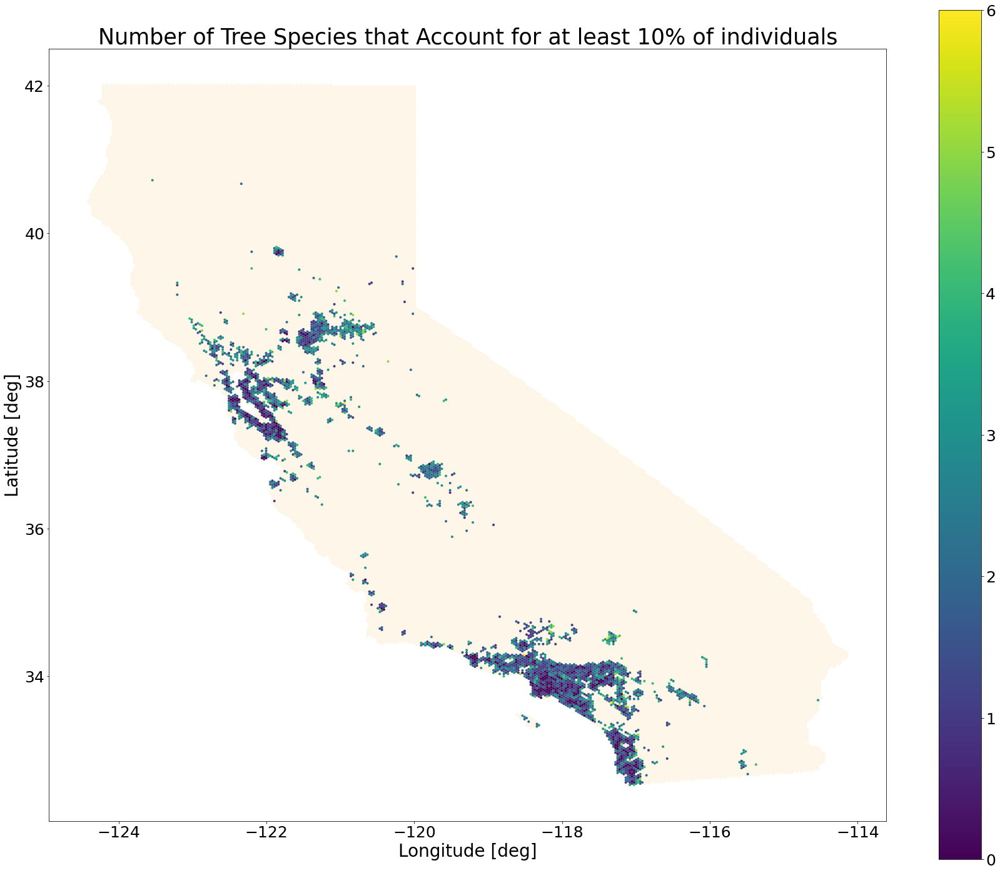

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = resilience_gdf.plot(ax=ax, column=resilience_gdf['percent10'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Number of Tree Species that Account for at least 10% of individuals', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

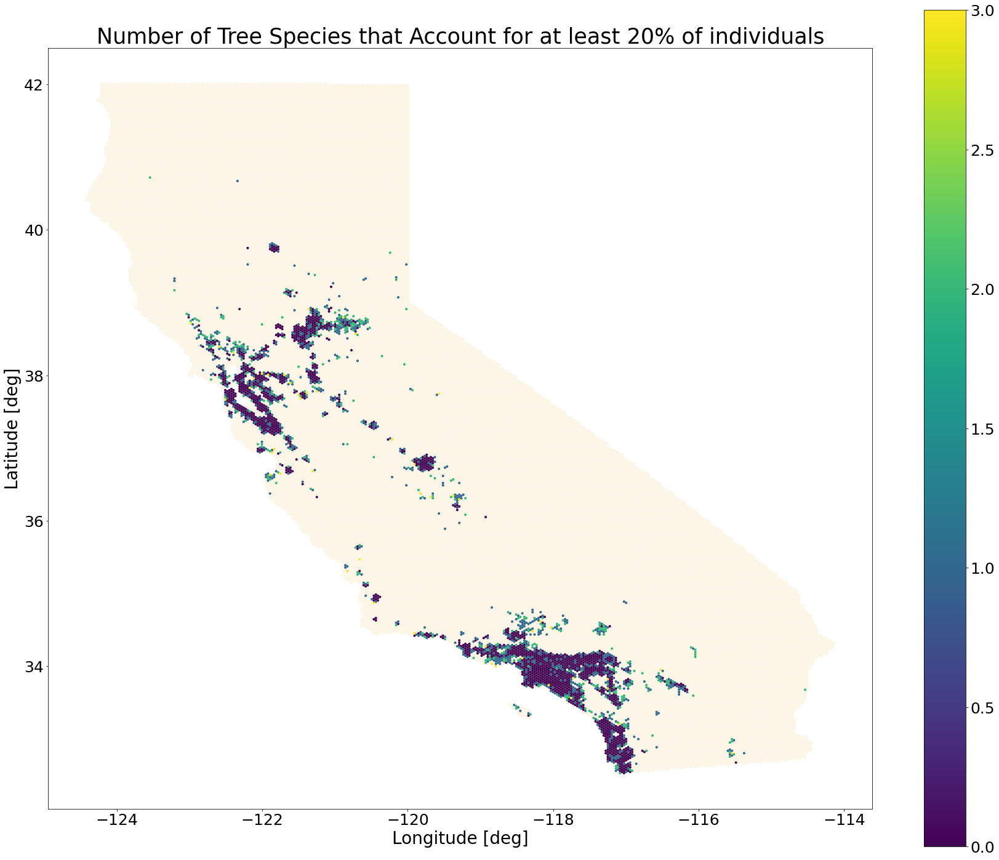

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = resilience_gdf.plot(ax=ax, column=resilience_gdf['percent20'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Number of Tree Species that Account for at least 20% of individuals', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.eco_resilience'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
resilience[['grid', 'percent10', 'percent20']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:03,  3.75s/it]


# Environmental Data

## Format into Bigquery

In [ ]:
!pip install xarray

In [ ]:
import xarray as xr
ds = xr.open_dataset('/content/drive/MyDrive/Data Science/Cal Fire Urban Forestry Tree Bird Biodiversity Project/CA Grids/tmx_wgs.nc')
ds

<xarray.Dataset>
Dimensions:          (lat: 3866, lon: 4038)
Coordinates:
  * lon              (lon) float64 -124.6 -124.6 -124.6 ... -113.1 -113.1 -113.1
  * lat              (lat) float64 43.35 43.35 43.35 43.35 ... 32.31 32.31 32.3
Data variables:
    temperature_max  (lat, lon) float32 ...
Attributes:
    Conventions:      CF-1.0
    Source_Software:  Esri ArcGIS

In [ ]:
df = ds['temperature_max'].to_dataframe().dropna().reset_index()
del ds
df

,lat,lon,temperature_max
0,43.337828,-121.652050,16.790001
1,43.334969,-121.652050,16.790001
2,43.334969,-121.649191,16.840000
3,43.334969,-121.646331,16.920000
4,43.332109,-121.654909,16.780001
...,...,...,...
6026480,32.524613,-114.807302,33.369999
6026481,32.524613,-114.804443,33.369999
6026482,32.524613,-114.801583,33.360001
6026483,32.524613,-114.798724,33.380001


In [ ]:
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.lon, df.lat))
gdf

,lat,lon,temperature_max,geometry
0,43.337828,-121.652050,16.790001,POINT (-121.65205 43.33783)
1,43.334969,-121.652050,16.790001,POINT (-121.65205 43.33497)
2,43.334969,-121.649191,16.840000,POINT (-121.64919 43.33497)
3,43.334969,-121.646331,16.920000,POINT (-121.64633 43.33497)
4,43.332109,-121.654909,16.780001,POINT (-121.65491 43.33211)
...,...,...,...,...
6026480,32.524613,-114.807302,33.369999,POINT (-114.80730 32.52461)
6026481,32.524613,-114.804443,33.369999,POINT (-114.80444 32.52461)
6026482,32.524613,-114.801583,33.360001,POINT (-114.80158 32.52461)
6026483,32.524613,-114.798724,33.380001,POINT (-114.79872 32.52461)


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='environment_data.temperature_max'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
gdf[['geometry', 'temperature_max']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=500000, if_exists='append')

13it [12:50, 59.25s/it]


## Plots

In [ ]:
ca_gdf

,ID,geom
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4..."
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4..."
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4..."
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4..."
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3..."
...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7..."
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6..."
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6..."
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7..."


In [ ]:
%%bigquery --project urban-forest-269703 environment_df
SELECT * 
FROM `urban-forest-269703.treebirdagg.environment`

In [ ]:
environment_df

,id,avg_act_evaptrans,avg_pot_evaptrans,avg_precip,avg_recharge,avg_runoff,avg_snowpack,avg_temp_max,avg_temp_min,avg_water_deficit
0,30914,77.214863,110.012844,3.971651,0.0,0.0,0.0,29.553394,16.851101,32.797982
1,46682,21.687456,110.457018,19.137456,0.0,0.0,0.0,31.942982,18.720789,88.769561
2,10205,41.914869,86.432174,1.697565,0.0,0.0,0.0,27.144348,13.417739,44.517304
3,30013,34.710431,81.636207,33.745431,0.0,0.0,0.0,17.901983,2.135517,39.859655
4,43318,36.198991,103.478899,31.122202,0.0,0.0,0.0,24.069817,13.238807,67.279908
...,...,...,...,...,...,...,...,...,...,...
46536,23055,73.139999,77.045370,49.523889,0.0,0.0,0.0,17.891111,2.677037,1.310000
46537,11983,23.100000,65.135651,19.895478,0.0,0.0,0.0,20.673217,1.596870,35.169998
46538,177,57.400002,57.400002,55.259998,0.0,0.0,0.0,19.570000,9.310000,0.000000
46539,4602,82.599998,82.599998,1.170000,0.0,0.0,0.0,23.110001,11.470000,0.000000


In [ ]:
env_gdf = ca_gdf.merge(environment_df, how='left', left_on='ID', right_on='id')
env_gdf

,ID,geom,id,avg_act_evaptrans,avg_pot_evaptrans,avg_precip,avg_recharge,avg_runoff,avg_snowpack,avg_temp_max,avg_temp_min,avg_water_deficit
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,26.907982,113.767889,6.711284,0.0,0.0,0.0,28.853486,13.378349,86.859909
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,40.279815,109.514815,5.323704,0.0,0.0,0.0,29.124815,13.952870,69.235000
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,33.015321,109.778899,4.116422,0.0,0.0,0.0,29.725963,14.657615,76.763578
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,40.111835,109.844037,4.451009,0.0,0.0,0.0,29.028440,14.107798,69.732202
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,26.124210,112.195614,3.118684,0.0,0.0,0.0,28.917456,15.665439,86.071404
...,...,...,...,...,...,...,...,...,...,...,...,...
46795,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,46.004259,116.589814,8.057963,0.0,0.0,0.0,33.582870,19.725278,70.585556
46796,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,39.423426,116.453704,8.078981,0.0,0.0,0.0,33.632870,19.402778,77.030278
46797,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,53.263158,116.034211,8.439211,0.0,0.0,0.0,33.729386,19.302807,62.771053
46798,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,50.702660,116.632111,8.536147,0.0,0.0,0.0,33.702385,19.424587,65.929450


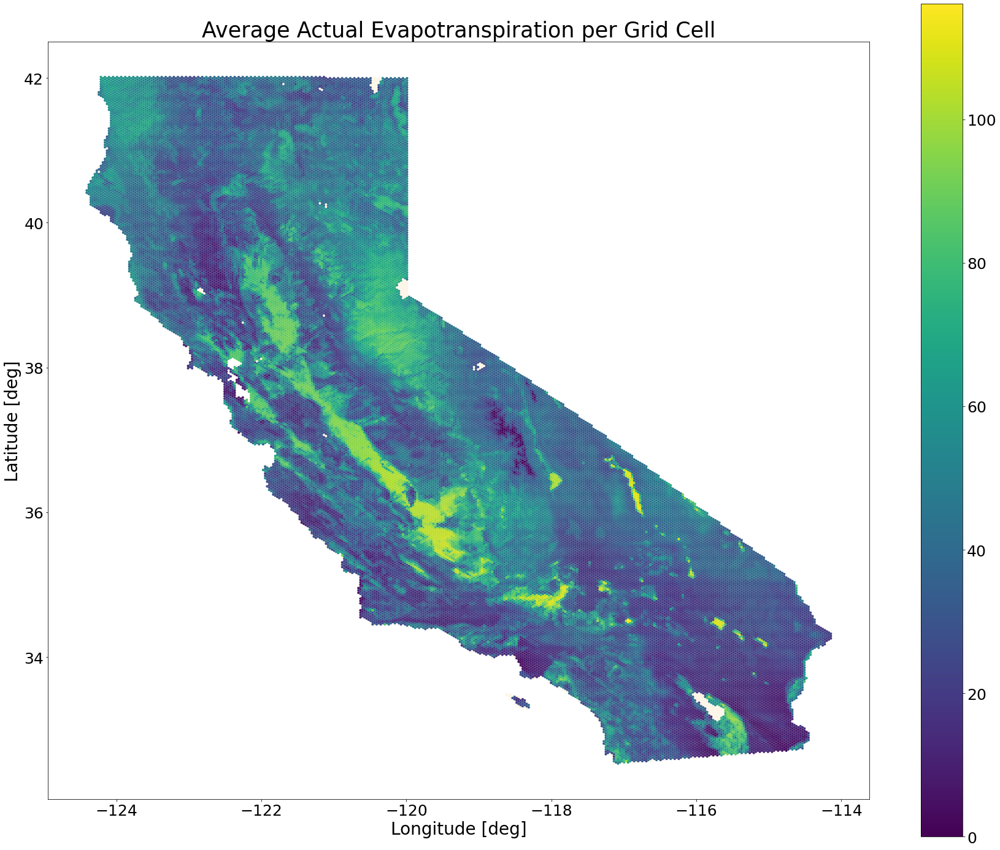

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_act_evaptrans'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Actual Evapotranspiration per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

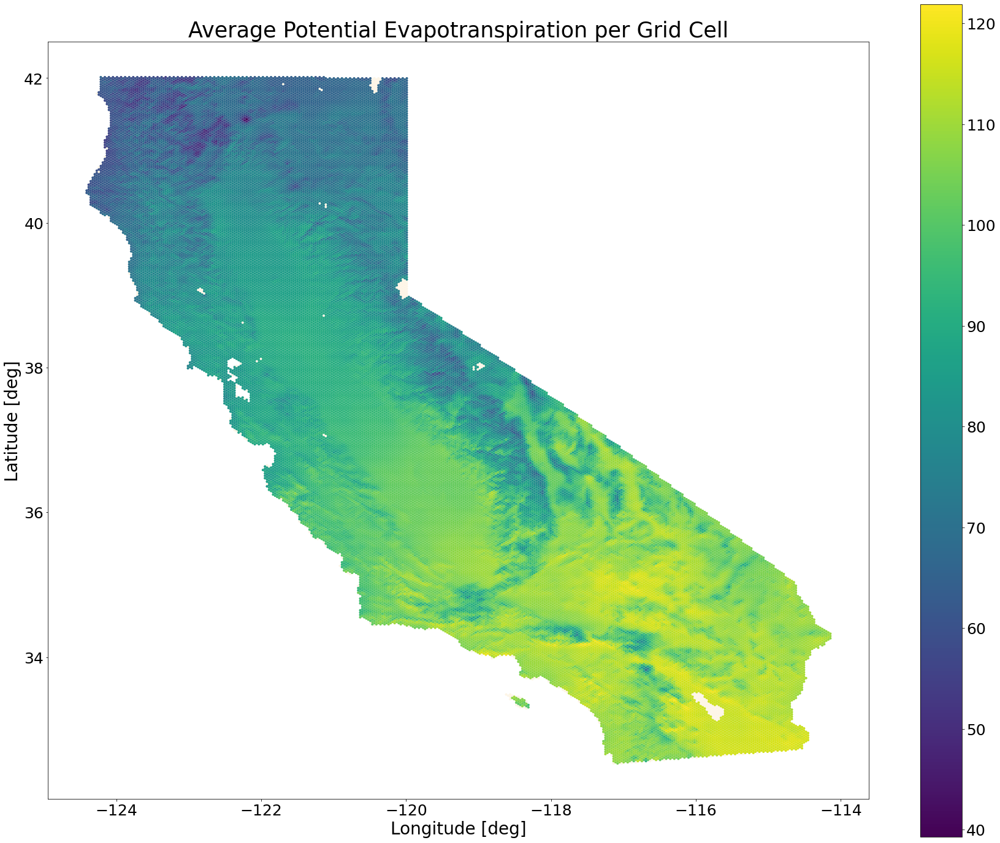

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_pot_evaptrans'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Potential Evapotranspiration per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

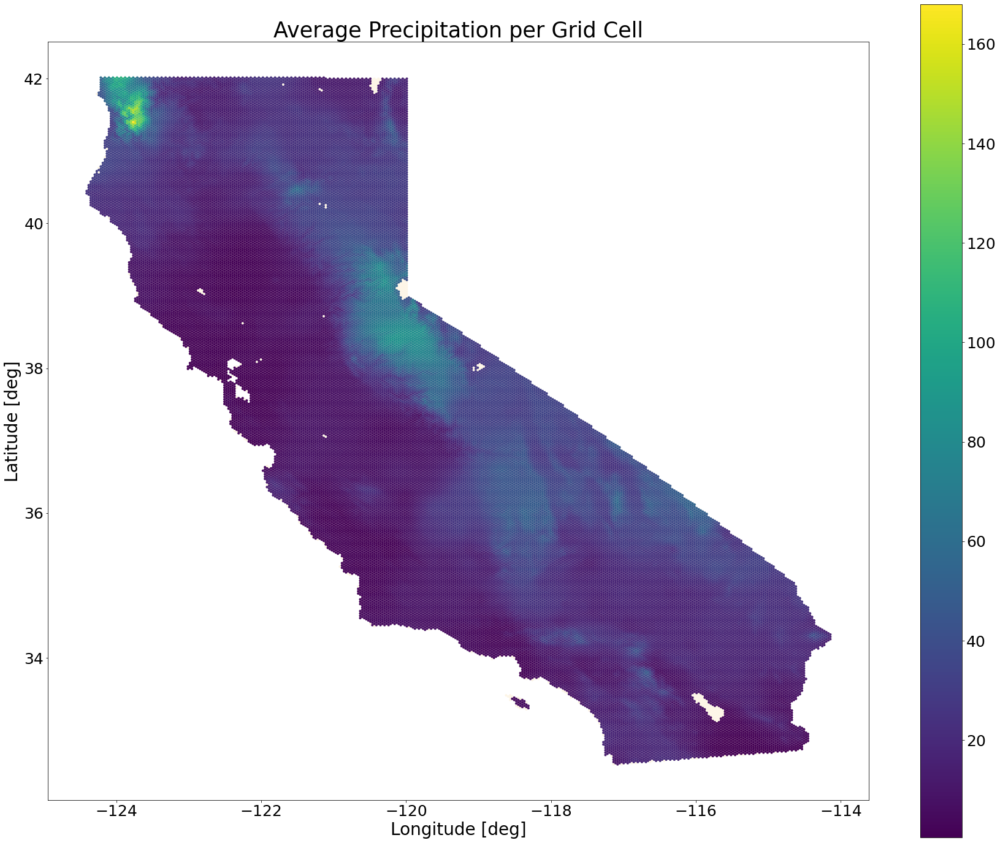

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_precip'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Precipitation per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

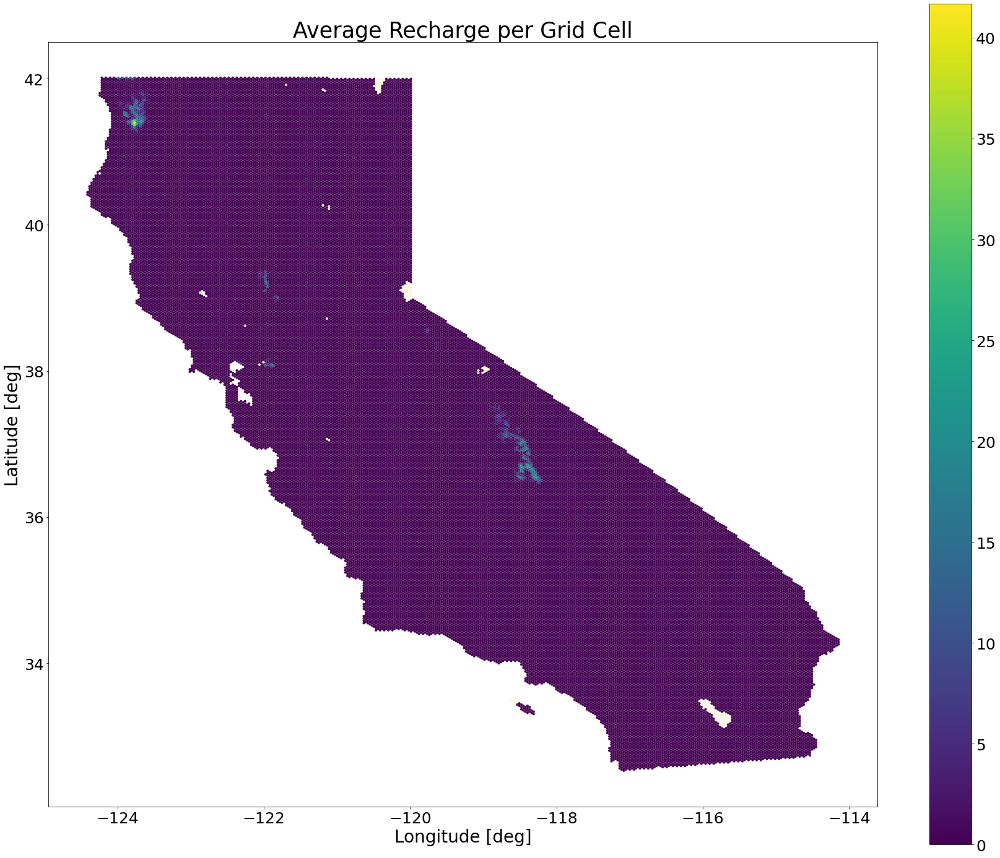

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_recharge'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Recharge per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

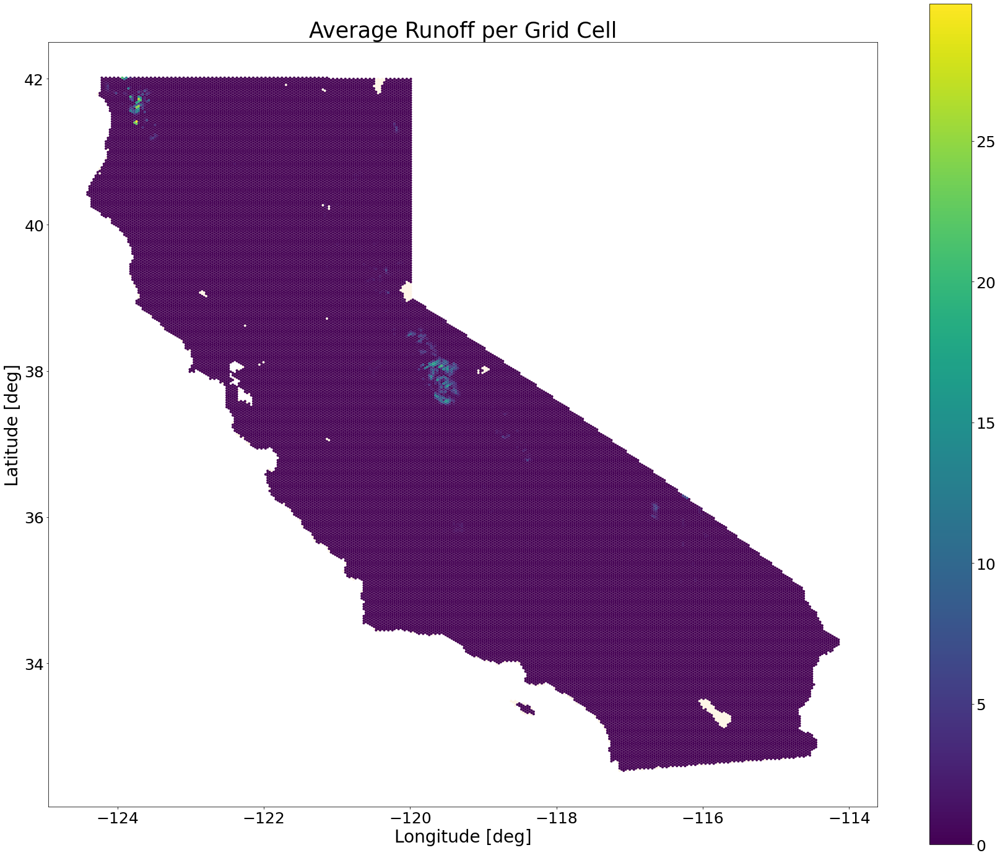

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_runoff'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Runoff per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

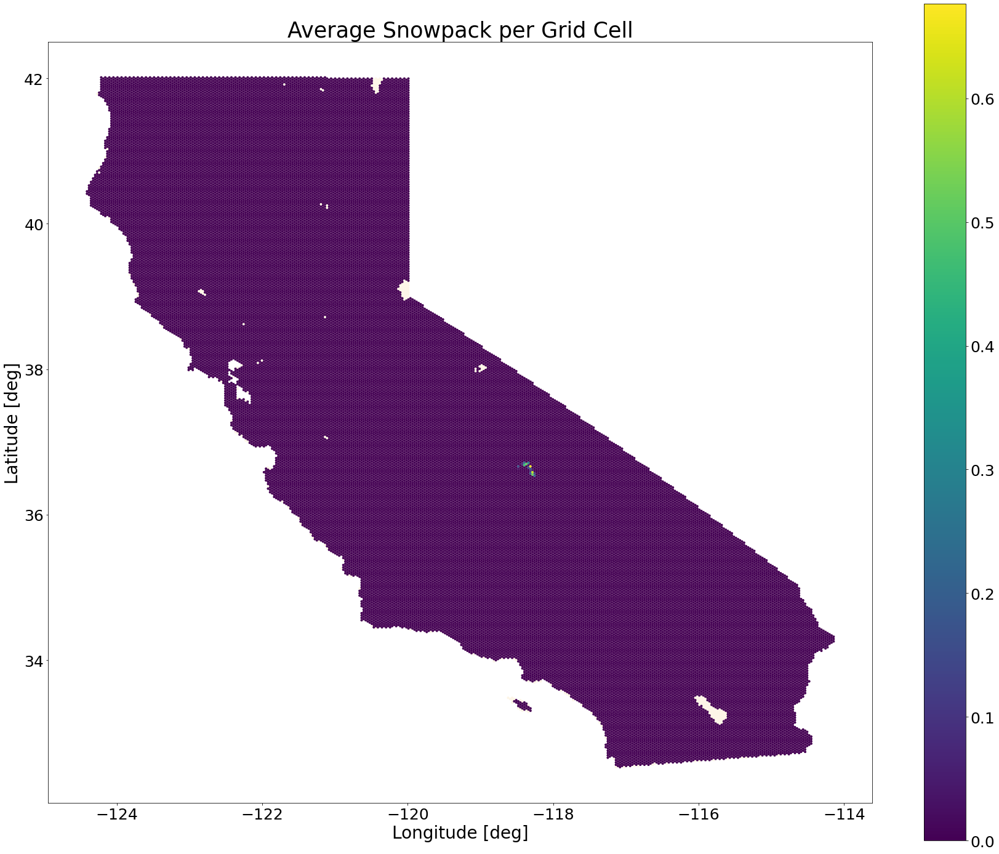

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_snowpack'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Snowpack per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

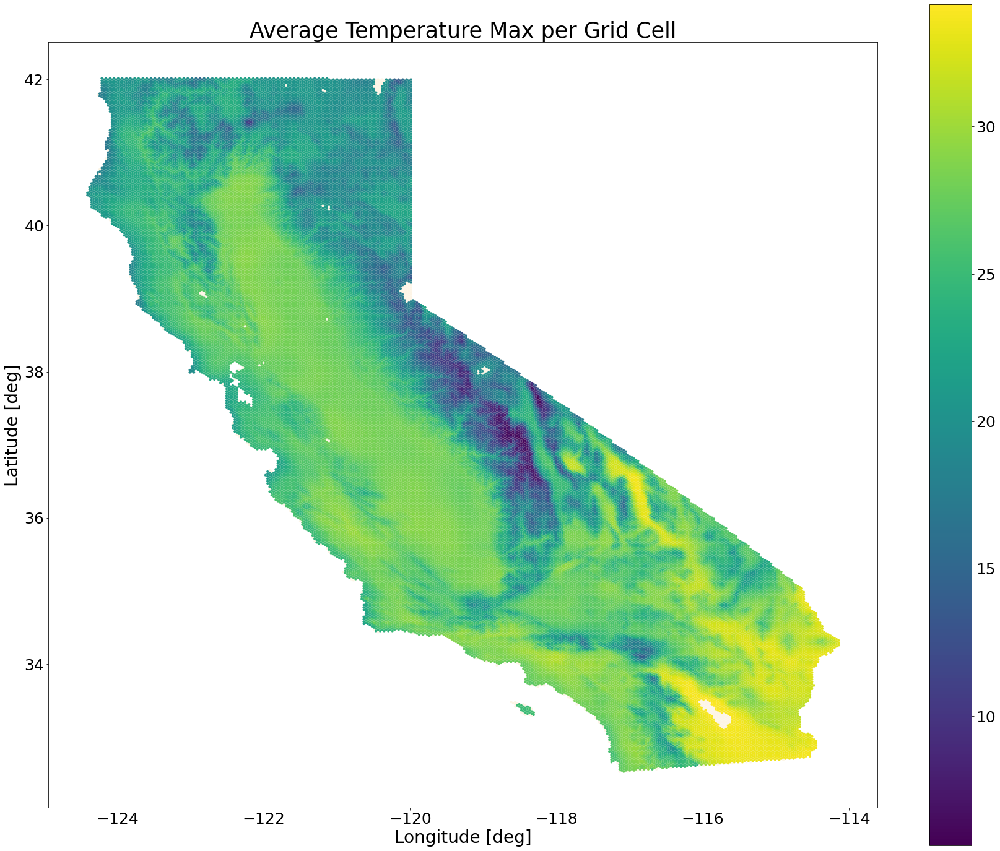

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_temp_max'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Temperature Max per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

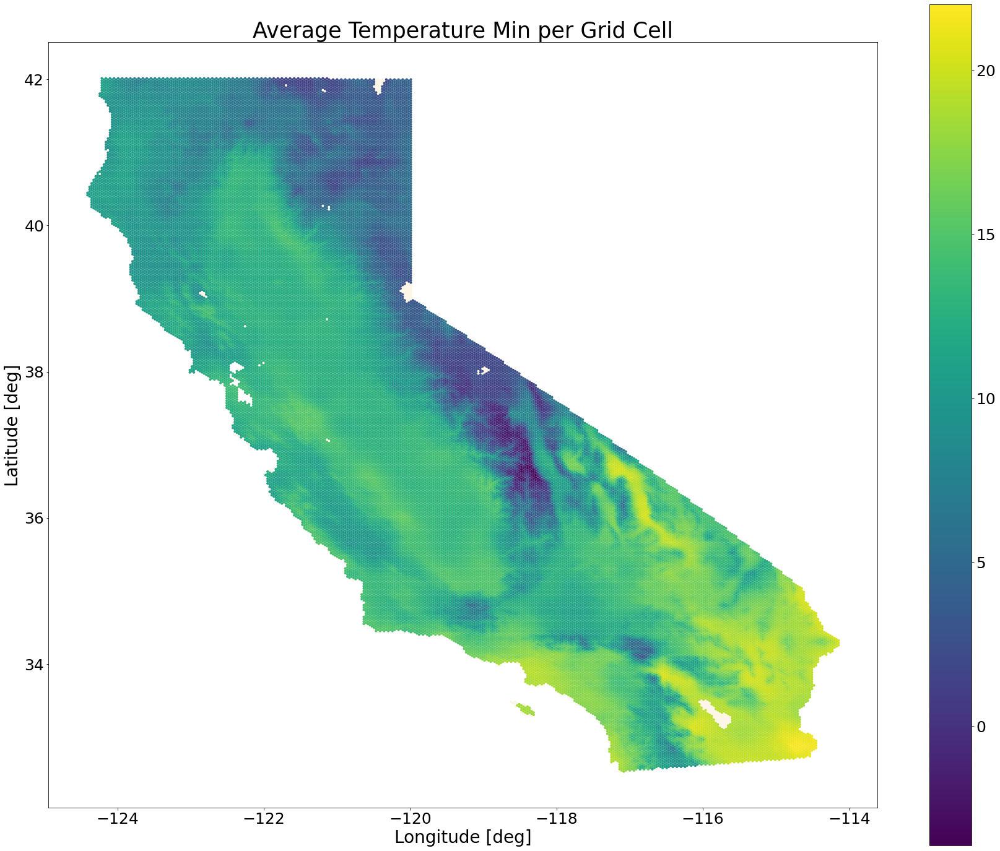

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_temp_min'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Temperature Min per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

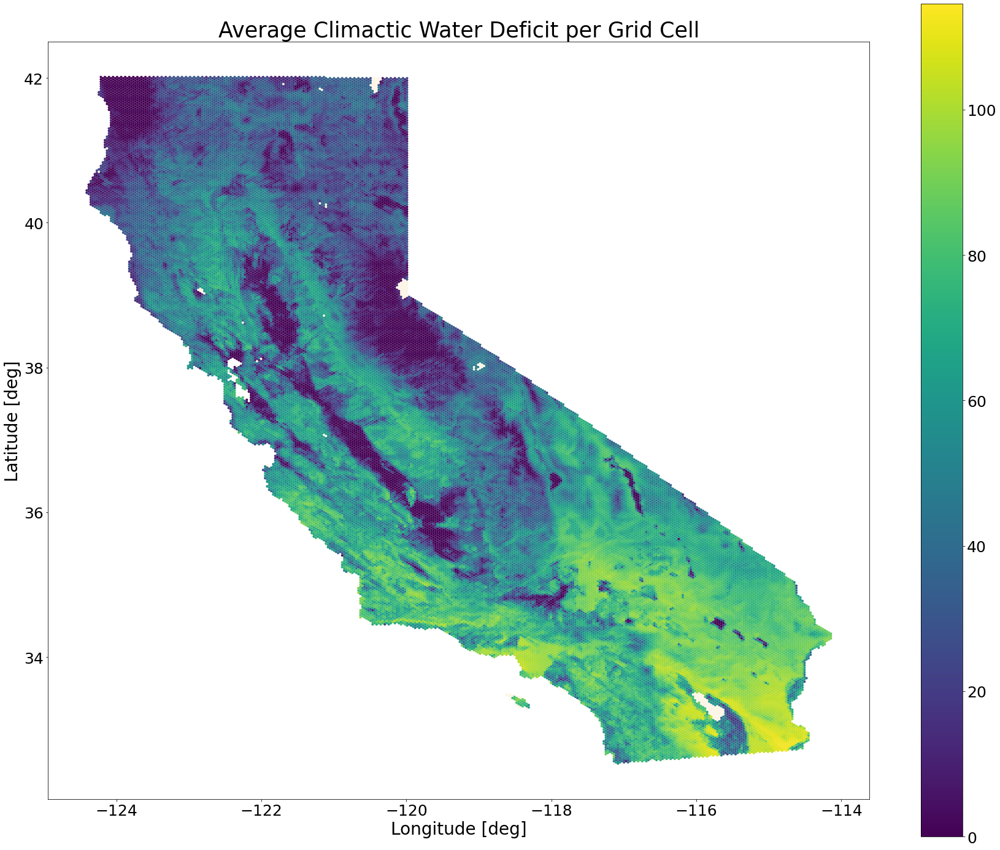

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = env_gdf.plot(ax=ax, column=env_gdf['avg_water_deficit'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average Climactic Water Deficit per Grid Cell', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

# Multivariate Tree Nativity Analysis

In [ ]:
%%bigquery --project urban-forest-269703 native_df
SELECT Id, geometry, CountNativeTrees, CountNativeTreeSpecies, LoveTrees, ShannonTree, 
  ShannonBird, LoveBirds, avg_beta_richness_bird, avg_beta_richness_tree
FROM `urban-forest-269703.treebirdagg.10km-temp`

In [ ]:
from shapely import wkt
native_df['geom'] = native_df['geometry'].apply(wkt.loads)
native_gdf = gpd.GeoDataFrame(native_df, geometry='geom')
native_gdf

,Id,geometry,CountNativeTrees,CountNativeTreeSpecies,LoveTrees,ShannonTree,ShannonBird,LoveBirds,avg_beta_richness_bird,avg_beta_richness_tree,geom
0,30026,"POLYGON((-118.65754264888 34.1942572751377, -1...",0,0,0.0,2.990646,1.222532,2.0,133.166667,29.166667,"POLYGON ((-118.65754 34.19426, -118.66687 34.2..."
1,31847,"POLYGON((-118.26587204284 34.6142150876808, -1...",0,0,0.0,3.056411,0.173205,4.0,102.666667,2.166667,"POLYGON ((-118.26587 34.61422, -118.27520 34.6..."
2,32473,"POLYGON((-118.12598968354 34.5011495227654, -1...",0,0,0.0,2.808042,0.458208,2.0,68.833333,5.500000,"POLYGON ((-118.12599 34.50115, -118.13532 34.5..."
3,36555,"POLYGON((-117.20276611216 33.6450816741199, -1...",0,0,0.0,3.078368,0.937686,4.0,81.600000,19.600000,"POLYGON ((-117.20277 33.64508, -117.21209 33.6..."
4,37240,"POLYGON((-117.06288375286 33.6935383447979, -1...",0,0,0.0,3.257869,0.679193,5.0,99.500000,3.500000,"POLYGON ((-117.06288 33.69354, -117.07221 33.7..."
...,...,...,...,...,...,...,...,...,...,...,...
2693,7294,"POLYGON((-122.26650751882 37.8608120231099, -1...",1028,32,12.0,3.811131,4.194005,10.0,286.666667,283.333333,"POLYGON ((-122.26651 37.86081, -122.27583 37.8..."
2694,8819,"POLYGON((-121.98674280022 36.9885919509051, -1...",1622,32,13.0,3.812970,4.279613,10.0,290.500000,249.166667,"POLYGON ((-121.98674 36.98859, -121.99607 37.0..."
2695,33805,"POLYGON((-117.81824849308 33.6450816741199, -1...",2797,32,16.0,3.971016,4.315767,10.0,370.200000,299.000000,"POLYGON ((-117.81825 33.64508, -117.82757 33.6..."
2696,6998,"POLYGON((-122.32246046254 37.5700719990416, -1...",1205,35,12.0,3.394744,4.214341,6.0,198.166667,308.666667,"POLYGON ((-122.32246 37.57007, -122.33179 37.5..."


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


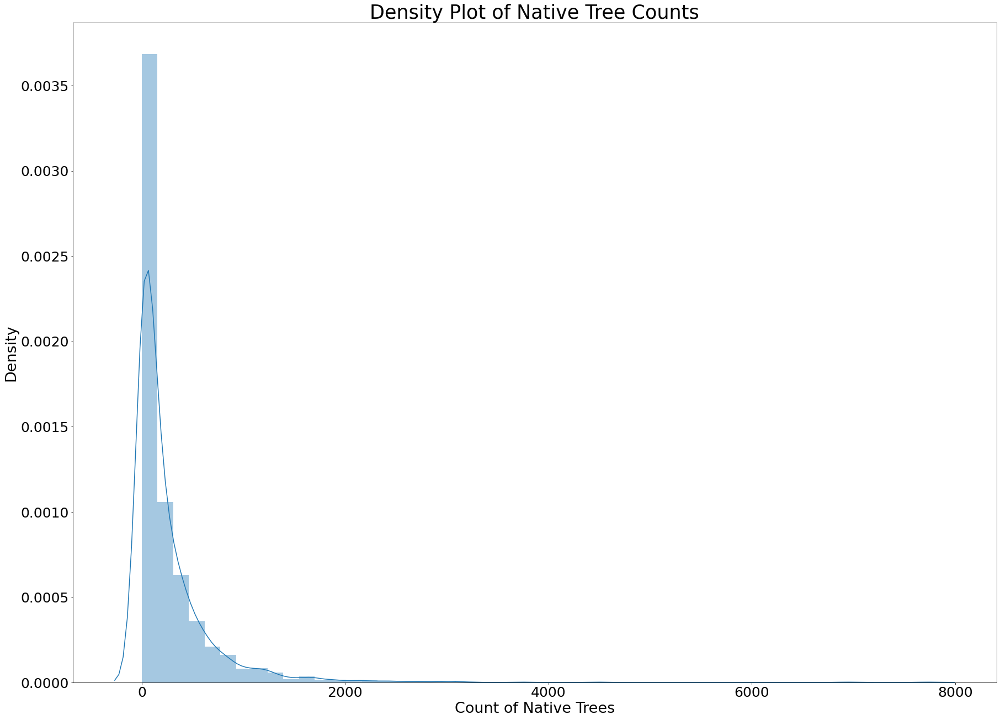

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
sns.distplot(native_gdf['CountNativeTrees'], ax=ax)
ax.set_xlabel('Count of Native Trees', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_ylabel('Density', fontdict={'fontsize': 27, 'fontweight': 'medium'})
ax.set_title('Density Plot of Native Tree Counts', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

In [ ]:
native_gdf['LogCountNativeTrees'] = np.log(native_gdf['CountNativeTrees'] + 1)

## Colored by Log Native Tree Counts

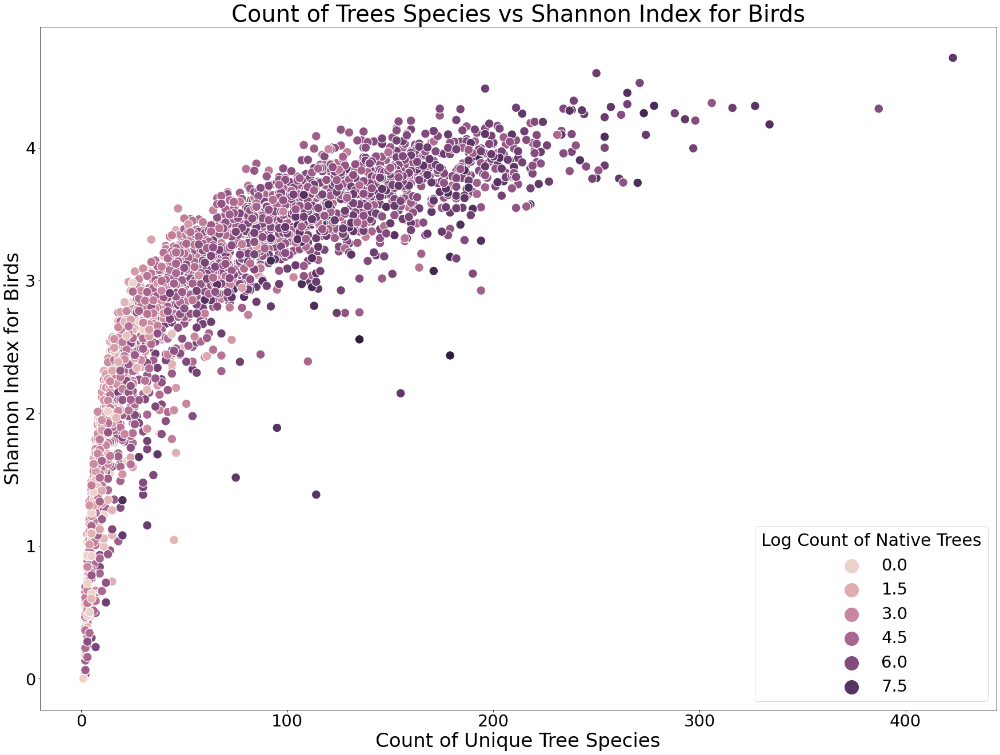

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
ax2 = sns.scatterplot(ax=ax, data=native_gdf, x='TreeSpeciesCounts',
                y='ShannonBird', hue='LogCountNativeTrees', s=250)
ax.set_xlabel('Count of Unique Tree Species', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_ylabel('Shannon Index for Birds', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_title('Count of Trees Species vs Shannon Index for Birds', 
             fontdict={'fontsize': 40, 'fontweight': 'medium'})
plt.xticks(fontsize=29)
plt.yticks(fontsize=29)
plt.legend(title='Log Count of Native Trees', title_fontsize=30, markerscale=4, fontsize=29)
fig.show()

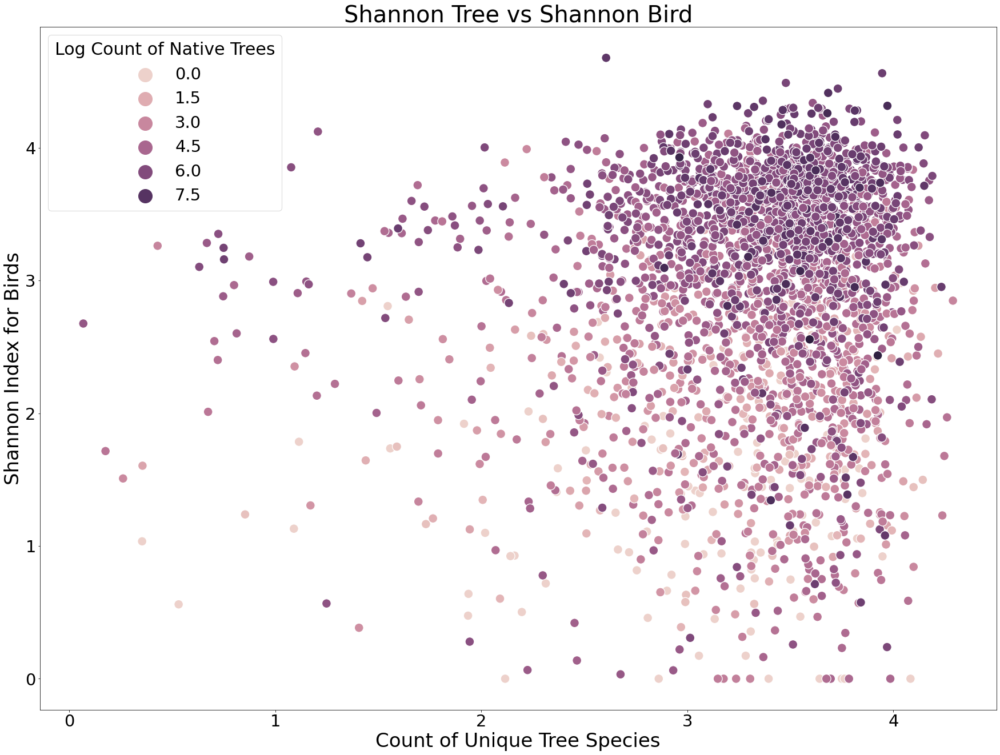

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
ax2 = sns.scatterplot(ax=ax, data=native_gdf, x='ShannonTree',
                y='ShannonBird', hue='LogCountNativeTrees', s=250)
ax.set_xlabel('Count of Unique Tree Species', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_ylabel('Shannon Index for Birds', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_title('Shannon Tree vs Shannon Bird', 
             fontdict={'fontsize': 40, 'fontweight': 'medium'})
plt.xticks(fontsize=29)
plt.yticks(fontsize=29)
plt.legend(title='Log Count of Native Trees', title_fontsize=30, markerscale=4, fontsize=29)
fig.show()

## Count Native Tree Species

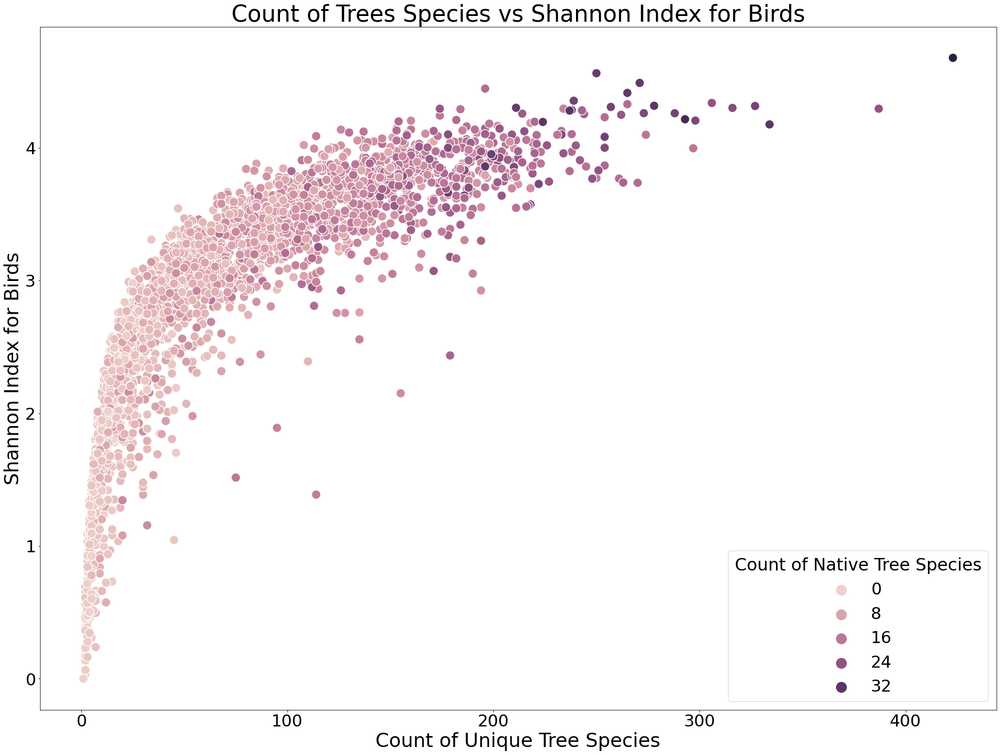

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
ax2 = sns.scatterplot(ax=ax, data=native_gdf, x='TreeSpeciesCounts',
                y='ShannonBird', hue='CountNativeTreeSpecies', s=250)
ax.set_xlabel('Count of Unique Tree Species', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_ylabel('Shannon Index for Birds', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_title('Count of Trees Species vs Shannon Index for Birds', 
             fontdict={'fontsize': 40, 'fontweight': 'medium'})
plt.xticks(fontsize=29)
plt.yticks(fontsize=29)
plt.legend(title='Count of Native Tree Species', title_fontsize=30, markerscale=3, fontsize=29)
fig.show()

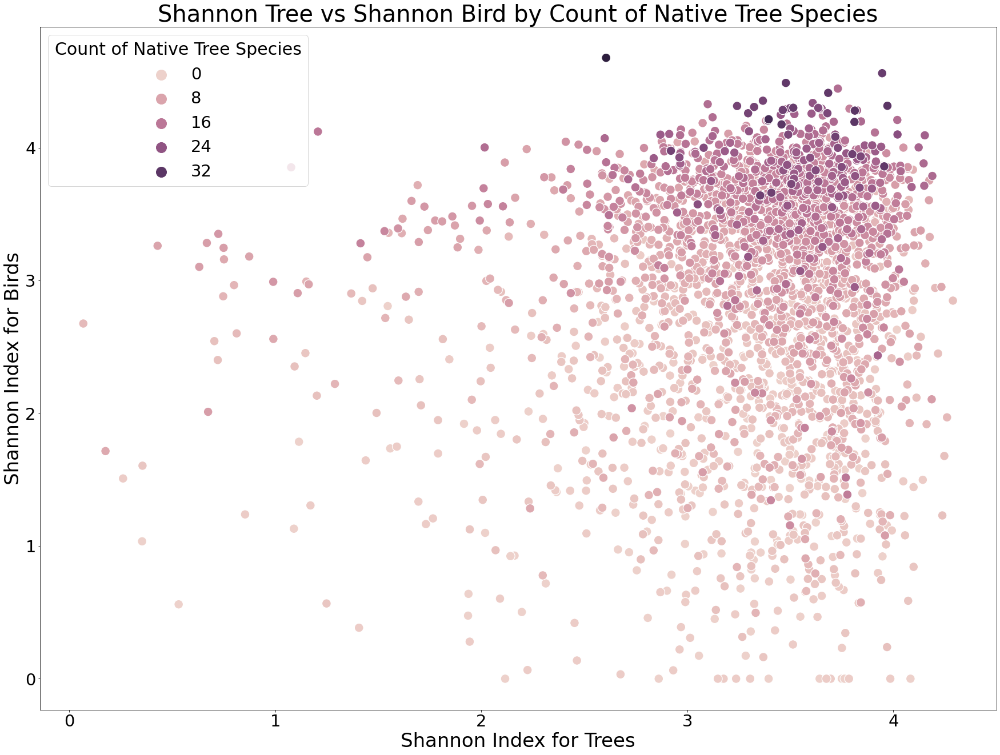

In [ ]:
fig,ax = plt.subplots(figsize=(30,22))
ax2 = sns.scatterplot(ax=ax, data=native_gdf, x='ShannonTree',
                y='ShannonBird', hue='CountNativeTreeSpecies', s=250)
ax.set_xlabel('Shannon Index for Trees', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_ylabel('Shannon Index for Birds', fontdict={'fontsize': 34, 'fontweight': 'medium'})
ax.set_title('Shannon Tree vs Shannon Bird by Count of Native Tree Species', 
             fontdict={'fontsize': 40, 'fontweight': 'medium'})
plt.xticks(fontsize=29)
plt.yticks(fontsize=29)
plt.legend(title='Count of Native Tree Species', title_fontsize=30, markerscale=3, fontsize=29)
fig.show()

# Tree Attribute Variables

## Foliage Type

In [ ]:
%%bigquery --project urban-forest-269703 foliage
SELECT grid, foliage_type, count(*) as foliage_count
FROM `urban-forest-269703.trees.tree-attributes` 
where foliage_type is not null
group by grid, foliage_type

In [ ]:
%%bigquery --project urban-forest-269703 grid
SELECT grid, count(*) as grid_count
FROM `urban-forest-269703.trees.tree-attributes` 
where foliage_type is not null
group by grid

In [ ]:
foliage_df = foliage.merge(grid, how='inner', left_on='grid', right_on='grid')
foliage_df['percent'] = foliage_df['foliage_count'] / foliage_df['grid_count']
foliage_df

,grid,foliage_type,foliage_count,grid_count,percent
0,13010.0,Evergreen,2064,5802,0.355739
1,13010.0,Deciduous,3731,5802,0.643054
2,13010.0,Partly Deciduous,7,5802,0.001206
3,37491.0,Evergreen,1666,2226,0.748428
4,37491.0,Deciduous,470,2226,0.211141
...,...,...,...,...,...
8484,15226.0,Deciduous,1,1,1.000000
8485,14614.0,Evergreen,1,1,1.000000
8486,19875.0,Deciduous,1,1,1.000000
8487,31272.0,Deciduous,1,1,1.000000


In [ ]:
foliage_pct = foliage_df.pivot(
    index='grid', columns='foliage_type', values='percent').reset_index().fillna(0)
foliage_pct

foliage_type,grid,Deciduous,Evergreen,Partly Deciduous
0,0.0,0.000000,1.000000,0.000000
1,766.0,0.000000,1.000000,0.000000
2,977.0,0.000000,1.000000,0.000000
3,1477.0,0.000000,1.000000,0.000000
4,1871.0,0.222222,0.777778,0.000000
...,...,...,...,...
3581,43730.0,0.089552,0.731343,0.179104
3582,43815.0,0.070423,0.577465,0.352113
3583,43910.0,0.000000,0.112500,0.887500
3584,44193.0,0.352564,0.570513,0.076923


In [ ]:
(foliage_pct.iloc[:, 1:4].sum(axis=1).between(.9999, 1.0001)).mean()

1.0

In [ ]:
foliage_pct['Partly_Deciduous'] = foliage_pct['Partly Deciduous']
foliage_pct

foliage_type,grid,Deciduous,Evergreen,Partly Deciduous,Partly_Deciduous
0,0.0,0.000000,1.000000,0.000000,0.000000
1,766.0,0.000000,1.000000,0.000000,0.000000
2,977.0,0.000000,1.000000,0.000000,0.000000
3,1477.0,0.000000,1.000000,0.000000,0.000000
4,1871.0,0.222222,0.777778,0.000000,0.000000
...,...,...,...,...,...
3581,43730.0,0.089552,0.731343,0.179104,0.179104
3582,43815.0,0.070423,0.577465,0.352113,0.352113
3583,43910.0,0.000000,0.112500,0.887500,0.887500
3584,44193.0,0.352564,0.570513,0.076923,0.076923


In [ ]:
foliage_gdf = ca_gdf.merge(foliage_pct, how='inner', left_on='ID', right_on='grid')
foliage_gdf

,ID,geom,grid,Deciduous,Evergreen,Partly Deciduous,Partly_Deciduous
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,0.186047,0.813953,0.000000,0.000000
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,0.096774,0.903226,0.000000,0.000000
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,0.352273,0.647727,0.000000,0.000000
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,0.244604,0.741007,0.014388,0.014388
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,0.500000,0.500000,0.000000,0.000000
...,...,...,...,...,...,...,...
3581,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,0.113244,0.815739,0.071017,0.071017
3582,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,0.165577,0.723312,0.111111,0.111111
3583,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,0.199657,0.654670,0.145673,0.145673
3584,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,0.153191,0.712766,0.134043,0.134043


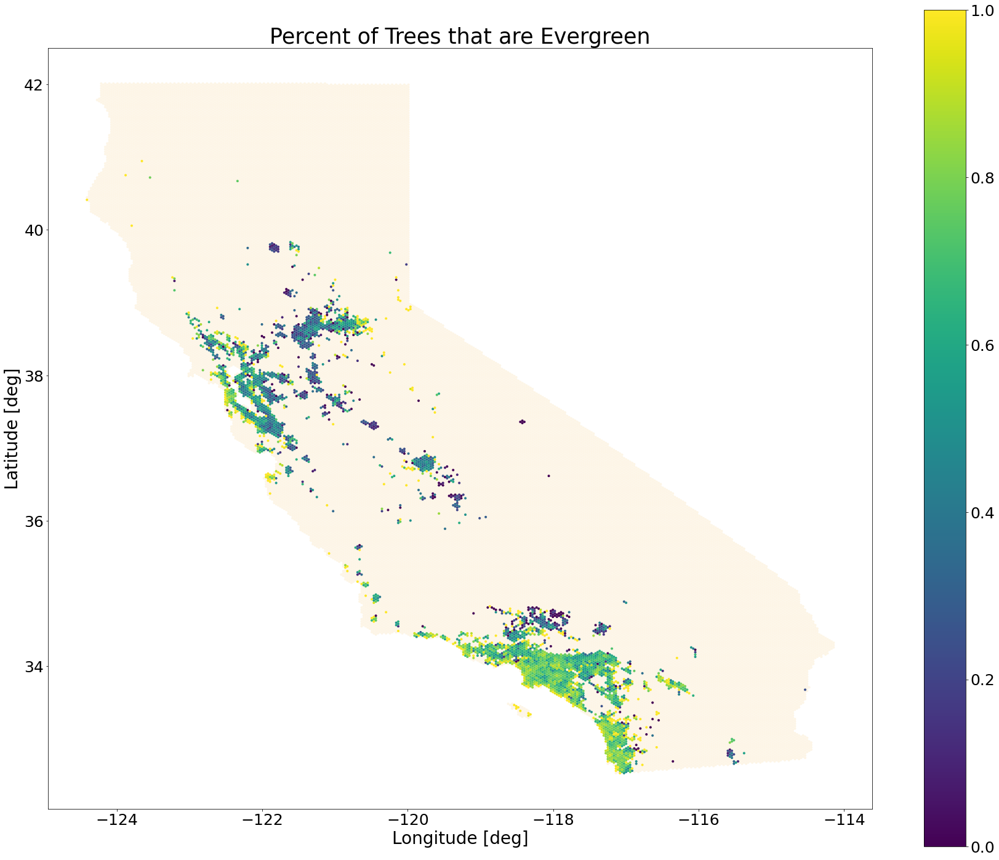

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = foliage_gdf.plot(ax=ax, column=foliage_gdf['Evergreen'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees that are Evergreen', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

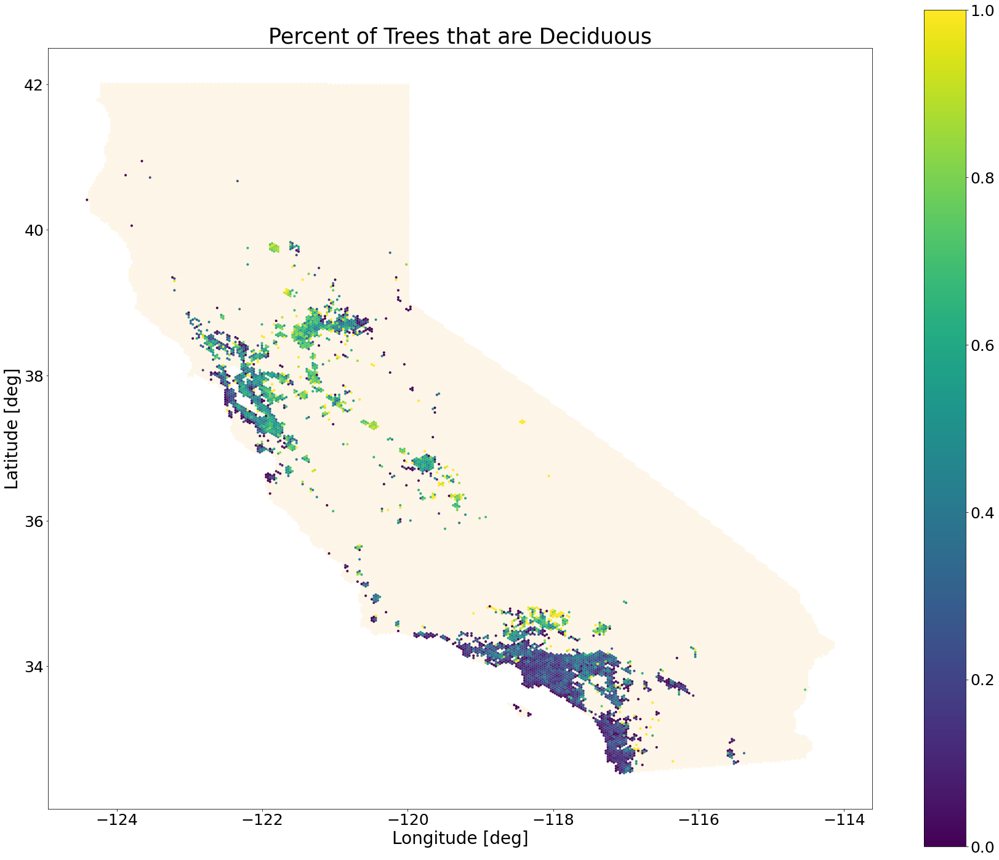

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = foliage_gdf.plot(ax=ax, column=foliage_gdf['Deciduous'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees that are Deciduous', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = foliage_gdf.plot(ax=ax, column=foliage_gdf['Partly_Deciduous'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees that are Partly Deciduous', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.foliage_pct'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
foliage_pct[['grid', 'Deciduous', 'Evergreen', 'Partly_Deciduous']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:05,  5.12s/it]


## Tree Sex

In [ ]:
%%bigquery --project urban-forest-269703 sex
SELECT grid, tree_sex, count(*) as sex_count
FROM `urban-forest-269703.trees.tree-attributes` 
where tree_sex is not null
group by grid, tree_sex

In [ ]:
%%bigquery --project urban-forest-269703 grid
SELECT grid, count(*) as grid_count
FROM `urban-forest-269703.trees.tree-attributes` 
where tree_sex is not null
group by grid

In [ ]:
sex_df = sex.merge(grid, how='inner', left_on='grid', right_on='grid')
sex_df['percent'] = sex_df['sex_count'] / sex_df['grid_count']
sex_df

,grid,tree_sex,sex_count,grid_count,percent
0,6565.0,Monoecious,2991,6236,0.479634
1,6565.0,Perfect Flowers,2762,6236,0.442912
2,6565.0,Dioecious,483,6236,0.077453
3,32699.0,Dioecious,2910,15423,0.188679
4,32699.0,Perfect Flowers,4776,15423,0.309667
...,...,...,...,...,...
9362,977.0,Monoecious,2,2,1.000000
9363,7906.0,Monoecious,1,1,1.000000
9364,34559.0,Dioecious,1,1,1.000000
9365,36012.0,Perfect Flowers,1,1,1.000000


In [ ]:
sex_pct = sex_df.pivot(
    index='grid', columns='tree_sex', values='percent').reset_index().fillna(0)
sex_pct

tree_sex,grid,Dioecious,Monoecious,Perfect Flowers
0,0.0,0.000000,0.222222,0.777778
1,766.0,0.000000,1.000000,0.000000
2,977.0,0.000000,1.000000,0.000000
3,1477.0,0.000000,0.750000,0.250000
4,1871.0,0.000000,0.888889,0.111111
...,...,...,...,...
3578,43730.0,0.477612,0.089552,0.432836
3579,43815.0,0.225000,0.145833,0.629167
3580,43910.0,0.000000,0.075000,0.925000
3581,44193.0,0.366667,0.113333,0.520000


In [ ]:
(sex_pct.iloc[:, 1:4].sum(axis=1).between(.9999, 1.0001)).mean()

1.0

In [ ]:
sex_pct['Perfect_Flowers'] = sex_pct['Perfect Flowers']
sex_pct

tree_sex,grid,Dioecious,Monoecious,Perfect Flowers,Perfect_Flowers
0,0.0,0.000000,0.222222,0.777778,0.777778
1,766.0,0.000000,1.000000,0.000000,0.000000
2,977.0,0.000000,1.000000,0.000000,0.000000
3,1477.0,0.000000,0.750000,0.250000,0.250000
4,1871.0,0.000000,0.888889,0.111111,0.111111
...,...,...,...,...,...
3578,43730.0,0.477612,0.089552,0.432836,0.432836
3579,43815.0,0.225000,0.145833,0.629167,0.629167
3580,43910.0,0.000000,0.075000,0.925000,0.925000
3581,44193.0,0.366667,0.113333,0.520000,0.520000


In [ ]:
sex_gdf = ca_gdf.merge(sex_pct, how='inner', left_on='ID', right_on='grid')
sex_gdf

,ID,geom,grid,Dioecious,Monoecious,Perfect Flowers,Perfect_Flowers
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,0.285714,0.476190,0.238095,0.238095
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,0.129032,0.612903,0.258065,0.258065
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,0.267442,0.255814,0.476744,0.476744
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,0.217391,0.413043,0.369565,0.369565
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,0.000000,0.941176,0.058824,0.058824
...,...,...,...,...,...,...,...
3578,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,0.295103,0.115335,0.589562,0.589562
3579,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,0.088300,0.079470,0.832230,0.832230
3580,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,0.123144,0.132751,0.744105,0.744105
3581,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,0.199350,0.133261,0.667389,0.667389


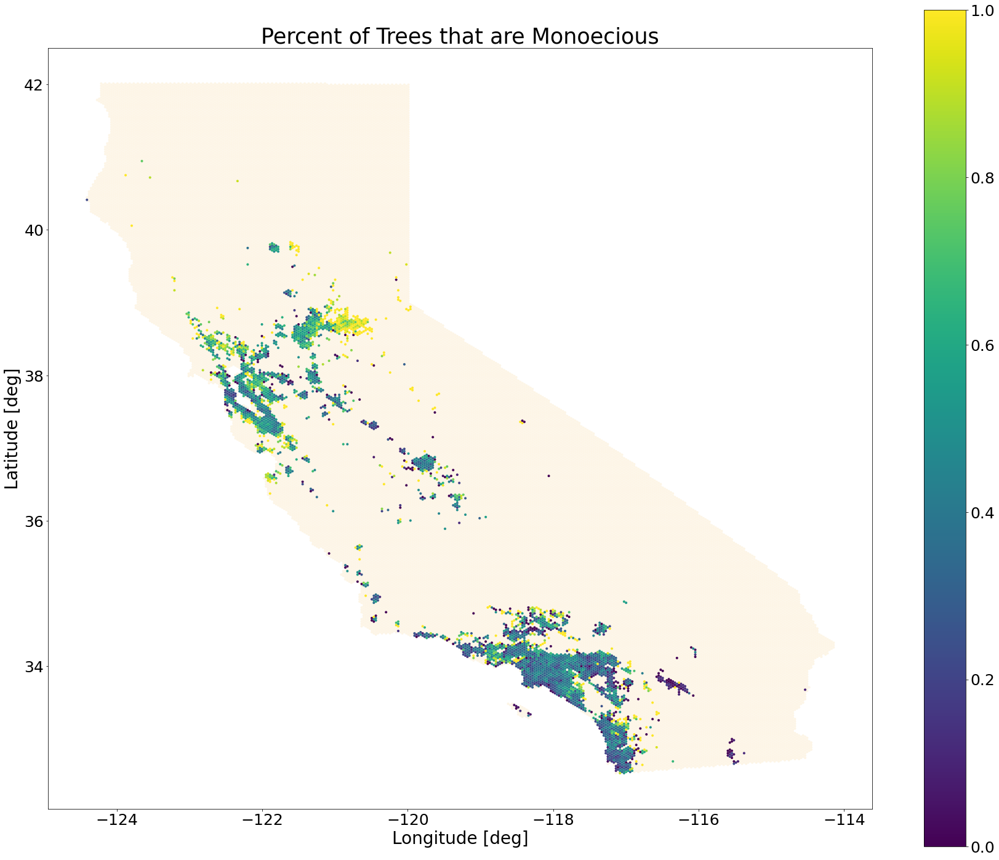

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = sex_gdf.plot(ax=ax, column=sex_gdf['Monoecious'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees that are Monoecious', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

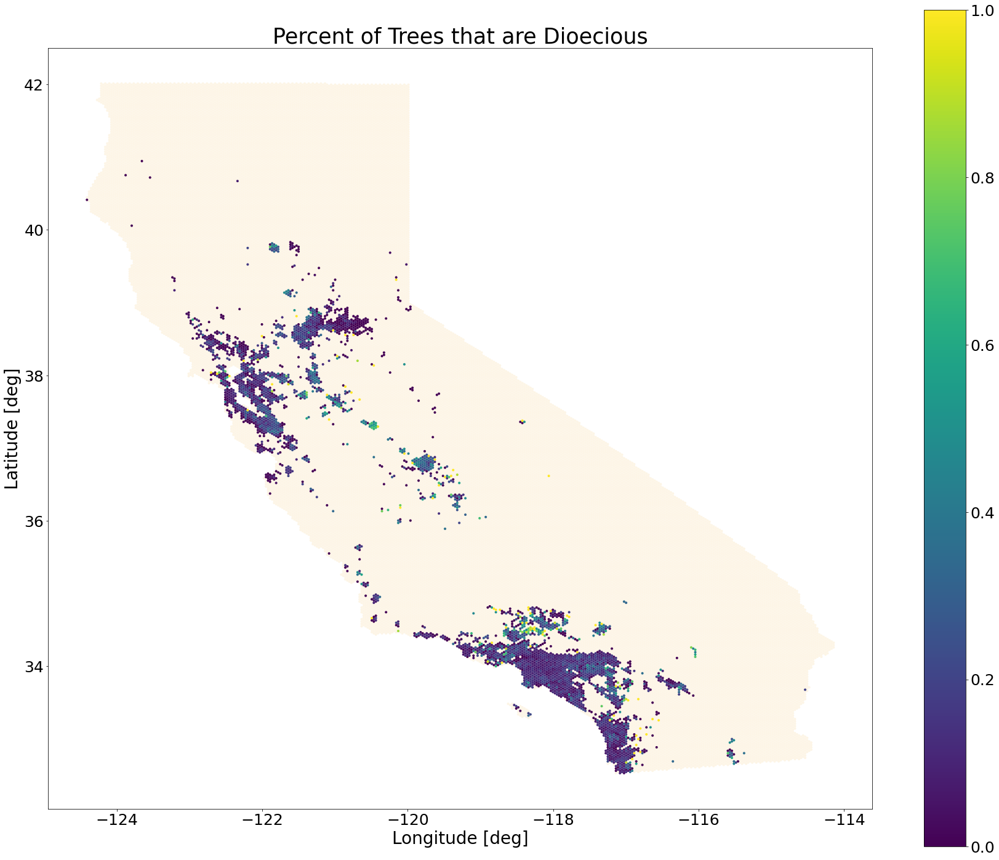

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = sex_gdf.plot(ax=ax, column=sex_gdf['Dioecious'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees that are Dioecious', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

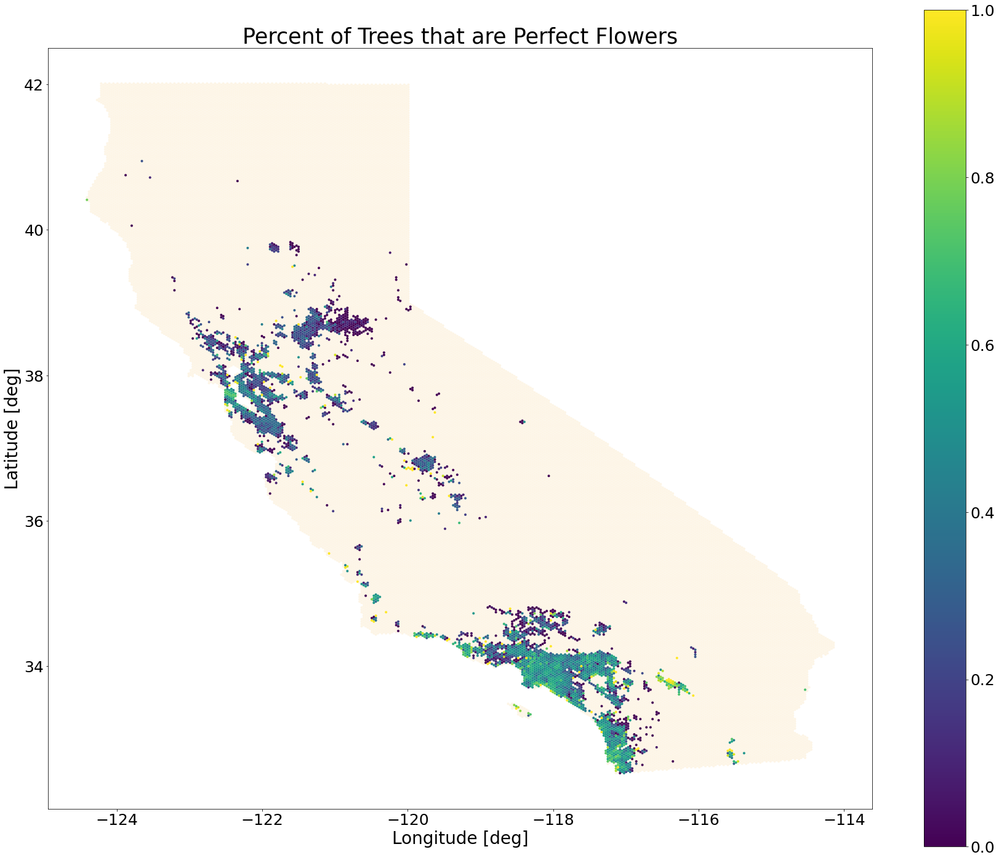

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = sex_gdf.plot(ax=ax, column=sex_gdf['Perfect_Flowers'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees that are Perfect Flowers', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.sex_pct'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
sex_pct[['grid', 'Dioecious', 'Monoecious', 'Perfect_Flowers']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:05,  5.46s/it]


## Fragrance

In [ ]:
%%bigquery --project urban-forest-269703 fragrance
SELECT grid, sum(fragrance) as fragrance_count, count(*) as count
FROM `urban-forest-269703.trees.tree-attributes` 
where fragrance is not null
group by grid

In [ ]:
fragrance['pct_fragrance'] = fragrance['fragrance_count'] / fragrance['count']
fragrance

,grid,fragrance_count,count,pct_fragrance
0,36820.0,81.0,407,0.199017
1,37219.0,1555.0,5415,0.287165
2,31297.0,1079.0,4141,0.260565
3,36703.0,549.0,2195,0.250114
4,34677.0,2728.0,7116,0.383361
...,...,...,...,...
3581,16869.0,0.0,1,0.000000
3582,13796.0,1.0,1,1.000000
3583,34083.0,0.0,1,0.000000
3584,15213.0,0.0,1,0.000000


In [ ]:
frag_gdf = ca_gdf.merge(fragrance, how='inner', left_on='ID', right_on='grid')
frag_gdf

,ID,geom,grid,fragrance_count,count,pct_fragrance
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,14.0,43,0.325581
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,14.0,31,0.451613
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,25.0,88,0.284091
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,55.0,139,0.395683
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,1.0,68,0.014706
...,...,...,...,...,...,...
3580,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,347.0,1563,0.222009
3581,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,77.0,459,0.167756
3582,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,299.0,1167,0.256213
3583,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,129.0,940,0.137234


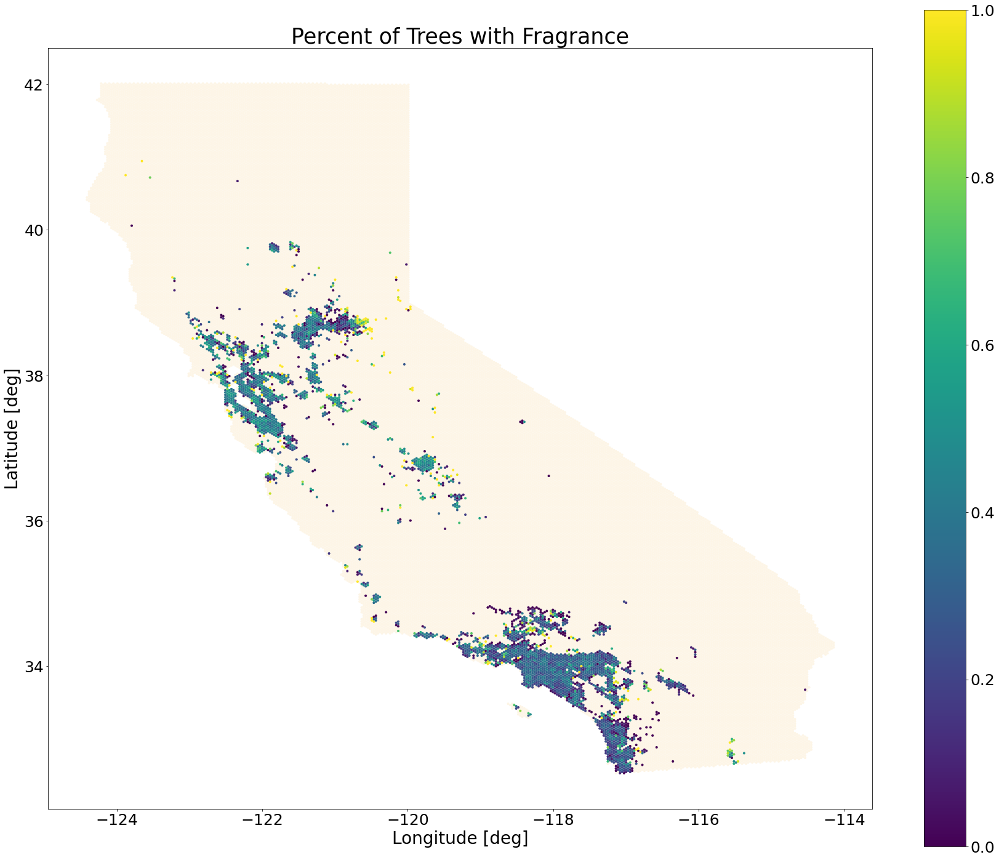

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = frag_gdf.plot(ax=ax, column=frag_gdf['pct_fragrance'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees with Fragrance', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.fragrance'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
frag_gdf[['grid', 'pct_fragrance']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:07,  7.07s/it]


## Foliage Density

In [ ]:
%%bigquery --project urban-forest-269703 dense
SELECT grid, count(*) as dense_count
FROM `urban-forest-269703.trees.tree-attributes` 
where density_in_leaf is not null
  and density_in_leaf in ('Very Dense', 'Dense to Very Dense', 'Dense')
group by grid

In [ ]:
%%bigquery --project urban-forest-269703 count
SELECT grid, count(*) as count
FROM `urban-forest-269703.trees.tree-attributes` 
where density_in_leaf is not null
group by grid

In [ ]:
dense_df = dense.merge(count, how='inner', left_on='grid', right_on='grid')
dense_df

,grid,dense_count,count
0,9330.0,2223,6191
1,34294.0,332,2327
2,34905.0,321,1228
3,31302.0,2319,6915
4,32336.0,1050,2821
...,...,...,...
3215,9872.0,1,3
3216,33591.0,1,10
3217,7614.0,1,7
3218,22441.0,1,7


In [ ]:
dense_gdf = ca_gdf.merge(dense_df, how='inner', left_on='ID', right_on='grid')
dense_gdf

,ID,geom,grid,dense_count,count
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,3,43
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,10,29
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,21,80
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,41,134
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,30,68
...,...,...,...,...,...
3214,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,652,1521
3215,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,180,396
3216,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,379,1047
3217,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,297,919


In [ ]:
dense_gdf['pct_dense'] = dense_gdf['dense_count'] / dense_gdf['count']
dense_gdf

,ID,geom,grid,dense_count,count,pct_dense
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,3,43,0.069767
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,10,29,0.344828
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,21,80,0.262500
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,41,134,0.305970
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,30,68,0.441176
...,...,...,...,...,...,...
3214,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,652,1521,0.428665
3215,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,180,396,0.454545
3216,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,379,1047,0.361987
3217,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,297,919,0.323177


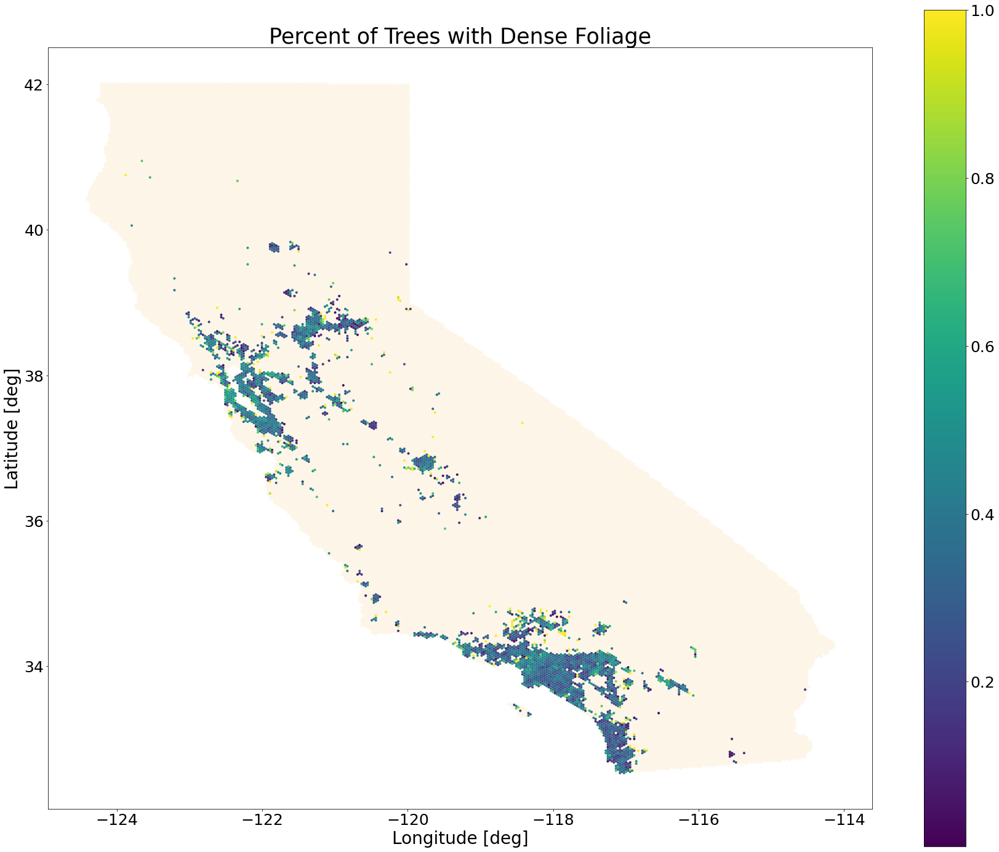

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = dense_gdf.plot(ax=ax, column=dense_gdf['pct_dense'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees with Dense Foliage', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.density'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
dense_gdf[['grid', 'pct_dense']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:04,  4.40s/it]


## Fruit Type

In [ ]:
%%bigquery --project urban-forest-269703 fruit
SELECT grid, fruit_type, count(*) as fruit_count
FROM `urban-forest-269703.trees.tree-attributes` 
group by grid, fruit_type

In [ ]:
fruit

,grid,fruit_type,fruit_count
0,12068.0,Fleshy Cone,29
1,8368.0,Fleshy Cone,2
2,7596.0,Fleshy Cone,5
3,7443.0,Fleshy Cone,2
4,7143.0,Fleshy Cone,1
...,...,...,...
32600,4368.0,Multiple Fruit,1
32601,33926.0,Multiple Fruit,3
32602,33942.0,Multiple Fruit,1
32603,37234.0,Multiple Fruit,1


In [ ]:
fruit_map = {'Cone': 'Indehiscent', 'Fleshy Cone': 'Indehiscent',
             'Achene': 'Indehiscent', 'Samara': 'Indehiscent', 
             'Nut': 'Indehiscent', 'Acorn': 'Indehiscent',
             'Capsule': 'Dehiscent', 'Follicle': 'Dehiscent',
             'Legume': 'Dehiscent', 'Drupe': 'Fleshy Fruit',
             'Pome': 'Fleshy Fruit', 'Berry': 'Fleshy Fruit',
             'Hesperidium': 'Fleshy Fruit', 'Multiple Fruit': 'Fleshy Fruit'}
fruit['fruit_categ'] = fruit['fruit_type'].map(fruit_map)
fruit

,grid,fruit_type,fruit_count,fruit_categ
0,12068.0,Fleshy Cone,29,Indehiscent
1,8368.0,Fleshy Cone,2,Indehiscent
2,7596.0,Fleshy Cone,5,Indehiscent
3,7443.0,Fleshy Cone,2,Indehiscent
4,7143.0,Fleshy Cone,1,Indehiscent
...,...,...,...,...
32600,4368.0,Multiple Fruit,1,Fleshy Fruit
32601,33926.0,Multiple Fruit,3,Fleshy Fruit
32602,33942.0,Multiple Fruit,1,Fleshy Fruit
32603,37234.0,Multiple Fruit,1,Fleshy Fruit


In [ ]:
fruit['fruit_categ'].value_counts()

Indehiscent     12270
Fleshy Fruit    10349
Dehiscent        7160
Name: fruit_categ, dtype: int64

In [ ]:
fruit_counts = fruit.groupby(['grid', 'fruit_categ']).sum().reset_index().pivot(
    index='grid', columns='fruit_categ', values='fruit_count').reset_index().dropna()
fruit_counts

fruit_categ,grid,Dehiscent,Fleshy Fruit,Indehiscent
8,3765.0,1.0,18.0,64.0
9,3882.0,23.0,36.0,45.0
10,3883.0,1.0,3.0,24.0
15,4126.0,3.0,2.0,12.0
16,4128.0,3.0,39.0,15.0
...,...,...,...,...
3578,43730.0,25.0,34.0,8.0
3579,43815.0,169.0,60.0,55.0
3580,43910.0,71.0,3.0,6.0
3581,44193.0,84.0,40.0,32.0


In [ ]:
fruit_gdf = ca_gdf.merge(fruit_counts, how='inner', left_on='ID', right_on='grid')
fruit_gdf

,ID,geom,grid,Dehiscent,Fleshy Fruit,Indehiscent
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,16.0,12.0,15.0
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,6.0,5.0,20.0
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,28.0,40.0,20.0
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,32.0,47.0,60.0
4,30026,"POLYGON ((-118.65754 34.19426, -118.66687 34.2...",30026.0,21.0,23.0,5.0
...,...,...,...,...,...,...
2674,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,373.0,1089.0,101.0
2675,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,206.0,232.0,21.0
2676,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,602.0,473.0,92.0
2677,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,356.0,484.0,100.0


In [ ]:
fruit_gdf['Fleshy_Fruit'] = fruit_gdf['Fleshy Fruit']
fruit_gdf

,ID,geom,grid,Dehiscent,Fleshy Fruit,Indehiscent,Fleshy_Fruit
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,16.0,12.0,15.0,12.0
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,6.0,5.0,20.0,5.0
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,28.0,40.0,20.0,40.0
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,32.0,47.0,60.0,47.0
4,30026,"POLYGON ((-118.65754 34.19426, -118.66687 34.2...",30026.0,21.0,23.0,5.0,23.0
...,...,...,...,...,...,...,...
2674,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,373.0,1089.0,101.0,1089.0
2675,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,206.0,232.0,21.0,232.0
2676,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,602.0,473.0,92.0,473.0
2677,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,356.0,484.0,100.0,484.0


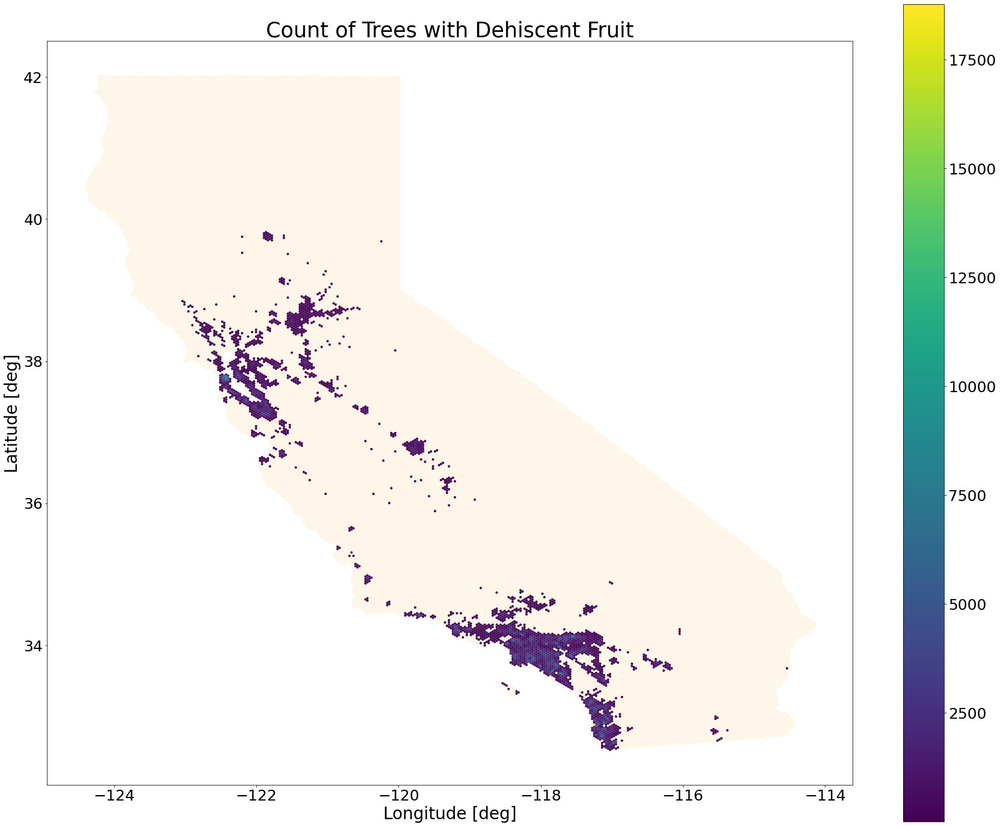

In [ ]:
fruit_gdf['Pct_Dehiscent'] = fruit_gdf['Fleshy_Fruit'] / (
    fruit_gdf['Fleshy_Fruit'] + fruit_gdf['Dehiscent'] + fruit_gdf['Indehiscent'])
fruit_gdf

fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = fruit_gdf.plot(ax=ax, column=fruit_gdf['Dehiscent'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Count of Trees with Dehiscent Fruit', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
fruit_gdf['Pct_Fleshy_Fruit'] = fruit_gdf['Fleshy_Fruit'] / (
    fruit_gdf['Fleshy_Fruit'] + fruit_gdf['Dehiscent'] + fruit_gdf['Indehiscent'])
fruit_gdf

,ID,geom,grid,Dehiscent,Fleshy Fruit,Indehiscent,Fleshy_Fruit,Pct_Fleshy_Fruit
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,16.0,12.0,15.0,12.0,0.279070
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,6.0,5.0,20.0,5.0,0.161290
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,28.0,40.0,20.0,40.0,0.454545
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,32.0,47.0,60.0,47.0,0.338129
4,30026,"POLYGON ((-118.65754 34.19426, -118.66687 34.2...",30026.0,21.0,23.0,5.0,23.0,0.469388
...,...,...,...,...,...,...,...,...
2674,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,373.0,1089.0,101.0,1089.0,0.696737
2675,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,206.0,232.0,21.0,232.0,0.505447
2676,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,602.0,473.0,92.0,473.0,0.405313
2677,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,356.0,484.0,100.0,484.0,0.514894


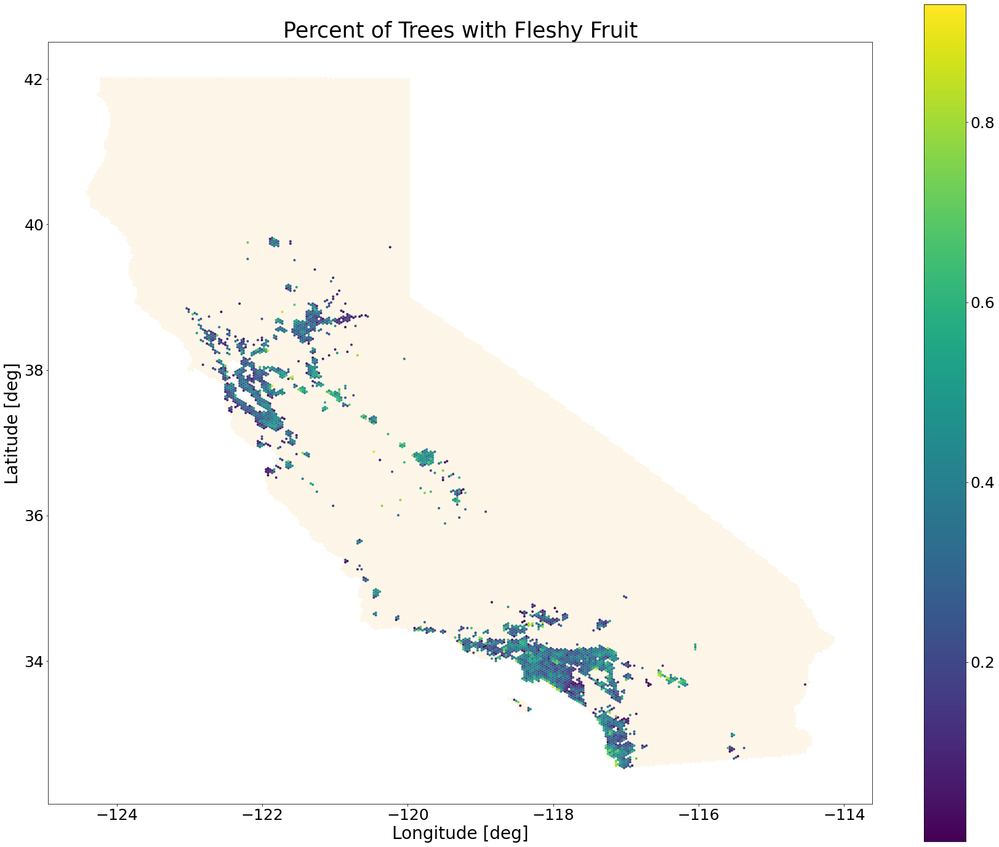

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = fruit_gdf.plot(ax=ax, column=fruit_gdf['Pct_Fleshy_Fruit'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Percent of Trees with Fleshy Fruit', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
fruit_gdf['Pct_Indehiscent'] = fruit_gdf['Indehiscent'] / (
    fruit_gdf['Fleshy_Fruit'] + fruit_gdf['Dehiscent'] + fruit_gdf['Indehiscent'])
fruit_gdf['Pct_Dehiscent'] = fruit_gdf['Dehiscent'] / (
    fruit_gdf['Fleshy_Fruit'] + fruit_gdf['Dehiscent'] + fruit_gdf['Indehiscent'])
fruit_gdf

,ID,geom,grid,Dehiscent,Fleshy Fruit,Indehiscent,Fleshy_Fruit,Pct_Fleshy_Fruit,Pct_Dehiscent,Pct_Indehiscent
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,16.0,12.0,15.0,12.0,0.279070,0.372093,0.348837
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,6.0,5.0,20.0,5.0,0.161290,0.193548,0.645161
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,28.0,40.0,20.0,40.0,0.454545,0.318182,0.227273
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,32.0,47.0,60.0,47.0,0.338129,0.230216,0.431655
4,30026,"POLYGON ((-118.65754 34.19426, -118.66687 34.2...",30026.0,21.0,23.0,5.0,23.0,0.469388,0.428571,0.102041
...,...,...,...,...,...,...,...,...,...,...
2674,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,373.0,1089.0,101.0,1089.0,0.696737,0.238644,0.064619
2675,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,206.0,232.0,21.0,232.0,0.505447,0.448802,0.045752
2676,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,602.0,473.0,92.0,473.0,0.405313,0.515853,0.078835
2677,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,356.0,484.0,100.0,484.0,0.514894,0.378723,0.106383


In [ ]:
fruit_gdf.iloc[:, [2,3,5,6,7,8,9]]

,grid,Dehiscent,Indehiscent,Fleshy_Fruit,Pct_Fleshy_Fruit,Pct_Dehiscent,Pct_Indehiscent
0,27259.0,16.0,15.0,12.0,0.279070,0.372093,0.348837
1,28199.0,6.0,20.0,5.0,0.161290,0.193548,0.645161
2,28733.0,28.0,20.0,40.0,0.454545,0.318182,0.227273
3,28997.0,32.0,60.0,47.0,0.338129,0.230216,0.431655
4,30026.0,21.0,5.0,23.0,0.469388,0.428571,0.102041
...,...,...,...,...,...,...,...
2674,41015.0,373.0,101.0,1089.0,0.696737,0.238644,0.064619
2675,41128.0,206.0,21.0,232.0,0.505447,0.448802,0.045752
2676,41241.0,602.0,92.0,473.0,0.405313,0.515853,0.078835
2677,41242.0,356.0,100.0,484.0,0.514894,0.378723,0.106383


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.fruit_type'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
fruit_gdf.iloc[:, [2,3,5,6,7,8,9]].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:08,  8.20s/it]


## Tree Size

In [ ]:
%%bigquery --project urban-forest-269703 tree_size
SELECT grid, avg((height_high + height_low) / 2) as avg_avg_height,
  avg((dbh_lo + dbh_hi) / 2) as  avg_avg_dbh,
FROM `urban-forest-269703.trees.tree-attributes`
where height_high is not null and height_high != 0
  and dbh_hi is not null 
group by grid

In [ ]:
tree_size

,grid,avg_avg_height,avg_avg_dbh
0,34186.0,54.597169,16.851142
1,37480.0,52.530933,10.566482
2,32328.0,52.879266,14.173041
3,33928.0,53.882828,12.268076
4,9329.0,54.297200,10.564609
...,...,...,...
3465,37628.0,55.000000,10.000000
3466,25464.0,70.000000,27.500000
3467,30930.0,45.000000,3.000000
3468,31059.0,45.000000,19.000000


In [ ]:
tree_size.isna().sum()

grid              1
avg_avg_height    0
avg_avg_dbh       0
dtype: int64

In [ ]:
tree_size_gdf = ca_gdf.merge(tree_size, how='inner', left_on='ID', right_on='grid')
tree_size_gdf

,ID,geom,grid,avg_avg_height,avg_avg_dbh
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,59.534884,13.569767
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,42.661290,15.387097
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,36.511364,5.034091
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,48.327338,15.237410
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,50.220588,14.558824
...,...,...,...,...,...
3464,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,54.344210,14.977607
3465,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,50.942266,14.708061
3466,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,47.179708,12.293637
3467,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,56.069681,13.920745


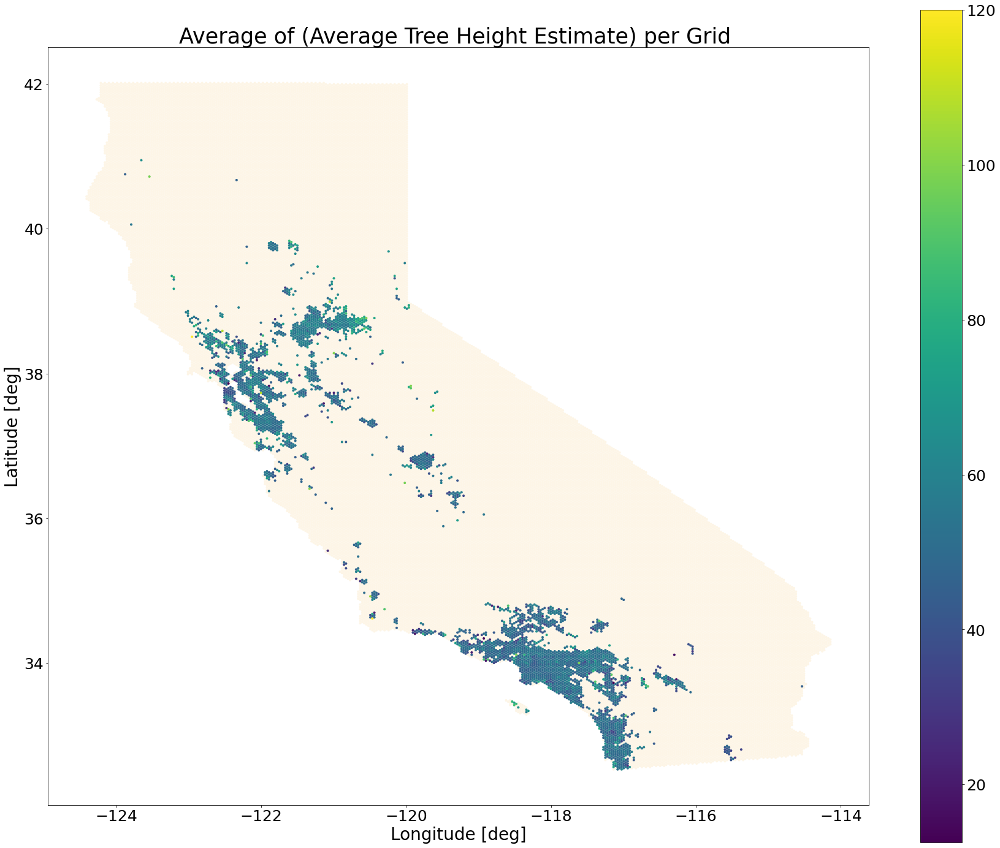

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = tree_size_gdf.plot(ax=ax, column=tree_size_gdf['avg_avg_height'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average of (Average Tree Height Estimate) per Grid ', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

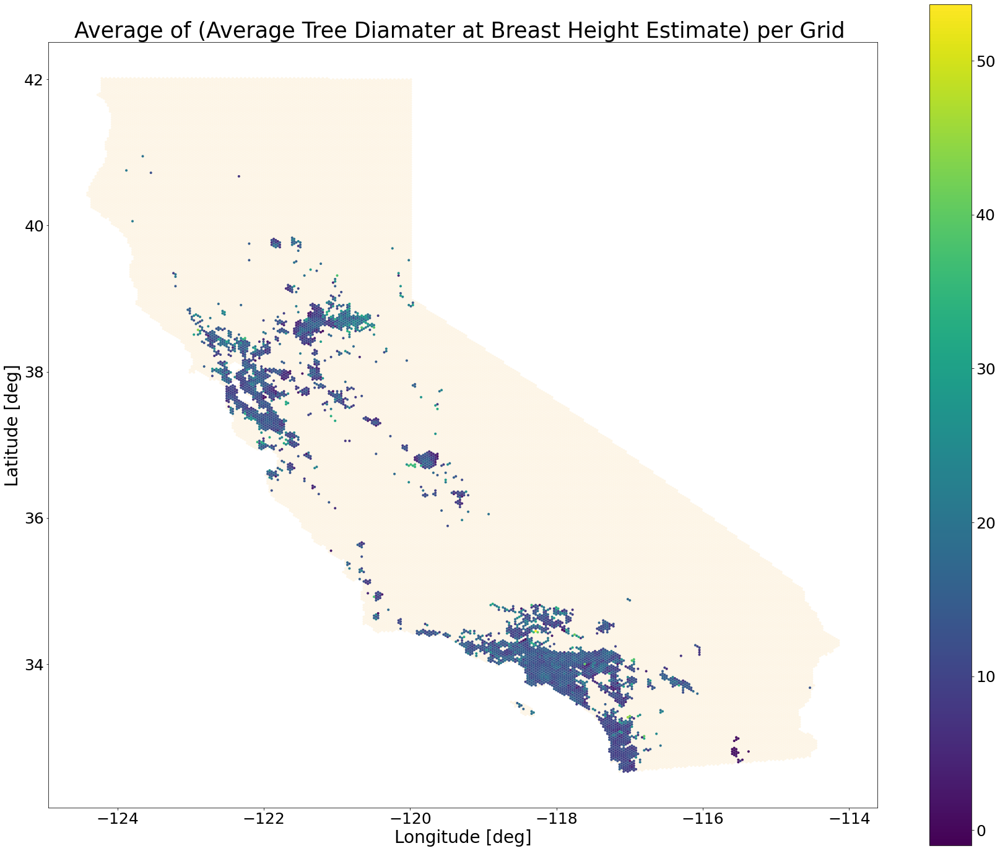

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = tree_size_gdf.plot(ax=ax, column=tree_size_gdf['avg_avg_dbh'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average of (Average Tree Diameter at Breast Height Estimate) per Grid ', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.tree_size'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
tree_size_gdf[['ID', 'avg_avg_height', 'avg_avg_dbh']].to_gbq(
    BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:06,  6.61s/it]


In [ ]:
%%bigquery --project urban-forest-269703 canopy
SELECT grid, avg((width_high + width_low) / 2) as avg_avg_canopy_size
FROM `urban-forest-269703.trees.tree-attributes`
where width_high is not null and width_low is not null 
group by grid

In [ ]:
canopy

,grid,avg_avg_canopy_size
0,36687.0,39.000777
1,35760.0,32.414724
2,36531.0,33.885669
3,31298.0,27.966804
4,36262.0,28.205145
...,...,...
3576,40667.0,70.000000
3577,28058.0,15.000000
3578,7890.0,30.000000
3579,17929.0,27.500000


In [ ]:
canopy_gdf = ca_gdf.merge(canopy, how='inner', left_on='ID', right_on='grid')
canopy_gdf

,ID,geom,grid,avg_avg_canopy_size
0,27259,"POLYGON ((-119.24505 34.46885, -119.25437 34.4...",27259.0,42.202381
1,28199,"POLYGON ((-119.04921 34.38808, -119.05854 34.4...",28199.0,33.822581
2,28733,"POLYGON ((-118.93731 34.38808, -118.94663 34.4...",28733.0,26.146341
3,28997,"POLYGON ((-118.88135 34.42039, -118.89068 34.4...",28997.0,42.036496
4,29646,"POLYGON ((-118.74147 34.30732, -118.75080 34.3...",29646.0,43.676471
...,...,...,...,...
3575,41015,"POLYGON ((-116.22359 33.72584, -116.23292 33.7...",41015.0,23.839411
3576,41128,"POLYGON ((-116.19561 33.67739, -116.20494 33.6...",41128.0,18.698257
3577,41241,"POLYGON ((-116.16764 33.66123, -116.17696 33.6...",41241.0,24.809340
3578,41242,"POLYGON ((-116.16764 33.69354, -116.17696 33.7...",41242.0,26.705319


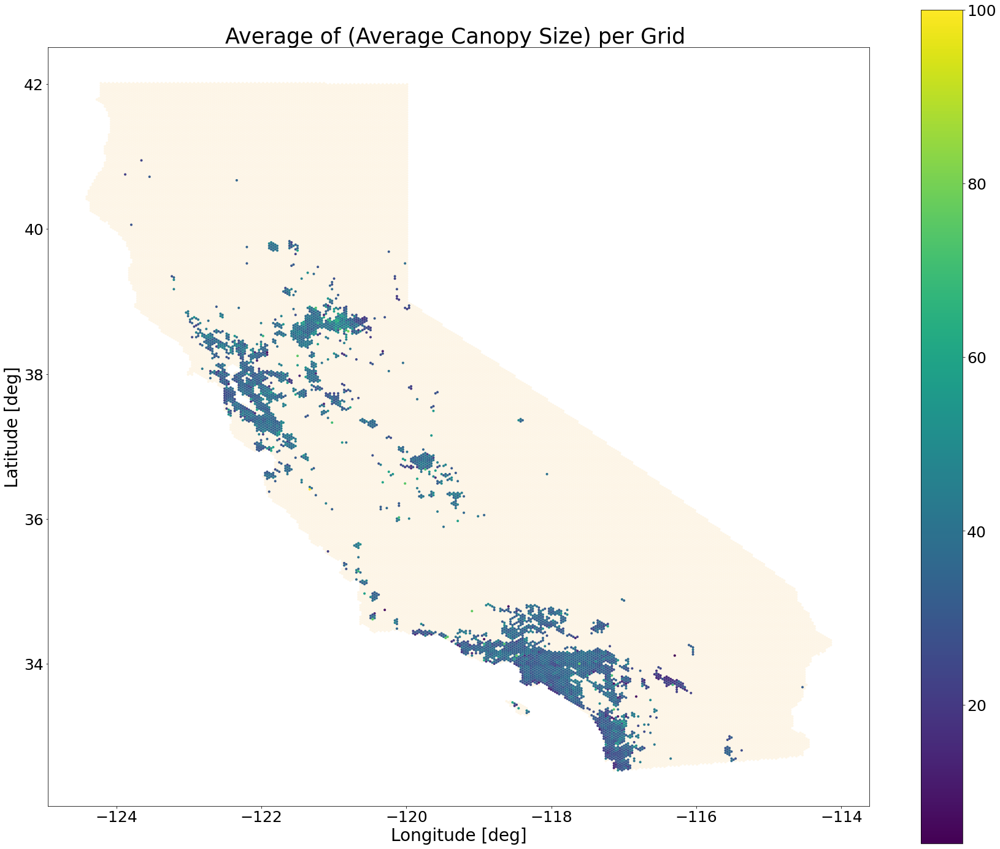

In [ ]:
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = canopy_gdf.plot(ax=ax, column=canopy_gdf['avg_avg_canopy_size'], legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Average of (Average Canopy Size) per Grid ', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
%%bigquery --project urban-forest-269703 df_10km
select * 
FROM `urban-forest-269703.treebirdagg.10km-final-stats`

In [ ]:
df_final = df_10km.merge(canopy, how='inner', 
                         left_on='ID', right_on='grid', copy=False)
df_final

,ID,geom,BirdCounts,TreeCounts,LogBirdCounts,LogTreeCounts,TreeSpeciesCounts,BirdSpeciesCounts,CountNativeTrees,PercentNativeTrees,...,cnt_dehiscent,cnt_fleshy_fruit,cnt_indehiscent,pct_dioecious,pct_monoecious,pct_perfect_flowers,avg_avg_height,avg_avg_dbh,grid,avg_avg_canopy_size
0,36023,"POLYGON ((-117.3146719996 33.6450816741199, -1...",604716.0,78.0,13.312516,4.369448,11.0,231.0,20,0.256410,...,27.0,13.0,32.0,0.125000,0.527778,0.347222,62.888889,12.881944,36023.0,33.194444
1,30915,"POLYGON ((-118.46170734586 34.2750183929345, -...",17997.0,85.0,9.798016,4.454347,34.0,124.0,6,0.070588,...,45.0,25.0,19.0,0.217949,0.346154,0.435897,40.505618,13.712472,30915.0,28.931250
2,6560,"POLYGON ((-122.40638987812 37.4893108812449, -...",911.0,56.0,6.815640,4.043051,23.0,86.0,6,0.107143,...,12.0,14.0,22.0,0.222222,0.422222,0.355556,54.687500,15.625000,6560.0,29.545455
3,30653,"POLYGON ((-118.51766028958 34.0488872631036, -...",26596.0,229.0,10.188554,5.438079,47.0,191.0,14,0.061135,...,75.0,69.0,57.0,0.257732,0.273196,0.469072,53.717949,12.711538,30653.0,36.592105
4,38019,"POLYGON ((-116.8950249217 32.7890138254744, -1...",4421.0,958.0,8.394347,6.865891,80.0,93.0,19,0.019833,...,325.0,294.0,216.0,0.222084,0.322581,0.455335,53.680934,13.003891,38019.0,35.150595
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2446,12042,"POLYGON ((-121.48316630674 37.7315942346351, -...",449.0,29.0,6.109248,3.401197,7.0,20.0,0,0.000000,...,3.0,36.0,9.0,0.500000,0.312500,0.187500,56.968085,17.678511,12042.0,36.250000
2447,13037,"POLYGON ((-121.34328394744 38.9107065544676, -...",707.0,199.0,6.562444,5.298317,6.0,57.0,42,0.211055,...,25.0,52.0,109.0,0.360215,0.381720,0.258065,63.145161,11.451613,13037.0,40.563187
2448,13789,"POLYGON ((-121.23137806 37.7800509053132, -121...",2009.0,108.0,7.605890,4.691348,8.0,57.0,3,0.027778,...,47.0,45.0,4.0,0.229167,0.041667,0.729167,60.885417,10.953125,13789.0,28.411458
2449,27181,"POLYGON ((-119.2730250298 36.2940463378531, -1...",3016.0,116.0,8.012018,4.762174,4.0,70.0,46,0.396552,...,30.0,25.0,46.0,0.247525,0.455446,0.297030,43.044554,3.257426,27181.0,37.252475


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10km-final'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
df_final.to_gbq(BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:06,  6.78s/it]


## Aggregate

In [ ]:
%%bigquery --project urban-forest-269703 tree_attribute_stats
SELECT ts.ID, d.log_dense_count, fp.Deciduous as pct_deciduous,
fp.Evergreen as pct_evergreen, fp.Partly_Deciduous as pct_partly_deciduous,
f.log_frag_count, ft.Dehiscent as cnt_dehiscent, ft.Fleshy_Fruit as cnt_fleshy_fruit,
ft.Indehiscent as cnt_indehiscent, sp.Dioecious as pct_dioecious, sp.Monoecious as pct_monoecious,
sp.Perfect_Flowers as pct_perfect_flowers, ts.avg_avg_height, ts.avg_avg_dbh
FROM `urban-forest-269703.treebirdagg.density` d,
`urban-forest-269703.treebirdagg.foliage_pct` fp,
`urban-forest-269703.treebirdagg.fragrance` f,
`urban-forest-269703.treebirdagg.fruit_type` ft,
`urban-forest-269703.treebirdagg.sex_pct` sp,
`urban-forest-269703.treebirdagg.tree_size` ts
where d.grid = fp.grid and fp.grid = f.grid 
and f.grid = ft.grid and ft.grid = sp.grid and sp.grid = ts.ID

In [ ]:
tree_attribute_stats

,ID,log_dense_count,pct_deciduous,pct_evergreen,pct_partly_deciduous,log_frag_count,cnt_dehiscent,cnt_fleshy_fruit,cnt_indehiscent,pct_dioecious,pct_monoecious,pct_perfect_flowers,avg_avg_height,avg_avg_dbh
0,18048,0.000000,1.000000,0.000000,0.000000,2.397895,50.0,10.0,40.0,0.070000,0.900000,0.030000,74.175000,5.820000
1,25582,0.000000,0.573171,0.426829,0.000000,3.663562,1.0,38.0,43.0,0.000000,0.536585,0.463415,53.536585,14.103659
2,5764,0.000000,0.846154,0.153846,0.000000,1.609438,2.0,3.0,21.0,0.076923,0.807692,0.115385,48.365385,20.538462
3,41814,0.000000,0.333333,0.666667,0.000000,1.386294,3.0,8.0,1.0,0.583333,0.166667,0.250000,31.250000,7.500000
4,31443,0.000000,0.090909,0.909091,0.000000,1.386294,3.0,5.0,3.0,0.272727,0.454545,0.272727,48.863636,14.909091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2627,8211,5.805135,0.484800,0.513600,0.001600,5.880533,96.0,269.0,257.0,0.106209,0.552288,0.341503,55.050489,15.544788
2628,8209,7.442493,0.496477,0.494555,0.008969,7.325149,599.0,1134.0,1272.0,0.236124,0.431184,0.332692,47.495035,11.613869
2629,11880,6.274762,0.791806,0.206104,0.002090,6.783325,290.0,830.0,1252.0,0.259228,0.542366,0.198406,55.614916,10.170479
2630,35784,7.494430,0.166707,0.793982,0.039311,7.142037,815.0,2082.0,1215.0,0.235987,0.237266,0.526747,62.834096,16.727444


In [ ]:
%%bigquery --project urban-forest-269703 df_10km
select * 
FROM `urban-forest-269703.treebirdagg.10km`

In [ ]:
df_10km

,ID,geom,BirdCounts,TreeCounts,LogBirdCounts,LogTreeCounts,TreeSpeciesCounts,BirdSpeciesCounts,CountNativeTrees,PercentNativeTrees,...,avg_act_evaptrans,avg_pot_evaptrans,avg_precip,avg_temp_max,avg_temp_min,avg_water_deficit,avg_beta_richness_bird,avg_beta_richness_tree,avg_beta_turnover_bird,avg_beta_turnover_tree
0,30026,"POLYGON ((-118.65754264888 34.1942572751377, -...",13380.0,71.0,9.501591,4.276666,6.0,113.0,0,0.000000,...,20.141835,111.242202,3.464954,29.009450,16.580551,91.100367,133.166667,29.166667,51.000000,36.750000
1,31847,"POLYGON ((-118.26587204284 34.6142150876808, -...",5917.0,24.0,8.685754,3.218876,2.0,91.0,0,0.000000,...,46.054587,106.000918,20.329816,25.747615,13.633578,59.946330,102.666667,2.166667,55.000000,1.000000
2,32473,"POLYGON ((-118.12598968354 34.5011495227654, -...",528.0,28.0,6.270988,3.367296,4.0,48.0,0,0.000000,...,42.758073,107.202752,18.233303,25.537431,12.575229,64.444679,68.833333,5.500000,48.500000,5.500000
3,36555,"POLYGON ((-117.20276611216 33.6450816741199, -...",920.0,42.0,6.825460,3.761200,3.0,60.0,0,0.000000,...,28.695046,110.540367,10.786239,28.791927,14.726514,81.845321,81.600000,19.600000,46.600000,29.333333
4,37240,"POLYGON ((-117.06288375286 33.6935383447979, -...",1755.0,24.0,7.470794,3.218876,2.0,70.0,0,0.000000,...,27.571835,111.181652,10.271193,29.039817,13.963394,83.609817,99.500000,3.500000,62.000000,11.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2693,7294,"POLYGON ((-122.26650751882 37.8608120231099, -...",331933.0,6892.0,12.712691,8.838262,224.0,260.0,1028,0.149158,...,72.472193,84.103508,1.230088,24.128333,13.456140,11.631316,286.666667,283.333333,105.500000,146.166667
2694,8819,"POLYGON ((-121.98674280022 36.9885919509051, -...",446194.0,5631.0,13.008511,8.636220,237.0,232.0,1622,0.288048,...,69.429626,90.031482,2.796759,25.173056,11.169907,20.610561,290.500000,249.166667,124.500000,157.500000
2695,33805,"POLYGON ((-117.81824849308 33.6450816741199, -...",1015768.0,20909.0,13.831157,9.947983,278.0,360.0,2797,0.133770,...,57.025046,109.018348,8.360183,28.563945,17.781009,51.993303,370.200000,299.000000,174.800000,202.000000
2696,6998,"POLYGON ((-122.32246046254 37.5700719990416, -...",16683.0,12197.0,9.722205,9.409027,293.0,123.0,1205,0.098795,...,7.833211,83.708257,1.572661,23.461101,13.416697,75.875046,198.166667,308.666667,89.666667,183.833333


In [ ]:
df_final = df_10km.merge(tree_attribute_stats, how='inner', 
                         left_on='ID', right_on='ID', copy=False)
df_final

,ID,geom,BirdCounts,TreeCounts,LogBirdCounts,LogTreeCounts,TreeSpeciesCounts,BirdSpeciesCounts,CountNativeTrees,PercentNativeTrees,...,pct_partly_deciduous,log_frag_count,cnt_dehiscent,cnt_fleshy_fruit,cnt_indehiscent,pct_dioecious,pct_monoecious,pct_perfect_flowers,avg_avg_height,avg_avg_dbh
0,30026,"POLYGON ((-118.65754264888 34.1942572751377, -...",13380.0,71.0,9.501591,4.276666,6.0,113.0,0,0.000000,...,0.000000,2.890372,21.0,23.0,5.0,0.020833,0.083333,0.895833,49.540816,7.591837
1,31847,"POLYGON ((-118.26587204284 34.6142150876808, -...",5917.0,24.0,8.685754,3.218876,2.0,91.0,0,0.000000,...,0.000000,3.218876,13.0,10.0,40.0,0.116667,0.566667,0.316667,47.857143,19.698413
2,32473,"POLYGON ((-118.12598968354 34.5011495227654, -...",528.0,28.0,6.270988,3.367296,4.0,48.0,0,0.000000,...,0.000000,3.526361,5.0,30.0,38.0,0.383562,0.520548,0.095890,42.397260,13.232877
3,37889,"POLYGON ((-116.92300139356 32.8697749432712, -...",5090.0,28.0,8.535230,3.367296,6.0,133.0,0,0.000000,...,0.057971,2.302585,15.0,7.0,47.0,0.318182,0.424242,0.257576,49.300000,9.120000
4,36435,"POLYGON ((-117.23074258402 34.1781050515784, -...",1271.0,111.0,7.148346,4.718499,7.0,50.0,0,0.000000,...,0.000000,0.693147,13.0,92.0,2.0,0.037383,0.934579,0.028037,54.649533,19.560748
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2446,7294,"POLYGON ((-122.26650751882 37.8608120231099, -...",331933.0,6892.0,12.712691,8.838262,224.0,260.0,1028,0.149158,...,0.008520,7.674617,1804.0,1831.0,2321.0,0.160113,0.434876,0.405011,51.496557,10.098705
2447,8819,"POLYGON ((-121.98674280022 36.9885919509051, -...",446194.0,5631.0,13.008511,8.636220,237.0,232.0,1622,0.288048,...,0.007892,7.852439,896.0,2056.0,2356.0,0.142586,0.457795,0.399620,48.971246,15.358485
2448,33805,"POLYGON ((-117.81824849308 33.6450816741199, -...",1015768.0,20909.0,13.831157,9.947983,278.0,360.0,2797,0.133770,...,0.047834,8.512783,7895.0,3692.0,8121.0,0.134566,0.462708,0.402726,50.070927,10.454853
2449,6998,"POLYGON ((-122.32246046254 37.5700719990416, -...",16683.0,12197.0,9.722205,9.409027,293.0,123.0,1205,0.098795,...,0.003342,8.454253,3322.0,3363.0,4336.0,0.138260,0.436869,0.424870,58.626999,13.723055


In [ ]:
df_final.columns

Index(['ID', 'geom', 'BirdCounts', 'TreeCounts', 'LogBirdCounts',
       'LogTreeCounts', 'TreeSpeciesCounts', 'BirdSpeciesCounts',
       'CountNativeTrees', 'PercentNativeTrees', 'CountNativeTreeSpecies',
       'ShannonTree', 'ShannonBird', 'EvenTrees', 'EvenBirds', 'LoveTrees',
       'LoveBirds', 'Population', 'percent10', 'percent20',
       'avg_act_evaptrans', 'avg_pot_evaptrans', 'avg_precip', 'avg_temp_max',
       'avg_temp_min', 'avg_water_deficit', 'avg_beta_richness_bird',
       'avg_beta_richness_tree', 'avg_beta_turnover_bird',
       'avg_beta_turnover_tree', 'log_dense_count', 'pct_deciduous',
       'pct_evergreen', 'pct_partly_deciduous', 'log_frag_count',
       'cnt_dehiscent', 'cnt_fleshy_fruit', 'cnt_indehiscent', 'pct_dioecious',
       'pct_monoecious', 'pct_perfect_flowers', 'avg_avg_height',
       'avg_avg_dbh'],
      dtype='object')

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.10km-final-stats'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project
# set chunk size of records to be inserted
df_final.to_gbq(BqDatasetwithtable, BqProject, chunksize=100000, if_exists='append')

1it [00:05,  5.31s/it]


# Spatial Regression

In [ ]:
%%bigquery --project urban-forest-269703 df_10km
select * except(BirdCounts, TreeCounts, LogBirdCounts, BirdSpeciesCounts, 
                PercentNativeTrees, EvenBirds, LoveTrees, LoveBirds, 
                avg_beta_richness_tree, avg_beta_richness_bird, 
                avg_beta_turnover_bird, avg_beta_turnover_tree)
FROM `urban-forest-269703.treebirdagg.10km-stats`

In [ ]:
np.where(df_10km['nativeTree'] > 0, ((np.exp(df_10km['LogTreeCounts']) - 1) / df_10km['nativeTree']), 0).max()

11549.99999999999

In [ ]:
df_10km['LogTreeCounts'].min(), df_10km['LogTreeCounts'].mean(), df_10km['LogTreeCounts'].max()

(3.04452243772342, 7.037956910172341, 10.1154488144478)

In [ ]:
df_10km['RatioNativeRegion'].min(), df_10km['RatioNativeRegion'].mean(), df_10km['RatioNativeRegion'].max()

(0.03752131893121107, 3215.8141831428516, 11551.0)

In [ ]:
# df_10km['PercentNativeTrees'] = df_10km['CountNativeTrees'] / np.exp(df_10km['LogTreeCounts'])
# df_10km['RatioNativeTrees'] = np.where(df_10km['CountNativeTrees'] > 0, 
#                                       (np.exp(df_10km['LogTreeCounts']) / df_10km['CountNativeTrees']), 1153) 
# df_10km['PercentNativeTreeSpecies'] = df_10km['CountNativeTreeSpecies'] / df_10km['TreeSpeciesCounts']
# df_10km['PercentNativeRegion'] = df_10km['nativeTree'] / np.exp(df_10km['LogTreeCounts'])
df_10km['RatioNativeRegion'] = np.where(df_10km['nativeTree'] > 0, 
                                        ((np.exp(df_10km['LogTreeCounts']) - 1) / df_10km['nativeTree']), 11550)
# df_10km['PercentNativeRegionSpecies'] = df_10km['nativeSpecies'] / df_10km['TreeSpeciesCounts']
df_10km['LogPopulation'] = np.log(df_10km['Population'] + 1)
df_10km['pct_fleshy_fruit'] = df_10km['cnt_fleshy_fruit'] / (
      df_10km['cnt_fleshy_fruit'] + df_10km['cnt_dehiscent'] + df_10km['cnt_indehiscent']
)
df_10km['pct_dehiscent'] = df_10km['cnt_dehiscent'] / (
      df_10km['cnt_fleshy_fruit'] + df_10km['cnt_dehiscent'] + df_10km['cnt_indehiscent']
)
df_10km['pct_indehiscent'] = df_10km['cnt_indehiscent'] / (
      df_10km['cnt_fleshy_fruit'] + df_10km['cnt_dehiscent'] + df_10km['cnt_indehiscent']
)
df_10km['geometry'] = df_10km['geom'].apply(wkt.loads)

y = df_10km['ShannonBird']
y_sqr = y**2
X = df_10km.drop(['ID', 'geom', 'ShannonBird', 'geometry', 'pct_deciduous', 
                  'avg_act_evaptrans', 'avg_pot_evaptrans', 'pct_perfect_flowers', 
                  'CountNativeTrees', 'CountNativeTreeSpecies',
                  'nativeTree', 'cnt_fleshy_fruit', 'cnt_dehiscent', 
                  'cnt_indehiscent', 'pct_indehiscent', 'Population',
                  #'nativeSpecies', 'PercentNativeTreeSpecies',  
                  ], axis=1)
X_norm=(X-X.mean())/X.std()

X_geo = pd.concat([X_norm, df_10km['geometry']], axis=1)
X_gdf = gpd.GeoDataFrame(X_geo, geometry='geometry')
X_gdf

,LogTreeCounts,TreeSpeciesCounts,ShannonTree,EvenTrees,percent10,percent20,avg_precip,avg_temp_max,avg_temp_min,avg_water_deficit,...,avg_avg_dbh,avg_avg_canopy_size,nativeSpecies,pct_fragrance,pct_dense,RatioNativeRegion,LogPopulation,pct_fleshy_fruit,pct_dehiscent,geometry
0,1.002488,1.658358,0.946802,-0.475722,-0.651472,0.783170,-1.036839,-1.397780,-0.884149,-1.154698,...,0.012792,0.605592,3.982415,0.160056,-0.522051,-0.645469,0.279179,-0.773650,-0.593962,"POLYGON ((-122.18258 37.42470, -122.19190 37.4..."
1,1.438888,2.714229,0.727048,-0.127091,-0.651472,-0.686623,-1.087991,-1.432777,-0.848220,-0.671919,...,0.069911,0.972740,4.482692,0.356168,-0.217097,-0.644485,0.589468,-0.470568,-0.242157,"POLYGON ((-122.15460 37.44085, -122.16393 37.4..."
2,1.010853,2.442262,0.903219,0.387563,-0.651472,-0.686623,-0.877142,-1.378059,-1.530191,-1.457191,...,0.807040,-0.708507,4.482692,0.918029,0.506897,-0.644857,0.477805,0.322344,-0.605066,"POLYGON ((-121.98674 36.98859, -121.99607 37.0..."
3,0.790475,2.026313,0.346496,0.624934,-1.509483,-0.686623,-1.125657,-1.781764,-0.806990,-0.830479,...,-0.465351,0.186894,4.482692,0.579769,0.543108,-0.643727,1.210354,-0.250550,0.067440,"POLYGON ((-122.23853 37.87696, -122.24786 37.8..."
4,1.392539,2.890207,0.662225,0.480754,-1.509483,-0.686623,-0.907097,-1.559763,-1.591595,-1.519592,...,0.412305,-0.642926,3.982415,1.079183,0.719542,-0.644498,0.831162,0.430411,-0.417592,"POLYGON ((-122.01472 36.97244, -122.02404 36.9..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2446,1.044529,1.514376,-0.060824,-1.537099,-0.651472,0.783170,-0.395620,-3.266745,-1.346867,-0.933012,...,0.234951,0.910256,1.981308,-0.561795,-0.402123,-0.645447,0.243311,-1.243341,-0.520090,"POLYGON ((-121.87484 36.60094, -121.88416 36.6..."
2447,0.957697,0.490502,0.610549,-0.712155,0.206539,-0.686623,0.069007,0.159049,-0.971243,-0.080628,...,-1.215410,1.200194,1.981308,0.349081,-0.172843,-0.644114,0.360452,-0.140018,-1.146756,"POLYGON ((-121.28733 38.78149, -121.29666 38.7..."
2448,0.464470,1.434386,0.603252,0.949434,-1.509483,-0.686623,-0.947334,-1.703456,-1.614485,-0.761788,...,0.649767,-0.648023,1.981308,1.729605,1.432037,-0.642872,-0.051871,-0.024550,0.178130,"POLYGON ((-122.04270 36.95629, -122.05202 36.9..."
2449,1.108766,1.386392,0.409864,-1.709921,0.206539,0.783170,-0.976255,-1.588070,-0.835364,0.122364,...,2.045548,1.952296,2.481585,0.319968,0.277440,-0.645622,0.348078,-0.282128,-0.566064,"POLYGON ((-122.23853 37.45701, -122.24786 37.4..."


In [ ]:
y.min(), y.max(), y_sqr.min(), y_sqr.max()

(0.137406006452769, 4.67713554609155, 0.018880410609298393, 21.875596916513096)

In [ ]:
X.std()

LogTreeCounts              1.581103
TreeSpeciesCounts         62.507684
ShannonTree                0.536833
EvenTrees                  0.088347
percent10                  1.165486
percent20                  0.680368
avg_precip                 6.446785
avg_temp_max               1.854555
avg_temp_min               2.439787
avg_water_deficit         26.293764
pct_evergreen              0.220447
pct_partly_deciduous       0.043152
pct_dioecious              0.119634
pct_monoecious             0.187949
avg_avg_height             6.744011
avg_avg_dbh                3.572139
avg_avg_canopy_size        5.729228
nativeSpecies              1.998894
pct_fragrance              0.148127
pct_dense                  0.143276
RatioNativeRegion       4977.581833
LogPopulation              1.591834
pct_fleshy_fruit           0.155686
pct_dehiscent              0.159750
dtype: float64

In [ ]:
X_norm.columns

Index(['LogTreeCounts', 'TreeSpeciesCounts', 'ShannonTree', 'EvenTrees',
       'percent10', 'percent20', 'avg_precip', 'avg_temp_max', 'avg_temp_min',
       'avg_water_deficit', 'pct_evergreen', 'pct_partly_deciduous',
       'pct_dioecious', 'pct_monoecious', 'avg_avg_height', 'avg_avg_dbh',
       'avg_avg_canopy_size', 'nativeSpecies', 'pct_fragrance', 'pct_dense',
       'RatioNativeTrees', 'RatioNativeRegion', 'LogPopulation',
       'pct_fleshy_fruit', 'pct_dehiscent'],
      dtype='object')

In [ ]:
import itertools

df = X_norm.corr()
correlations = {}
columns = df.columns.tolist()

for col_a, col_b in itertools.combinations(columns, 2):
    correlations[col_a + '__' + col_b] = df.loc[col_a, col_b]

result = pd.DataFrame.from_dict(correlations, orient='index')
result.columns = ['PCC']
result['corr_mag'] = np.abs(result['PCC'])

result.sort_values('corr_mag', ascending=False).iloc[:20]

,PCC,corr_mag
LogTreeCounts__TreeSpeciesCounts,0.827607,0.827607
avg_temp_min__avg_water_deficit,0.617854,0.617854
pct_monoecious__pct_fleshy_fruit,-0.608751,0.608751
TreeSpeciesCounts__LogPopulation,0.604298,0.604298
LogTreeCounts__LogPopulation,0.588650,0.588650
TreeSpeciesCounts__percent10,-0.577927,0.577927
avg_temp_min__pct_dehiscent,0.564015,0.564015
avg_temp_max__avg_temp_min,0.559194,0.559194
avg_temp_min__pct_evergreen,0.552949,0.552949
avg_temp_min__pct_partly_deciduous,0.531342,0.531342


## Simple Linear Regression

In [ ]:
from pysal.model import spreg

# Fit OLS model
m1 = spreg.OLS(
    # Dependent variable
    y.values, 
    # Independent variables
    X_norm.values,
    # Dependent variable name
    name_y='ShannonBird', 
    # Independent variable name
    name_x=list(X_norm.columns)
)

print(m1.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  : ShannonBird                Number of Observations:        2451
Mean dependent var  :      3.0465                Number of Variables   :          25
S.D. dependent var  :      0.7610                Degrees of Freedom    :        2426
R-squared           :      0.9424
Adjusted R-squared  :      0.9419
Sum squared residual:      81.654                F-statistic           :   1655.1641
Sigma-square        :       0.034                Prob(F-statistic)     :           0
S.E. of regression  :       0.183                Log likelihood        :     691.043
Sigma-square ML     :       0.033                Akaike info criterion :   -1332.086
S.E of regression ML:      0.1825                Schwarz criterion     :   -1186.980

-----------------------------------------------------------------------------

In [ ]:
X_cen['centroid'][0].distance(X_cen['centroid'][2434]), X_cen['centroid'][0].distance(X_cen['centroid'][2432])

(0.03230444711865488, 0.05595294371995684)

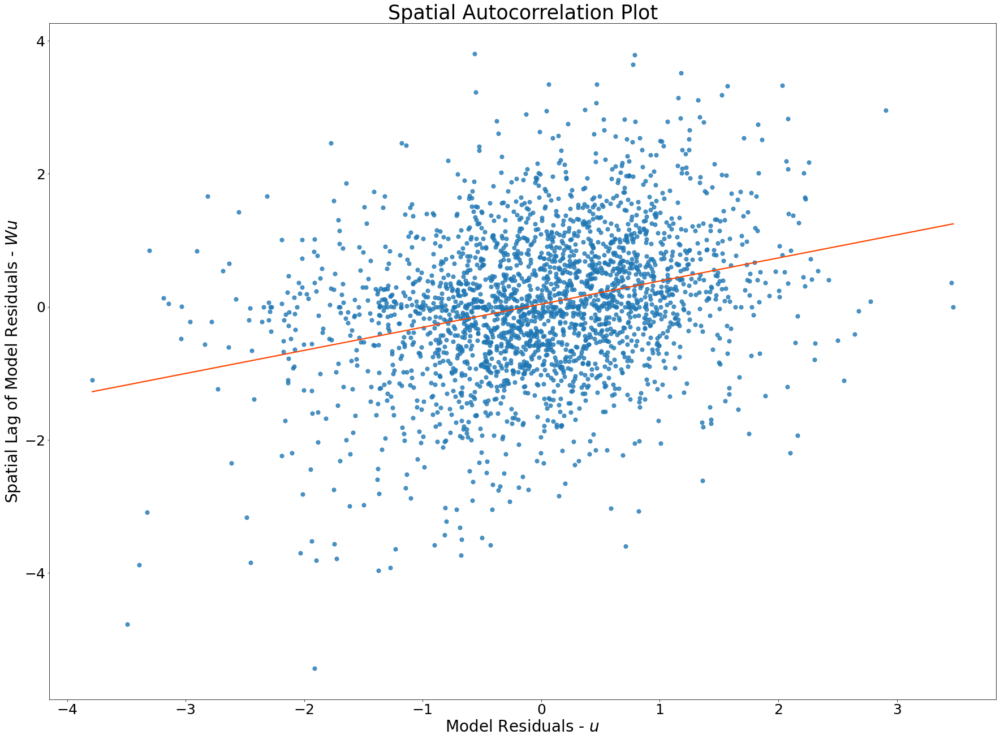

In [ ]:
X_gdf['centroid'] = X_gdf['geometry'].apply(lambda x: x.centroid)
X_cen = gpd.GeoDataFrame(X_gdf, geometry='centroid')

knn = weights.distance.Kernel.from_dataframe(X_cen[['centroid']], bandwidth=.06)
knn_diag = weights.insert_diagonal(knn, np.zeros(knn.n))

lag_residual = weights.spatial_lag.lag_spatial(knn_diag, m1.u)

fig,ax = plt.subplots(figsize=(30,22))
sns.regplot(
    m1.u.flatten(), 
    lag_residual.flatten(), 
    line_kws=dict(color='orangered'),
    ci=None, scatter_kws={'s':50}
)
ax.set_xlabel('Model Residuals - $u$', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Spatial Lag of Model Residuals - $W u$', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Spatial Autocorrelation Plot', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

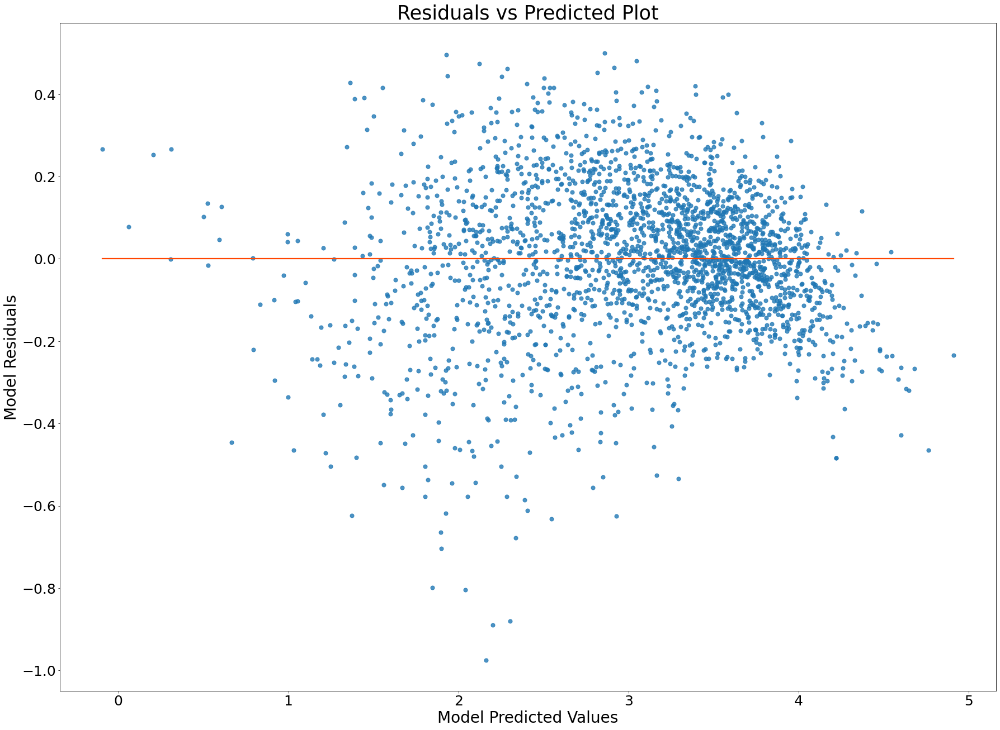

In [ ]:
lin_preds =  m1.predy
X_gdf['resids'] = m1.u

fig,ax = plt.subplots(figsize=(30,22))
sns.regplot(
    lin_preds,
    m1.u.flatten(), 
    line_kws=dict(color='orangered'),
    ci=None, scatter_kws={'s':50}
)
ax.set_xlabel('Model Predicted Values', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Model Residuals', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Residuals vs Predicted Plot', 
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

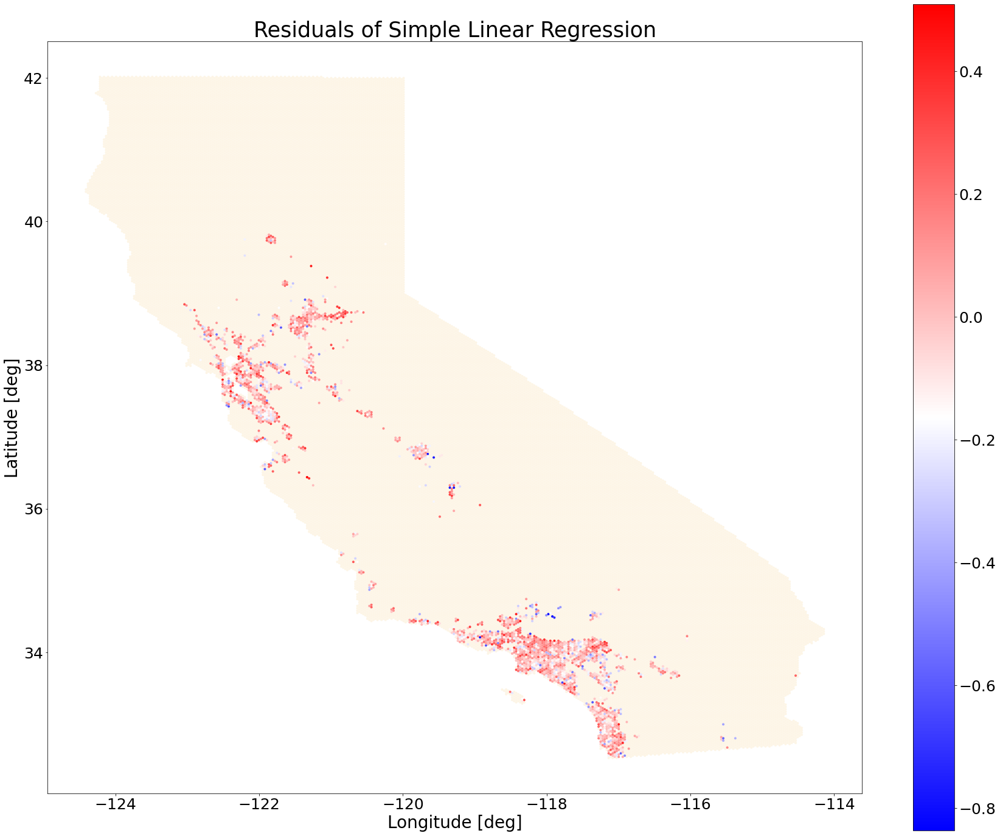

In [ ]:
X_gdf['resids'] = m1.u
fig, ax = plt.subplots(figsize=(30,25))
ca_gdf.plot(ax=ax, color='oldlace') 
ax2 = X_gdf.plot(ax=ax, column=X_gdf['resids'], cmap='bwr', legend=True)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Residuals of Simple Linear Regression', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show()

In [ ]:
# Fit OLS model with Moran's test
m1 = spreg.OLS(
    # Dependent variable
    y_sqr.values, 
    # Independent variables
    X_norm.values,
    # Dependent variable name
    name_y='ShannonBird', 
    # Independent variable name
    name_x=list(X_norm.columns),
    spat_diag=True,
    w=knn_diag,
    moran=True
)

print(m1.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  : ShannonBird                Number of Observations:        2451
Mean dependent var  :      9.8597                Number of Variables   :          25
S.D. dependent var  :      4.2085                Degrees of Freedom    :        2426
R-squared           :      0.9513
Adjusted R-squared  :      0.9508
Sum squared residual:    2115.377                F-statistic           :   1972.4342
Sigma-square        :       0.872                Prob(F-statistic)     :           0
S.E. of regression  :       0.934                Log likelihood        :   -3297.347
Sigma-square ML     :       0.863                Akaike info criterion :    6644.695
S.E of regression ML:      0.9290                Schwarz criterion     :    6789.801

-----------------------------------------------------------------------------

## Spatial Regression

In [ ]:
# Fit spatial lag model with `spreg` 
# (GMM estimation)
m2 = spreg.GM_Lag(    
    # Dependent variable
    y_sqr.values, 
    # Independent variables
    X_norm.values,
    # Spatial weights matrix
    w=knn_diag, 
    # Dependent variable name
    name_y='ShannonBird', 
    # Independent variable name
    name_x=list(X_norm.columns)
)

print(m2.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIAL TWO STAGE LEAST SQUARES
--------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  : ShannonBird                Number of Observations:        2451
Mean dependent var  :      9.8597                Number of Variables   :          26
S.D. dependent var  :      4.2085                Degrees of Freedom    :        2425
Pseudo R-squared    :      0.9519
Spatial Pseudo R-squared:  0.9515

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       9.5593631       0.0912861     104.7186918       0.0000000
       LogTreeCounts       1.1881044       0.0442771      26.8334010       0.0000000
   TreeSpeciesCounts       1.7642799       0.0444313      3

In [ ]:
lag = pd.DataFrame(
    {
        # Pull out regression coefficients and
        # flatten as they are returned as Nx1 array
        'Coeff.': m2.betas.flatten(),
        # Pull out and flatten standard errors
        'Std. Error': m2.std_err.flatten(),
        # Pull out P-values from t-stat object
        'P-Value': [i[1] for i in m2.z_stat]
    },
    index=m2.name_x + ['W_ShannonBird']
# Subset for lambda parameter and round to
# four decimals
).reindex(m2.name_x + ['W_ShannonBird']).round(4)
lag

,Coeff.,Std. Error,P-Value
CONSTANT,9.5594,0.0913,0.0000
LogTreeCounts,1.1881,0.0443,0.0000
TreeSpeciesCounts,1.7643,0.0444,0.0000
ShannonTree,0.0596,0.0199,0.0027
EvenTrees,1.3857,0.0244,0.0000
percent10,-0.7257,0.0240,0.0000
percent20,-0.6486,0.0262,0.0000
avg_precip,-0.0830,0.0203,0.0000
avg_temp_max,-0.0558,0.0269,0.0381
avg_temp_min,-0.1102,0.0425,0.0095


In [ ]:
# Fit spatial error model with `spreg` 
# (GMM estimation allowing for heteroskedasticity)
m3 = spreg.GM_Error_Het(    
    # Dependent variable
    y_sqr.values, 
    # Independent variables
    X_norm.values,
    # Spatial weights matrix
    w=knn_diag, 
    # Dependent variable name
    name_y='ShannonBird', 
    # Independent variable name
    name_x=list(X_norm.columns)
)

print(m3.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED LEAST SQUARES (HET)
---------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  : ShannonBird                Number of Observations:        2451
Mean dependent var  :      9.8597                Number of Variables   :          25
S.D. dependent var  :      4.2085                Degrees of Freedom    :        2426
Pseudo R-squared    :      0.9508
N. of iterations    :           1                Step1c computed       :          No

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       9.8423675       0.0285750     344.4396275       0.0000000
       LogTreeCounts       1.3112184       0.0602723      21.7549082       0.00

In [ ]:
# Build full table of regression coefficients
error = pd.DataFrame(
    {
        # Pull out regression coefficients and
        # flatten as they are returned as Nx1 array
        'Coeff.': m3.betas.flatten(),
        # Pull out and flatten standard errors
        'Std. Error': m3.std_err.flatten(),
        # Pull out P-values from t-stat object
        'P-Value': [i[1] for i in m3.z_stat]
    },
    index=m3.name_x
# Round to four decimals
).round(4)
error

,Coeff.,Std. Error,P-Value
CONSTANT,9.8424,0.0286,0.0000
LogTreeCounts,1.3112,0.0603,0.0000
TreeSpeciesCounts,1.7844,0.0608,0.0000
ShannonTree,0.0580,0.0196,0.0031
EvenTrees,1.3819,0.0386,0.0000
percent10,-0.7013,0.0243,0.0000
percent20,-0.6256,0.0312,0.0000
avg_precip,-0.0925,0.0278,0.0009
avg_temp_max,-0.1050,0.0400,0.0086
avg_temp_min,-0.0415,0.0538,0.4398


In [ ]:
# Fit spatial error model with `spreg` 
# (GMM estimation allowing for heteroskedasticity)
m4 = spreg.GM_Combo_Het(    
    # Dependent variable
    y_sqr.values, 
    # Independent variables
    X_norm.values,
    # Spatial weights matrix
    w=knn_diag, 
    # Dependent variable name
    name_y='ShannonBird', 
    # Independent variable name
    name_x=list(X_norm.columns)
)

print(m4.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES (HET)
-------------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  : ShannonBird                Number of Observations:        2451
Mean dependent var  :      9.8597                Number of Variables   :          26
S.D. dependent var  :      4.2085                Degrees of Freedom    :        2425
Pseudo R-squared    :      0.9517
Spatial Pseudo R-squared:  0.9513
N. of iterations    :           1                Step1c computed       :          No

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       9.6337037       0.1006367      95.7275163       0.0000000
       LogTreeCounts     

In [ ]:
combo = pd.DataFrame(
    {
        # Pull out regression coefficients and
        # flatten as they are returned as Nx1 array
        'Coeff.': m4.betas.flatten(),
        # Pull out and flatten standard errors
        'Std. Error': m4.std_err.flatten(),
        # Pull out P-values from t-stat object
        'P-Value': [i[1] for i in m4.z_stat]
    },
    index=m4.name_x + ['W_ShannonBird', 'lambda']
# Round to four decimals
).round(4)
combo

,Coeff.,Std. Error,P-Value
CONSTANT,9.6337,0.1006,0.0000
LogTreeCounts,1.2704,0.0611,0.0000
TreeSpeciesCounts,1.7641,0.0610,0.0000
ShannonTree,0.0522,0.0196,0.0079
EvenTrees,1.3687,0.0390,0.0000
percent10,-0.6953,0.0243,0.0000
percent20,-0.6219,0.0310,0.0000
avg_precip,-0.0824,0.0277,0.0030
avg_temp_max,-0.0910,0.0395,0.0211
avg_temp_min,-0.0851,0.0570,0.1357


In [ ]:
lag['sig'] = np.where(lag['P-Value'] < 0.05, 1, 0)
error['sig'] = np.where(error['P-Value'] < 0.05, 1, 0)
combo['sig'] = np.where(combo['P-Value'] < 0.05, 1, 0)
lag['sig10'] = np.where(lag['P-Value'] < 0.1, 1, 0)
error['sig10'] = np.where(error['P-Value'] < 0.1, 1, 0)
combo['sig10'] = np.where(combo['P-Value'] < 0.1, 1, 0)
lag['dir'] = np.where(lag['Coeff.'] < 0, -1, 1)
error['dir'] = np.where(error['Coeff.'] < 0, -1, 1)
combo['dir'] = np.where(combo['Coeff.'] < 0, -1, 1)
lag['mag'] = np.abs(lag['Coeff.'])
error['mag'] = np.abs(error['Coeff.'])
combo['mag'] = np.abs(combo['Coeff.'])

# Variables that the models agree on in terms of significance (.05)
lag.iloc[:-1,:]['sig'] & error.iloc[:-1,:]['sig'] & combo.iloc[:-2,:]['sig']

CONSTANT                 True
EvenTrees                True
LogPopulation            True
LogTreeCounts            True
PercentNativeRegion     False
RatioNativeRegion       False
ShannonTree              True
TreeSpeciesCounts        True
avg_avg_canopy_size      True
avg_avg_dbh              True
avg_avg_height          False
avg_precip               True
avg_temp_max             True
avg_temp_min            False
avg_water_deficit       False
nativeSpecies            True
pct_dehiscent           False
pct_dense               False
pct_dioecious           False
pct_evergreen           False
pct_fleshy_fruit         True
pct_fragrance           False
pct_monoecious           True
pct_partly_deciduous    False
percent10                True
percent20                True
Name: sig, dtype: bool

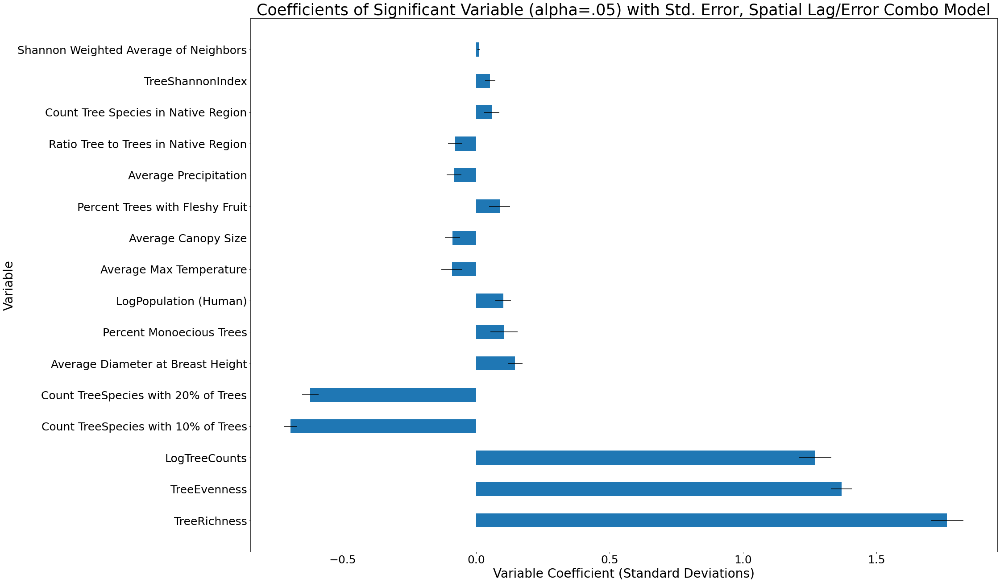

In [ ]:
combo_df1 = combo[combo['sig10'] & True].sort_values('mag', ascending=False).reset_index()
combo_df1 = combo_df1[~combo_df1['index'].isin(['CONSTANT', 'lambda'])][['index', 'Coeff.', 'Std. Error']]
var_map = {'EvenTrees': 'TreeEvenness', 
           'TreeSpeciesCounts': 'TreeRichness',
           'percent20': 'Count TreeSpecies with 20% of Trees',
           'percent10': 'Count TreeSpecies with 10% of Trees',
           'avg_avg_dbh': 'Average Diameter at Breast Height',
           'pct_fleshy_fruit': 'Percent Trees with Fleshy Fruit',
           'avg_temp_max': 'Average Max Temperature',
           'pct_evergreen': 'Percent of Trees that are Evergreen',
           'pct_monoecious': 'Percent Monoecious Trees',
           'LogPopulation': 'LogPopulation (Human)',
           'ShannonTree': 'TreeShannonIndex',
           'avg_precip': 'Average Precipitation',
           'avg_avg_canopy_size': 'Average Canopy Size',
           'RatioNativeRegion': 'Ratio Tree to Trees in Native Region',
           'RatioNativeTrees': 'Ratio Tree to Native Tree',
           'nativeSpecies': 'Count Tree Species in Native Region',
           'W_ShannonBird': 'Shannon Weighted Average of Neighbors'}
combo_df1['var'] = combo_df1['index'].apply(lambda x: var_map[x] if x in var_map else x)
u = combo_df1['var'].unique()
height = 2
padding = 0.5
y_locs = np.arange(len(combo_df1)) * (height * 2 + padding)


fig, ax = plt.subplots(figsize=(30,22))
ax.barh(y_locs, height=height, width=combo_df1['Coeff.'].values, 
        xerr=combo_df1['Std. Error'].values)
ax.set_xlabel('Variable Coefficient (Standard Deviations)', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Variable', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Coefficients of Significant Variable (alpha=.05) with Std. Error, Spatial Lag/Error Combo Model', 
        fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

plt.yticks(y_locs, u)
fig.show()

In [ ]:
error_df = error[lag['sig10'] & error['sig10'] & combo['sig10']].sort_values('mag', ascending=False).reset_index()
error_df = error_df[~error_df['index'].isin(['lambda', 'CONSTANT'])][['index', 'Coeff.', 'Std. Error']]
error_df['model'] = 'error'
error_df = error_df.set_index('index')

lag_df = lag[lag['sig10'] & error['sig10'] & combo['sig10']].sort_values('mag', ascending=False).reset_index()
lag_df = lag_df[~lag_df['index'].isin(['CONSTANT', 'W_ShannonBird'])][['index', 'Coeff.', 'Std. Error']]
lag_df['model'] = 'lag'
lag_df = lag_df.set_index('index')
lag_df = lag_df.loc[error_df.index, :]

combo_df = combo[lag['sig10'] & error['sig10'] & combo['sig10']].sort_values('mag', ascending=False).reset_index()
combo_df = combo_df[~combo_df['index'].isin(['CONSTANT', 'W_ShannonBird', 'lambda'])][['index', 'Coeff.', 'Std. Error']]
combo_df['model'] = 'combo'
combo_df = combo_df.set_index('index')
combo_df = combo_df.loc[error_df.index, :]

coeff_df = pd.concat([lag_df, error_df, combo_df], axis=0)
coeff_df = coeff_df.reset_index()

var_map = {'EvenTrees': 'TreeEvenness', 
           'TreeSpeciesCounts': 'TreeRichness',
           'percent20': 'Count TreeSpecies with 20% of Trees',
           'percent10': 'Count TreeSpecies with 10% of Trees',
           'avg_avg_dbh': 'Average Diameter at Breast Height',
           'pct_fleshy_fruit': 'Percent Trees with Fleshy Fruit',
           'avg_temp_min': 'Average Min Temperature',
           'pct_evergreen': 'Percent of Trees that are Evergreen',
           'pct_monoecious': 'Percent Monoecious Trees',
           'LogPopulation': 'LogPopulation (Human)',
           'ShannonTree': 'TreeShannonIndex',
           'avg_precip': 'Average Precipitation',
           'avg_avg_canopy_size': 'Average Canopy Size',
           'RatioNativeRegion': 'Ratio Tree to Trees in Native Region',
           'RatioNativeTrees': 'Ratio Tree to Native Tree',
           'nativeSpecies': 'Count Tree Species in Native Region'}
coeff_df['var'] = coeff_df['index'].apply(lambda x: var_map[x] if x in var_map else x)
coeff_df

,index,Coeff.,Std. Error,model,var
0,TreeSpeciesCounts,1.7832,0.0445,lag,TreeRichness
1,EvenTrees,1.3756,0.0245,lag,TreeEvenness
2,LogTreeCounts,1.1619,0.0448,lag,LogTreeCounts
3,percent10,-0.7202,0.0240,lag,Count TreeSpecies with 10% of Trees
4,percent20,-0.6444,0.0261,lag,Count TreeSpecies with 20% of Trees
5,avg_avg_dbh,0.1575,0.0232,lag,Average Diameter at Breast Height
6,LogPopulation,0.0931,0.0263,lag,LogPopulation (Human)
7,pct_monoecious,0.1010,0.0449,lag,Percent Monoecious Trees
8,avg_temp_max,-0.0607,0.0269,lag,avg_temp_max
9,pct_fleshy_fruit,0.0935,0.0365,lag,Percent Trees with Fleshy Fruit


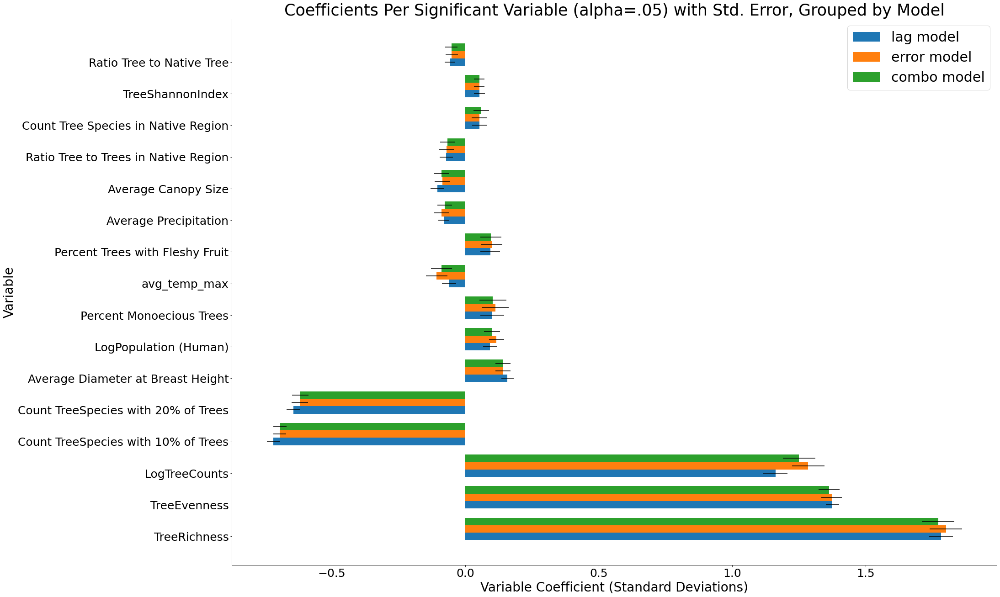

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

def grouped_barplot(df, cat, subcat, val, err):
    lag = coeff_df[coeff_df['model']=='lag']
    error = coeff_df[coeff_df['model']=='error']
    combo = coeff_df[coeff_df['model']=='combo']
    u = df[cat].unique()
    height = 2
    padding = 0.5
    y_locs = np.arange(len(lag)) * (height * 4 + padding)

    fig, ax = plt.subplots(figsize=(30,22))
    ax.barh(y_locs, height=height, width=lag[val].values, 
                label="{} {}".format('lag', subcat), xerr=lag[err].values)
    ax.barh(y_locs + height, height=height, width=error[val].values, 
                label="{} {}".format('error', subcat), xerr=error[err].values)
    ax.barh(y_locs + 2 * height, height=height, width=combo[val].values, 
                label="{} {}".format('combo', subcat), xerr=combo[err].values)
      
    ax.set_xlabel('Variable Coefficient (Standard Deviations)', fontdict={'fontsize': 28, 'fontweight': 'medium'})
    ax.set_ylabel('Variable', fontdict={'fontsize': 28, 'fontweight': 'medium'})
    ax.set_title('Coefficients Per Significant Variable (alpha=.05) with Std. Error, Grouped by Model', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
    plt.xticks(fontsize=25)
    plt.yticks(fontsize=25)

    plt.yticks(y_locs, u)
    plt.legend(prop={'size': 30})
    plt.show()

# call the function with df from the question
grouped_barplot(coeff_df, 'var', 'model', 'Coeff.', 'Std. Error' )

In [ ]:
error_df = error[lag['sig'] & error['sig'] & combo['sig']].sort_values('mag', ascending=False).reset_index()
error_df = error_df[~error_df['index'].isin(['lambda', 'CONSTANT'])][['index', 'Coeff.', 'Std. Error']]
error_df['model'] = 'error'
error_df = error_df.set_index('index')

lag_df = lag[lag['sig'] & error['sig'] & combo['sig']].sort_values('mag', ascending=False).reset_index()
lag_df = lag_df[~lag_df['index'].isin(['CONSTANT', 'W_ShannonBird'])][['index', 'Coeff.', 'Std. Error']]
lag_df['model'] = 'lag'
lag_df = lag_df.set_index('index')
lag_df = lag_df.loc[error_df.index, :]

combo_df = combo[lag['sig'] & error['sig'] & combo['sig']].sort_values('mag', ascending=False).reset_index()
combo_df = combo_df[~combo_df['index'].isin(['CONSTANT', 'W_ShannonBird', 'lambda'])][['index', 'Coeff.', 'Std. Error']]
combo_df['model'] = 'combo'
combo_df = combo_df.set_index('index')
combo_df = combo_df.loc[error_df.index, :]

coeff_df = pd.concat([lag_df, error_df, combo_df], axis=0)
coeff_df = coeff_df.reset_index()

var_map = {'EvenTrees': 'TreeEvenness', 
           'TreeSpeciesCounts': 'TreeRichness',
           'percent20': 'Count TreeSpecies with 20% of Trees',
           'percent10': 'Count TreeSpecies with 10% of Trees',
           'avg_avg_dbh': 'Average Diameter at Breast Height',
           'pct_fleshy_fruit': 'Percent Trees with Fleshy Fruit',
           'avg_temp_max': 'Average Max Temperature',
           'pct_monoecious': 'Percent Monoecious Trees',
           'LogPopulation': 'LogPopulation (Human)',
           'ShannonTree': 'TreeShannonIndex',
           'avg_precip': 'Average Precipitation',
           'avg_avg_canopy_size': 'Average Canopy Size',
           'RatioNativeRegion': 'Ratio Non-native Tree to Trees in Native Region',
           'RatioNativeTrees': 'Ratio Non-native Tree to Native Tree'}
coeff_df['var'] = coeff_df['index'].apply(lambda x: var_map[x] if x in var_map else x)
coeff_df

,index,Coeff.,Std. Error,model,var
0,TreeSpeciesCounts,1.7832,0.0445,lag,TreeRichness
1,EvenTrees,1.3756,0.0245,lag,TreeEvenness
2,LogTreeCounts,1.1619,0.0448,lag,LogTreeCounts
3,percent10,-0.7202,0.0240,lag,Count TreeSpecies with 10% of Trees
4,percent20,-0.6444,0.0261,lag,Count TreeSpecies with 20% of Trees
5,avg_avg_dbh,0.1575,0.0232,lag,Average Diameter at Breast Height
6,LogPopulation,0.0931,0.0263,lag,LogPopulation (Human)
7,pct_monoecious,0.1010,0.0449,lag,Percent Monoecious Trees
8,avg_temp_max,-0.0607,0.0269,lag,Average Max Temperature
9,pct_fleshy_fruit,0.0935,0.0365,lag,Percent Trees with Fleshy Fruit


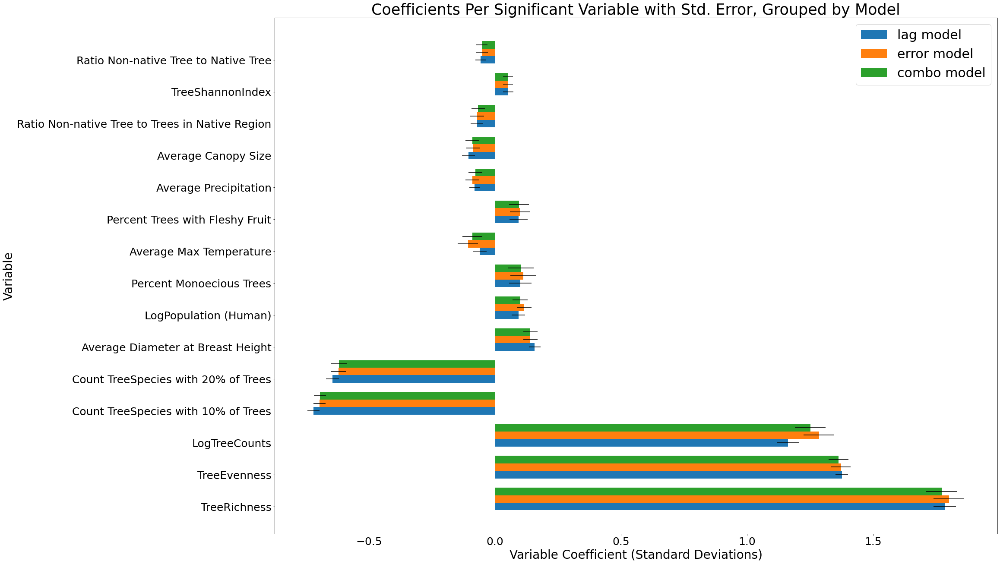

In [ ]:
def grouped_barplot(df, cat, subcat, val, err):
    lag = coeff_df[coeff_df['model']=='lag']
    error = coeff_df[coeff_df['model']=='error']
    combo = coeff_df[coeff_df['model']=='combo']
    u = df[cat].unique()
    height = 2
    padding = 0.5
    y_locs = np.arange(len(lag)) * (height * 4 + padding)

    fig, ax = plt.subplots(figsize=(30,22))
    ax.barh(y_locs, height=height, width=lag[val].values, 
                label="{} {}".format('lag', subcat), xerr=lag[err].values)
    ax.barh(y_locs + height, height=height, width=error[val].values, 
                label="{} {}".format('error', subcat), xerr=error[err].values)
    ax.barh(y_locs + 2 * height, height=height, width=combo[val].values, 
                label="{} {}".format('combo', subcat), xerr=combo[err].values)
      
    ax.set_xlabel('Variable Coefficient (Standard Deviations)', fontdict={'fontsize': 28, 'fontweight': 'medium'})
    ax.set_ylabel('Variable', fontdict={'fontsize': 28, 'fontweight': 'medium'})
    ax.set_title('Coefficients Per Significant Variable with Std. Error, Grouped by Model', 
            fontdict={'fontsize': 35, 'fontweight': 'medium'})
    plt.xticks(fontsize=25)
    plt.yticks(fontsize=25)

    plt.yticks(y_locs, u)
    plt.legend(prop={'size': 30})
    plt.show()

# call the function with df from the question
grouped_barplot(coeff_df, 'var', 'model', 'Coeff.', 'Std. Error' )